In [1]:
import gc
import os
import random
import time
import math

import cv2
import numpy as np
import matplotlib.pyplot as plt

# model
import torch
import torchvision
import torch.nn as nn
import timm
from torchvision.models.feature_extraction import create_feature_extractor
import torchvision.transforms.functional as TF

# data loader
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import DataLoader, Dataset

# training
from torch.optim import SGD, Adam, AdamW
from torch.optim.lr_scheduler import CosineAnnealingLR, CosineAnnealingWarmRestarts, ReduceLROnPlateau, ExponentialLR

# metric
from sklearn.metrics import fbeta_score, roc_auc_score

import wandb

# config

In [2]:
import yaml
OUTPUT_DIR = "/working/output" 
EXP_NAME = "exp072"
with open(os.path.join(OUTPUT_DIR, EXP_NAME, "Config.yaml")) as file:
    CFG = yaml.safe_load(file)
print(CFG)
CFG["OUTPUT_DIR"] = os.path.join(OUTPUT_DIR, EXP_NAME)

{'EXP_CATEGORY': 'GRID-S', 'INPUT_DIR': '/working/input/vesuvius-challenge-ink-detection', 'RANDOM_SLIDE': True, 'TRAIN_DIR': '/working/input/vesuvius-challenge-ink-detection/train', 'TRAIN_DIR_LIST': [['1', '2_0', '2_1', '2_2'], ['1', '2_0', '2_1', '3'], ['1', '2_0', '2_2', '3'], ['1', '2_1', '2_2', '3'], ['2_0', '2_1', '2_2', '3']], 'T_max': 5, 'VALID_DIR_LIST': [['3'], ['2_2'], ['2_1'], ['2_0'], ['1']], 'base_lr': 0.0001, 'batch_size': 8, 'folds': [0, 1, 2, 3, 4], 'img_size': [256, 256], 'input_img_size': [512, 512], 'inp_channels': 4, 'lr': 0.001, 'max_lr': 0.0005, 'min_lr': 1e-08, 'model_name': 'tf_efficientnet_b6', 'channel_nums': [576, 200, 72, 40, 32], 'n_epoch': 15, 'num_workers': 2, 'out_channels': 1, 'out_indices': [0, 1, 2, 3, 4], 'pretrained': True, 'print_freq': 1000, 'random_seed': 21, 'slide_pos_list': [[0, 0], [128, 0], [0, 128], [128, 128]], 'step_size_down': 10, 'step_size_up': 5, 'SURFACE_LIST': [[26, 29, 32, 35], [27, 30, 33, 36], [25, 28, 31, 34]], 'surface_num': 

# utils

In [3]:
def seed_everything(seed=CFG["random_seed"]):
    #os.environ['PYTHONSEED'] = str(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic =True
    torch.backends.cudnn.benchmark = False
seed_everything()

# device optimization
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')
print(f'Using device: {device}')

Using device: cuda


In [4]:
def asMinutes(s):
    """Convert Seconds to Minutes."""
    m = math.floor(s / 60)
    s -= m * 60
    return '%dm %ds' % (m, s)

def timeSince(since, percent):
    """Accessing and Converting Time Data."""
    now = time.time()
    s = now - since
    es = s / (percent)
    rs = es - s
    return '%s (remain %s)' % (asMinutes(s), asMinutes(rs))

class AverageMeter(object):
    """Computes and stores the average and current value."""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

# metric

In [5]:
def fbeta_numpy(targets, preds, beta=0.5, smooth=1e-5):
    y_true_count = targets.sum()
    ctp = preds[targets==1].sum()
    cfp = preds[targets==0].sum()
    beta_squared = beta * beta

    c_precision = ctp / (ctp + cfp + smooth)
    c_recall = ctp / (y_true_count + smooth)
    dice = (1 + beta_squared) * (c_precision * c_recall) / (beta_squared * c_precision + c_recall + smooth)

    return dice

def calc_fbeta_auc(mask, mask_pred):
    mask = mask.astype(int).flatten()
    mask_pred = mask_pred.flatten()

    best_th = 0
    best_dice = 0
    dice_list = [] 
    # for th in np.array(range(10, 50+1, 5)) / 100:
    for th in np.array(range(10, 100+1, 5)) / 100:
        # dice = fbeta_score(mask, (mask_pred >= th).astype(int), beta=0.5)
        dice = fbeta_numpy(mask, (mask_pred >= th).astype(int), beta=0.5)
        dice_list.append(dice)
        # print(f'\t th: {th}, fbeta: {dice}')
        if dice > best_dice:
            best_dice = dice
            best_th = th
    
    auc = roc_auc_score(mask, mask_pred)
    # Logger.info(f'best_th: {best_th}, fbeta: {best_dice}')
    return best_dice, best_th, auc, dice_list


def calc_cv(mask_gt, mask_pred):
    best_dice, best_th, auc, dice_list = calc_fbeta_auc(mask_gt, mask_pred)

    return best_dice, best_th, auc, dice_list

# model

In [6]:
class Encoder(nn.Module):
    def __init__(self, CFG):
        super().__init__()
        self.encoder = timm.create_model(CFG["model_name"], in_chans=CFG["inp_channels"], 
                                         features_only=True, out_indices=CFG["out_indices"], pretrained=CFG["pretrained"])
    def forward(self, img):
        skip_connection_list = self.encoder(img)
        return skip_connection_list

class UpConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        self.bn1 = nn.BatchNorm2d(in_channels)
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size = 2, padding="same")
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        x = self.up(x)
        x = self.bn1(x)
        x = self.conv(x)
        x = self.bn2(x)
        return x


#下に1層を使わない
class Decoder(nn.Module):
    def __init__(self, CFG):
        super().__init__()
        self.UpConv_0 = UpConv(CFG["channel_nums"][0], CFG["channel_nums"][1])
        self.UpConv_1 = UpConv(CFG["channel_nums"][1]*2, CFG["channel_nums"][2])
        self.UpConv_2 = UpConv(CFG["channel_nums"][2]*2, CFG["channel_nums"][3])
        self.UpConv_3 = UpConv(CFG["channel_nums"][3]*2, CFG["channel_nums"][4])
    
    def forward(self, skip_connection_list):
        emb = self.UpConv_0(skip_connection_list[-1])
        emb_cat = torch.cat([skip_connection_list[-2], emb], dim = 1)
        
        emb = self.UpConv_1(emb_cat)
        emb_cat = torch.cat([skip_connection_list[-3], emb], dim = 1)
        
        emb = self.UpConv_2(emb_cat)
        emb_cat = torch.cat([skip_connection_list[-4], emb], dim = 1)
        
        emb = self.UpConv_3(emb_cat)
        emb_cat = torch.cat([skip_connection_list[-5], emb], dim = 1)
        
        return emb_cat

class SegModel(nn.Module):
    def __init__(self, CFG):
        super().__init__()
        self.encoder = Encoder(CFG)
        self.decoder = Decoder(CFG)
        self.head = nn.Sequential(
            nn.Conv2d(CFG["channel_nums"][-1]*2, CFG["out_channels"], kernel_size=1, stride=1, padding=0),
            # nn.BatchNorm2d(CFG["out_channels"]),
            # nn.Sigmoid()
        )
    def forward(self, img):
        skip_connection_list = self.encoder(img)
        emb = self.decoder(skip_connection_list)
        output = self.head(emb)
        return output



# Dataset

In [7]:
train_transforms = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.RandomCrop(int(CFG["img_size"][0]*0.8), int(CFG["img_size"][1]*0.8), p=0.5),
    A.Blur(blur_limit=3, p=0.3),
    A.Resize(CFG["img_size"][0], CFG["img_size"][1]),
    ToTensorV2(),
])

valid_transforms = A.Compose([
    ToTensorV2(),
])

In [8]:
class VCID_Dataset(Dataset):
    def __init__(self, CFG, data_dir_list, surface_list, surface_volumes=None, slide_pos=[0,0], mode="train", transform=None):
        # get config
        self.mode = mode
        self.RANDOM_SLIDE = CFG["RANDOM_SLIDE"]
        self.img_size = CFG["img_size"]
        if self.mode=="train":  self.DATADIR = CFG["TRAIN_DIR"]
        elif self.mode=="valid":    self.DATADIR = CFG["TRAIN_DIR"]
        elif self.mode == "test":   self.DATADIR = CFG["TEST_DIR"]
        self.data_dir_list = data_dir_list
        self.surface_list = surface_list
        self.slide_pos = slide_pos
        self.transform = transform
        # self.cleha = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        # get imgs
        # print("initializing dataset...")
        self.imgs = []
        for data_dir in self.data_dir_list:
            img_path = os.path.join(self.DATADIR, data_dir, "mask.png")
            # print(img_path)
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            img = img.reshape(img.shape[0], img.shape[1], 1) # (h, w, channel=1)
            assert img is not None, "img is None. data path is wrong"
            self.imgs.append(img)  
        
        # get and split surface
        if surface_volumes is None:
            self.surface_vols = self.read_surfacevols()
        else:
            # print("using loaded surface_vols")
            self.surface_vols = surface_volumes
       
        # split grid
        self.get_all_grid()
        self.fileter_grid()
        self.get_flatten_grid()
        # print("split grid done.") 
       
        # get label imgs
        if self.mode == "train" or self.mode == "valid":
            self.labels = []
            for data_dir in self.data_dir_list:
                label_path = os.path.join(self.DATADIR, data_dir, "inklabels.png")
                assert os.path.exists(label_path), f"{label_path} is not exist."
                # read label
                label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
                label = label.reshape(label.shape[0], label.shape[1], 1) # (h, w, channel=1)
                self.labels.append(label)# 画像サイズがそれぞれ違うので単純にconcatできずlist化しているs
        # print("initializing dataset done.")

    def get_surface_volumes(self):
        return self.surface_vols

    def read_surfacevols(self):
        """ read surface volume by data_dir_list and surface_list 
            Returns:surface_vuls (list): surface volume list [array(h,w,channel=surface_num), array(), ...]
        """
        surface_vols = []
        # print("reading surface volume...")
        for data_dir in self.data_dir_list:
            surface_vol_ = None
            for read_idx, surface_idx in enumerate(self.surface_list):
                # print("\r", f"reading idx : {read_idx+1}/{len(self.surface_list)}", end="")
                surface_path = os.path.join(self.DATADIR, data_dir, "surface_volume", f"{surface_idx:02}.tif")
                surface_vol = cv2.imread(surface_path, cv2.IMREAD_GRAYSCALE)
                # surface_vol = self.cleha.apply(surface_vol)
                surface_vol = surface_vol.reshape(surface_vol.shape[0], surface_vol.shape[1], 1) # (h, w, channel=1)
                if surface_vol_ is None:
                    surface_vol_ = surface_vol
                else:
                    surface_vol_ = np.concatenate([surface_vol_, surface_vol], axis=2) # (h, w, channel=surface_num)
            surface_vols.append(surface_vol_)
            # print(f"  => read surface volume done. [{data_dir}]")
        return surface_vols


    def get_grid_img(self, img, grid_idx):
        """ crop grid img from original img"""
        img_grid = img[(grid_idx[0]*self.img_size[0]) + self.slide_pos[0] : ((grid_idx[0]+1)*self.img_size[0]) + self.slide_pos[0],
                        (grid_idx[1]*self.img_size[1]) + self.slide_pos[1] : ((grid_idx[1]+1)*self.img_size[1]) + self.slide_pos[1]]
        return img_grid
    
    def get_grid_img_and_mask(self, img, mask, grid_idx):
        """ crop grid img from original img"""
        if self.RANDOM_SLIDE and self.mode=="train" and random.random() < 0.5:
            if (grid_idx[0]!=0 and grid_idx[1]!=0) and (grid_idx[0]!=img.shape[0]//self.img_size[0] and grid_idx[1]!=img.shape[1]//self.img_size[1]):
                rand_pos = [np.random.randint(0, self.img_size[0]//4) - self.img_size[0]//4, np.random.randint(0, self.img_size[1]//4)-self.img_size[1]//4]
            else:
                rand_pos = [0, 0]
        else:
            rand_pos = [0, 0]
        self.rand_pos = rand_pos
        img_grid = img[(grid_idx[0]*self.img_size[0]) + self.slide_pos[0] + rand_pos[0] : ((grid_idx[0]+1)*self.img_size[0]) + self.slide_pos[0] + rand_pos[0],
                        (grid_idx[1]*self.img_size[1]) + self.slide_pos[1] + rand_pos[1] : ((grid_idx[1]+1)*self.img_size[1]) + self.slide_pos[1] + rand_pos[1]]
        mask_grid = mask[(grid_idx[0]*self.img_size[0]) + self.slide_pos[0] + rand_pos[0] : ((grid_idx[0]+1)*self.img_size[0]) + self.slide_pos[0] + rand_pos[0],
                         (grid_idx[1]*self.img_size[1]) + self.slide_pos[1] + rand_pos[1] : ((grid_idx[1]+1)*self.img_size[1]) + self.slide_pos[1] + rand_pos[1]]
        return img_grid/255., mask_grid/255.
    
    def get_masked_img(self, img, mask):
        """ multiply mask to surface_volumes """
        masked_img = None
        for channel in range(img.shape[2]):
            img_channel = img[:,:,channel].reshape(img.shape[0], img.shape[1],1)
            masked = img_channel*mask
            if masked_img is None:
                masked_img = masked.reshape(masked.shape[0], masked.shape[1], 1)
            else:
                masked = masked.reshape(masked.shape[0], masked.shape[1], 1)
                masked_img = np.concatenate([masked_img, masked], axis=2)
        return masked_img
    
    
    def get_all_grid(self):
        """ get all grid indices by img size and grid size
        """
        self.grid_indices = []
        for img in self.imgs:
            self.x_grid_size = (img.shape[0] - self.slide_pos[0]) // self.img_size[0]
            self.y_grid_size = (img.shape[1] - self.slide_pos[1]) // self.img_size[1]
            grid_img = []
            for i in range(self.x_grid_size):
                for j in range(self.y_grid_size):
                    grid_img.append([i, j])
            self.grid_indices.append(grid_img)
        return self.grid_indices
          
    def fileter_grid(self):
        """ get grid indices which mask is not 0 by all grid indices"""
        grid_indices_all = []
        for img, grid_indices in zip(self.imgs, self.grid_indices):
            grid_indices_copy = grid_indices.copy()
            for grid_idx in grid_indices:
                img_grid = self.get_grid_img(img, grid_idx)
                if img_grid.sum() == 0:
                    grid_indices_copy.remove(grid_idx)
            grid_indices_all.append(grid_indices_copy)
        self.grid_indices = grid_indices_all
        return self.grid_indices

    def get_flatten_grid(self):
        """ get flatten index list by grid indices
            Returns:flatten_grid (list): flatten index list [[img_idx, grid_idx], [img_idx, grid_idx], ...]
        """
        flatten_grid = []
        for img_idx, grid_indices in enumerate(self.grid_indices):
            for grid_idx in grid_indices:
                grid_imgidx_list = [img_idx]
                grid_imgidx_list.extend(grid_idx)
                flatten_grid.append(grid_imgidx_list)
        self.flatten_grid = flatten_grid
        return self.flatten_grid
    
    def channel_shuffle(self, img):
        img = img.transpose(2, 0, 1)
        np.random.shuffle(img)
        return img.transpose(1, 2, 0)

    def __len__(self):
        return len(self.flatten_grid)

    def __getitem__(self, idx):
        # get indices
        img_grid_idx = self.flatten_grid[idx]
        img_idx = img_grid_idx[0]
        grid_idx = img_grid_idx[1:]
        # get img & surface_vol
        mask = self.imgs[img_idx]
        surface_vol = self.surface_vols[img_idx]
        # mask = self.get_grid_img(mask, grid_idx)/255.
        # surface_vol = self.get_grid_img(surface_vol, grid_idx)/255.
        mask, surface_vol = self.get_grid_img_and_mask(mask, surface_vol, grid_idx)
        # multiple small mask 
        assert surface_vol.shape[0]==mask.shape[0] and surface_vol.shape[1]==mask.shape[1] , "surface_vol_list shape is not same as img shape"
        img = surface_vol
        # transform
        if self.mode == "test":
            if self.transform:
                img = self.transform(image=img)["image"]
            else:
                img = img.transpose(2, 0, 1)
                img = torch.tensor(img, dtype=torch.float32)
            return img, grid_idx
        elif self.mode == "train" or self.mode=="valid":
            # get label(segmentation mask)
            label = self.labels[img_idx]
            label = self.get_grid_img(label, grid_idx)
            # if self.mode == "train":
            #     img = self.channel_shuffle(img)
            if self.transform:
                transformed = self.transform(image=img, mask=label)
                img = transformed["image"]
                label = transformed["mask"]
                label = label.permute(2, 0, 1)/255. # (channel, h, w)
                # label = TF.resize(img=label, size=(self.img_size[0]//2, self.img_size[1]//2))
            else:
                img = img.transpose(2, 0, 1) # (channel, h, w)
                label = label.transpose(2, 0, 1)/255. # (channel, h, w){}
                img = torch.tensor(img, dtype=torch.float32)
                label = torch.tensor(label, dtype=torch.float32)
                # label = TF.resize(img=label, size=(self.img_size[0]//2, self.img_size[1]//2))
            assert img is not None and label is not None, f"img or label is None {img} {label}, {img_idx}, {grid_idx}, {self.rand_pos}"
            return img, label, grid_idx

# train valid fn

In [9]:
def train_fn(train_loader, model, criterion, epoch ,optimizer, scheduler):
    model.train()
    batch_time = AverageMeter()
    losses = AverageMeter()
    start = end = time.time()
    for batch_idx, (images, targets, _) in enumerate(train_loader):
        images = images.to(device, non_blocking = True).float()
        targets = targets.to(device, non_blocking = True).float()     
        preds = model(images)
        
        # preds = torch.sigmoid(preds)
        loss = criterion(preds, targets)
        
        losses.update(loss.item(), CFG["batch_size"]) 
        targets = targets.detach().cpu().numpy().ravel().tolist()
        preds = preds.detach().cpu().numpy().ravel().tolist()
        loss.backward() # パラメータの勾配を計算
        optimizer.step() # モデル更新
        optimizer.zero_grad() # 勾配の初期化
                
        batch_time.update(time.time() - end)
        end = time.time()
        if batch_idx % CFG["print_freq"] == 0 or batch_idx == (len(train_loader)-1):
            print('Epoch: [{0}][{1}/{2}] '
                    'Elapsed {remain:s} '
                    'Loss: {loss.val:.4f}({loss.avg:.4f}) '
                    .format(
                        epoch, batch_idx, len(train_loader), batch_time=batch_time, loss=losses,
                        remain=timeSince(start, float(batch_idx+1)/len(train_loader)),
            ))
        del preds, images, targets
    gc.collect()
    torch.cuda.empty_cache()
    return losses.avg

In [10]:
def valid_fn(model, valid_loader, criterion=None):
    model.eval()# モデルを検証モードに設定
    test_targets = []
    test_preds = []
    test_grid_idx = []
    batch_time = AverageMeter()
    losses = AverageMeter()
    start = end = time.time()
    for batch_idx, (images, targets, grid_idx) in enumerate(valid_loader):
        images = images.to(device, non_blocking = True).float()
        targets = targets.to(device, non_blocking = True).float()
        with torch.no_grad():
            preds = model(images)
            preds = TF.resize(img=preds, size=(CFG["input_img_size"][0], CFG["input_img_size"][1]))
            if not criterion is None:
                loss = criterion(preds, targets)
        if not criterion is None:
            losses.update(loss.item(), CFG["batch_size"])
        batch_time.update(time.time() - end)

        preds = torch.sigmoid(preds)
        targets = targets.detach().cpu().numpy()
        preds = preds.detach().cpu().numpy()
        
        test_preds.extend([preds[idx, :,:,:].transpose(1,2,0) for idx in range(preds.shape[0])])
        test_targets.extend([targets[idx, :,:,:].transpose(1,2,0) for idx in range(targets.shape[0])])
        test_grid_idx.extend([[x_idx, y_idx] for x_idx, y_idx in zip(grid_idx[0].tolist(), grid_idx[1].tolist())])

        if (batch_idx % CFG["print_freq"] == 0 or batch_idx == (len(valid_loader)-1)) and (not criterion is None):
            print('EVAL: [{0}/{1}] '
                'Elapsed {remain:s} '
                'Loss: {loss.val:.4f}({loss.avg:.4f}) '
                .format(
                    batch_idx, len(valid_loader), batch_time=batch_time, loss=losses,
                    remain=timeSince(start, float(batch_idx+1)/len(valid_loader)),
                ))
        del preds, images, targets
        gc.collect()
        torch.cuda.empty_cache()
    if criterion is None:
        return test_targets, test_preds, test_grid_idx
    else:
        return test_targets, test_preds, test_grid_idx, losses.avg

# training loop

In [11]:
def concat_grid_img(img_list, label_list, grid_idx_list, valid_dir_list, slide_pos=[0,0], tta="default"):
    # concat pred img and label to original size
    img_path = os.path.join(CFG["TRAIN_DIR"], valid_dir_list[0], "mask.png")
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = img.reshape(img.shape[0], img.shape[1], 1)
    pred_img = np.zeros_like(img).astype(np.float32)
    label_img = np.zeros_like(img).astype(np.float32)
    for img_idx, grid_idx in enumerate(grid_idx_list):
        img_ = img_list[img_idx]
        label_ = label_list[img_idx]
        img_ = cv2.resize(img_, dsize=(CFG["img_size"][0], CFG["img_size"][1]))
        label_ = cv2.resize(label_, (CFG["img_size"][0], CFG["img_size"][1]))
        img_ = img_[:, :, np.newaxis]
        label_ = label_[:, :, np.newaxis]
        if tta=="default":
            pred_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += img_
            label_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += label_
        elif tta=="vflip":
            pred_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += np.flipud(img_)
            label_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += np.flipud(label_)
        elif tta=="hflip":
            pred_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += np.fliplr(img_)
            label_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += np.fliplr(label_)
        else:
            pred_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += img_
            label_img[grid_idx[0]*CFG["img_size"][0]+slide_pos[0] : (grid_idx[0]+1)*CFG["img_size"][0]+slide_pos[0],
                    grid_idx[1]*CFG["img_size"][1]+slide_pos[1] : (grid_idx[1]+1)*CFG["img_size"][1]+slide_pos[1], :] += label_
        
    return pred_img, label_img



In [12]:
def save_and_plot_oof(mode, fold, slice_idx, slide_idx, tta, valid_preds_img, valid_targets_img, valid_preds_binary):
    cv2.imwrite(os.path.join(CFG["OUTPUT_DIR"], "imgs_each", f"fold{fold}_{mode}_slice{slice_idx}_slide{slide_idx}_{tta}_valid_pred_img.png"), valid_preds_img*255)
    cv2.imwrite(os.path.join(CFG["OUTPUT_DIR"], "imgs_each", f"fold{fold}_{mode}_slice{slice_idx}_slide{slide_idx}_{tta}_valid_predbin_img.png"), valid_preds_binary*255)
    cv2.imwrite(os.path.join(CFG["OUTPUT_DIR"], "imgs_each", f"fold{fold}_{mode}_slice{slice_idx}_slide{slide_idx}_{tta}_valid_targets_img.png"), valid_targets_img*255)
                

# slice inference

In [13]:
def get_tta_aug(aug_type):
    if aug_type=="default":
        return A.Compose([
            A.Resize(CFG["input_img_size"][0], CFG["input_img_size"][1], p=1.0),
            ToTensorV2(),
            ])
    elif aug_type=="hflip":
        return A.Compose([
            A.HorizontalFlip(p=1.0),
            A.Resize(CFG["input_img_size"][0], CFG["input_img_size"][1], p=1.0), 
            ToTensorV2(),
        ])
    elif aug_type=="vflip":
        return A.Compose([
            A.VerticalFlip(p=1.0),
            A.Resize(CFG["input_img_size"][0], CFG["input_img_size"][1], p=1.0),
            ToTensorV2(),
        ])
    else:
        return A.Compose([
            A.Resize(CFG["input_img_size"][0], CFG["input_img_size"][1], p=1.0),
            ToTensorV2(),
            ])
        

In [16]:
def slide_inference(CFG, tta_list):
    start_time = time.time()
    slice_ave_score_list, slice_ave_auc_list, slice_ave_score_threshold_list = [], [], []
    for fold in CFG["folds"]:
        print(f"-- fold{fold} slide inference start --")
 
        # set model & learning fn
        model = SegModel(CFG)
        model_path = os.path.join(CFG["OUTPUT_DIR"], f'{CFG["model_name"]}_auc_fold{fold}.pth')
        # model_path = os.path.join(CFG["OUTPUT_DIR"], f'{CFG["model_name"]}_fold{fold}.pth')
        model.load_state_dict(torch.load(model_path))
        model = model.to(device)
        valid_img_slice = None
        for slice_idx, surface_list in enumerate(CFG["SURFACE_LIST"]):
            print("surface_list: ", surface_list)
            surface_volumes = None
            for slide_idx, slide_pos in enumerate(CFG["slide_pos_list"]):
                print("slide pos:", slide_pos)
                valid_dirs = CFG["VALID_DIR_LIST"][fold]
                for tta in tta_list:
                    print(f"tta:{tta}")
                    valid_transforms = get_tta_aug(tta)
                    valid_dataset = VCID_Dataset(CFG, valid_dirs, surface_list, surface_volumes, slide_pos,
                                                 mode="valid", transform=valid_transforms)
                    surface_volumes = valid_dataset.get_surface_volumes()
                    valid_loader = DataLoader(valid_dataset, batch_size=CFG["batch_size"], shuffle = False,
                                                num_workers = CFG["num_workers"], pin_memory = True)

                    valid_targets, valid_preds, valid_grid_idx = valid_fn(model, valid_loader)

                    # target, predをconcatして元のサイズに戻す
                    valid_preds_img, valid_targets_img  = concat_grid_img(valid_preds, valid_targets, valid_grid_idx, valid_dirs, slide_pos, tta)
                    valid_score, valid_threshold, auc, dice_list = calc_cv(valid_targets_img, valid_preds_img)
                    valid_preds_binary = (valid_preds_img > valid_threshold).astype(np.uint8)
                    save_and_plot_oof("slide_tta", fold, slice_idx, slide_idx , tta, valid_preds_img, valid_targets_img, valid_preds_binary) 

                    elapsed = time.time() - start_time
                    print(f"\t score:{valid_score:.4f}(th={valid_threshold:3f}), auc={auc:4f}::: time:{elapsed:.2f}s")
                    if valid_img_slice is None:
                        valid_img_slice = valid_preds_img
                    else:
                        valid_img_slice += valid_preds_img

        valid_img_slice /= (len(CFG["SURFACE_LIST"])*len(CFG["slide_pos_list"])*len(tta_list))
        valid_sliceave_score, valid_sliceave_threshold, ave_auc, dice_list = calc_cv(valid_targets_img, valid_img_slice)
        
        slice_ave_score_list.append(valid_sliceave_score)
        slice_ave_auc_list.append(ave_auc)
        slice_ave_score_threshold_list.append(valid_sliceave_threshold)

        valid_slice_binary = (valid_img_slice > valid_sliceave_threshold).astype(np.uint8)
        # save_and_plot_oof("average_tta", fold, 555, valid_img_slice, valid_targets_img, valid_slice_binary)
        print(f'[fold{fold}] slice ave score:{valid_sliceave_score:.4f}(th={valid_sliceave_threshold:3f}), auc={ave_auc:4f}')
         
        del model, valid_loader, valid_dataset, valid_preds_img, valid_targets_img, valid_preds_binary
        gc.collect()
        torch.cuda.empty_cache()
    return slice_ave_score_list, slice_ave_auc_list, slice_ave_score_threshold_list


# main

---
# OOF SCORE INFER

In [27]:
%%time
tta_list = ["default", "hflip", "vflip"]
slice_ave_score_list, slice_ave_auc_list, slice_ave_score_threshold_list = slide_inference(CFG, tta_list)
for fold in CFG["folds"]:
    print(f"fold[{fold}] slice ave score:{slice_ave_score_list[fold]:.4f}(th={slice_ave_score_threshold_list[fold]:3f}), auc={slice_ave_auc_list[fold]:4f}")

-- fold0 slide inference start --
surface_list:  [26, 29, 32, 35]
slide pos: [0, 0]
tta:default
	 score:0.5917(th=0.250000), auc=0.907765::: time:38.26s
tta:hflip
	 score:0.5626(th=0.550000), auc=0.901282::: time:63.04s
tta:vflip
	 score:0.5411(th=0.550000), auc=0.904552::: time:87.94s
slide pos: [128, 0]
tta:default
	 score:0.5986(th=0.250000), auc=0.910383::: time:113.28s
tta:hflip
	 score:0.5637(th=0.550000), auc=0.905415::: time:138.47s
tta:vflip
	 score:0.5436(th=0.550000), auc=0.908672::: time:163.66s
slide pos: [0, 128]
tta:default
	 score:0.5766(th=0.250000), auc=0.904301::: time:188.51s
tta:hflip
	 score:0.5448(th=0.500000), auc=0.904445::: time:213.59s
tta:vflip
	 score:0.5444(th=0.550000), auc=0.903288::: time:239.16s
slide pos: [128, 128]
tta:default
	 score:0.5811(th=0.250000), auc=0.908901::: time:264.60s
tta:hflip
	 score:0.5473(th=0.550000), auc=0.907886::: time:289.63s
tta:vflip
	 score:0.5414(th=0.550000), auc=0.906176::: time:315.21s
surface_list:  [27, 30, 33, 36]
s

# SCORING 1 TTA

fold =  0


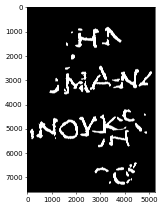

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


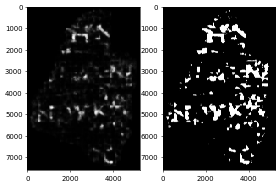

thr=0.100, precision=0.504, recall=0.579
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


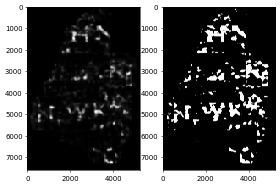

thr=0.100, precision=0.497, recall=0.575
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


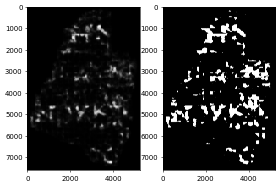

thr=0.100, precision=0.479, recall=0.582
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


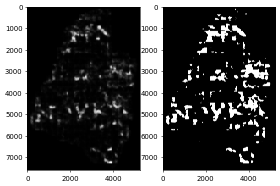

thr=0.100, precision=0.473, recall=0.579
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


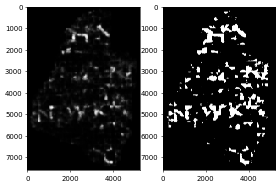

thr=0.100, precision=0.485, recall=0.569
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


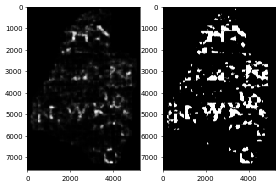

thr=0.100, precision=0.489, recall=0.568
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


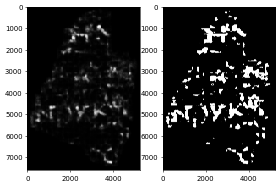

thr=0.100, precision=0.475, recall=0.585
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


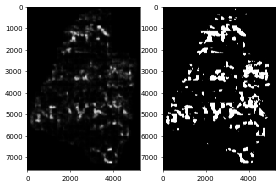

thr=0.100, precision=0.472, recall=0.581
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


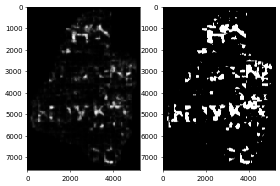

thr=0.100, precision=0.512, recall=0.570
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


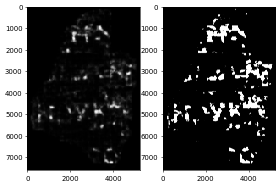

thr=0.100, precision=0.515, recall=0.562
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


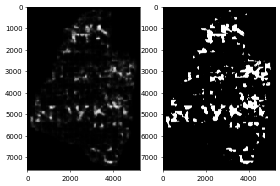

thr=0.100, precision=0.498, recall=0.554
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


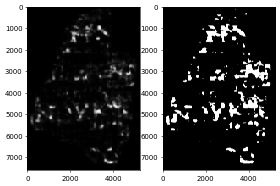

thr=0.100, precision=0.487, recall=0.548


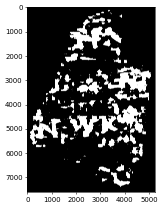

thr=0.100, fbate=0.498, precision=0.353, recall=0.751
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


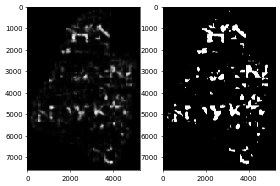

thr=0.150, precision=0.596, recall=0.470
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


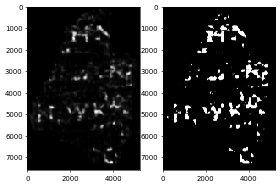

thr=0.150, precision=0.609, recall=0.462
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


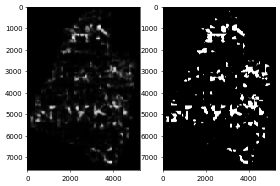

thr=0.150, precision=0.572, recall=0.473
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


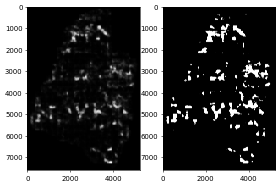

thr=0.150, precision=0.577, recall=0.469
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


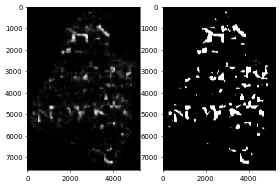

thr=0.150, precision=0.582, recall=0.453
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


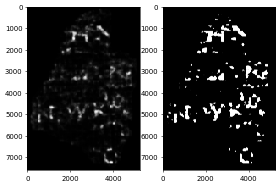

thr=0.150, precision=0.600, recall=0.460
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


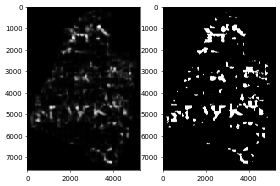

thr=0.150, precision=0.572, recall=0.463
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


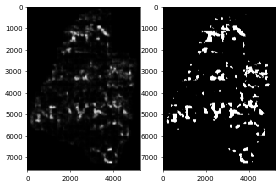

thr=0.150, precision=0.574, recall=0.471
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


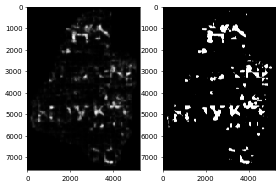

thr=0.150, precision=0.605, recall=0.458
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


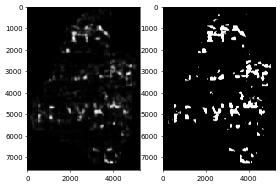

thr=0.150, precision=0.615, recall=0.450
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


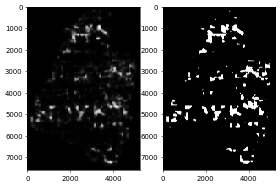

thr=0.150, precision=0.594, recall=0.451
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


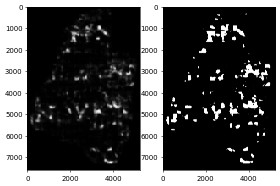

thr=0.150, precision=0.579, recall=0.443


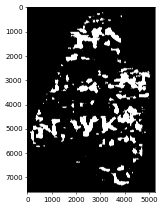

thr=0.150, fbate=0.546, precision=0.445, recall=0.663
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


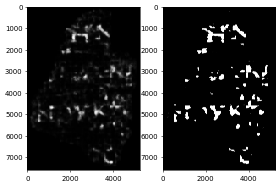

thr=0.200, precision=0.662, recall=0.400
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


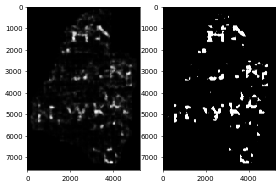

thr=0.200, precision=0.682, recall=0.392
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


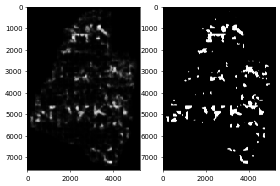

thr=0.200, precision=0.635, recall=0.399
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


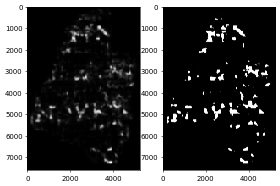

thr=0.200, precision=0.653, recall=0.394
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


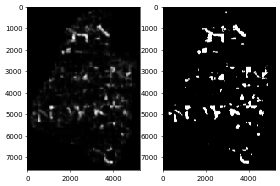

thr=0.200, precision=0.661, recall=0.378
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


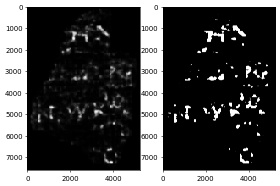

thr=0.200, precision=0.677, recall=0.385
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


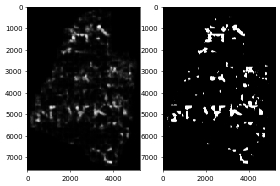

thr=0.200, precision=0.641, recall=0.377
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


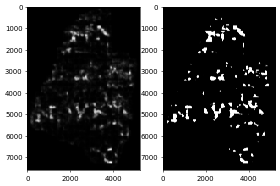

thr=0.200, precision=0.652, recall=0.380
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


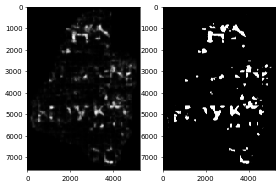

thr=0.200, precision=0.675, recall=0.388
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


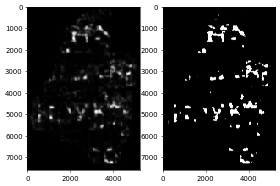

thr=0.200, precision=0.688, recall=0.377
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


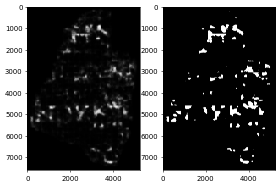

thr=0.200, precision=0.655, recall=0.381
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


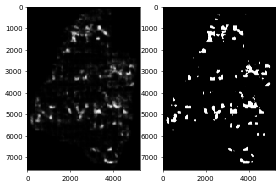

thr=0.200, precision=0.655, recall=0.380


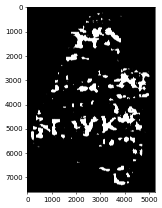

thr=0.200, fbate=0.572, precision=0.516, recall=0.583
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


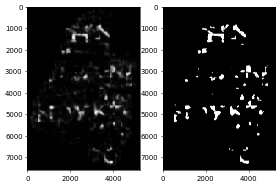

thr=0.250, precision=0.711, recall=0.354
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


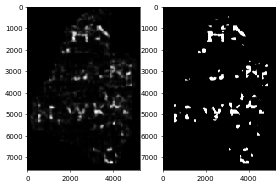

thr=0.250, precision=0.731, recall=0.347
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


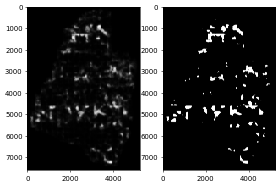

thr=0.250, precision=0.692, recall=0.345
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


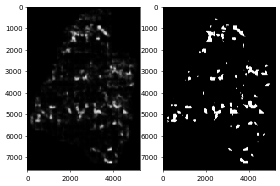

thr=0.250, precision=0.707, recall=0.339
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


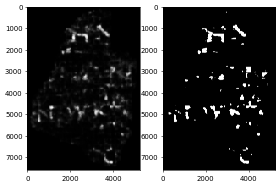

thr=0.250, precision=0.715, recall=0.320
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


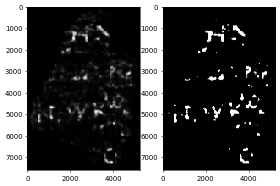

thr=0.250, precision=0.735, recall=0.334
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


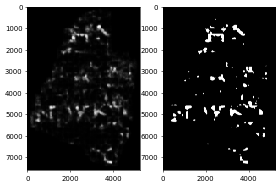

thr=0.250, precision=0.687, recall=0.318
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


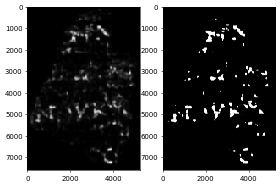

thr=0.250, precision=0.706, recall=0.323
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


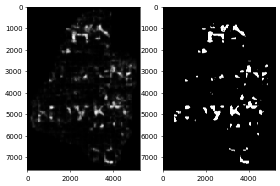

thr=0.250, precision=0.720, recall=0.338
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


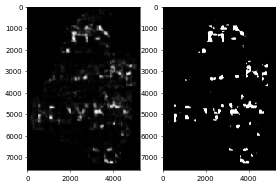

thr=0.250, precision=0.736, recall=0.324
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


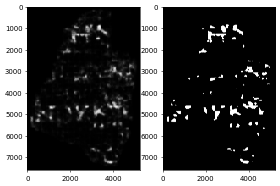

thr=0.250, precision=0.697, recall=0.332
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


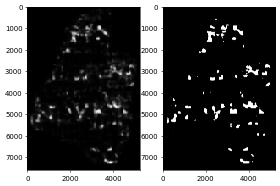

thr=0.250, precision=0.706, recall=0.333


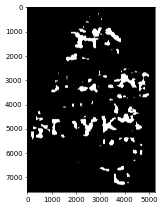

thr=0.250, fbate=0.576, precision=0.572, recall=0.528
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


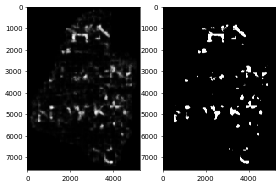

thr=0.300, precision=0.759, recall=0.309
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


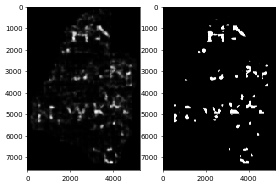

thr=0.300, precision=0.771, recall=0.306
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


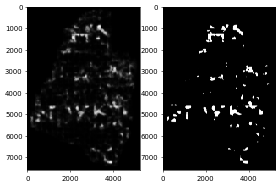

thr=0.300, precision=0.748, recall=0.297
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


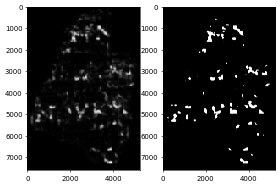

thr=0.300, precision=0.757, recall=0.292
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


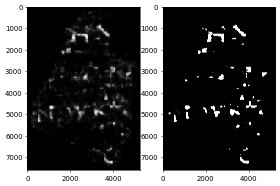

thr=0.300, precision=0.758, recall=0.275
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


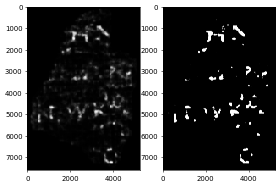

thr=0.300, precision=0.780, recall=0.282
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


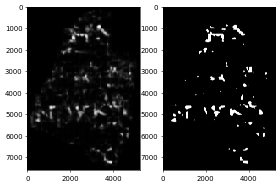

thr=0.300, precision=0.736, recall=0.272
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


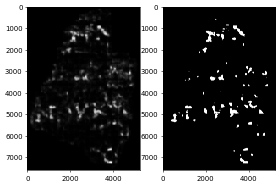

thr=0.300, precision=0.757, recall=0.275
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


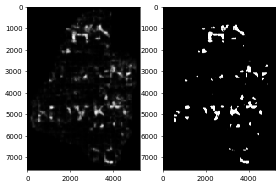

thr=0.300, precision=0.760, recall=0.292
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


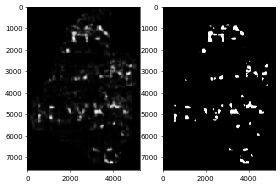

thr=0.300, precision=0.779, recall=0.278
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


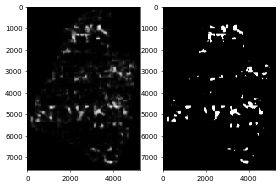

thr=0.300, precision=0.740, recall=0.287
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


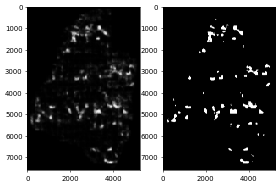

thr=0.300, precision=0.754, recall=0.288


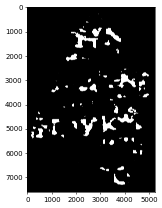

thr=0.300, fbate=0.570, precision=0.627, recall=0.477
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


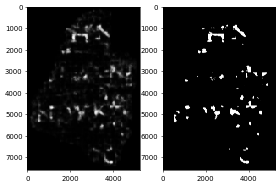

thr=0.350, precision=0.795, recall=0.268
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


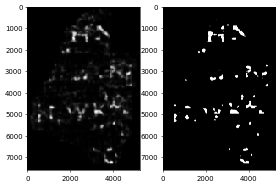

thr=0.350, precision=0.803, recall=0.265
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


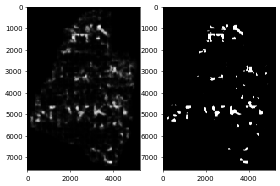

thr=0.350, precision=0.791, recall=0.255
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


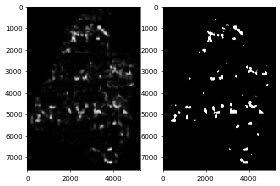

thr=0.350, precision=0.806, recall=0.254
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


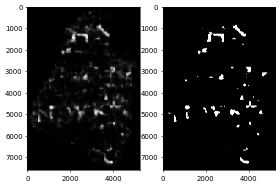

thr=0.350, precision=0.792, recall=0.241
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


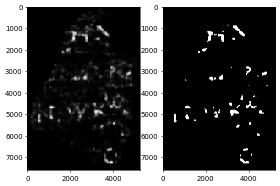

thr=0.350, precision=0.815, recall=0.242
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


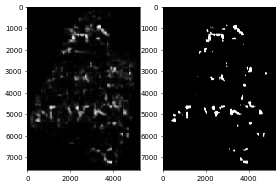

thr=0.350, precision=0.776, recall=0.231
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


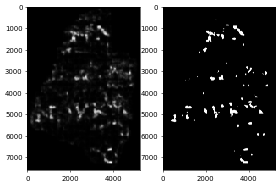

thr=0.350, precision=0.797, recall=0.232
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


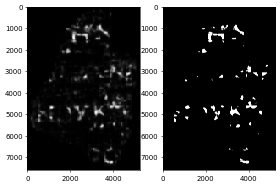

thr=0.350, precision=0.795, recall=0.250
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


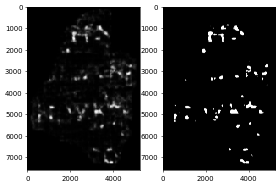

thr=0.350, precision=0.811, recall=0.241
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


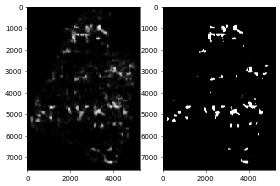

thr=0.350, precision=0.775, recall=0.244
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


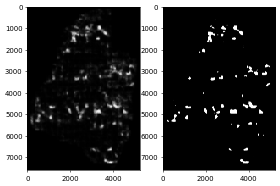

thr=0.350, precision=0.799, recall=0.249


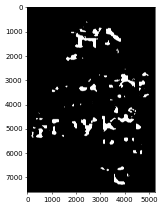

thr=0.350, fbate=0.554, precision=0.678, recall=0.430
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


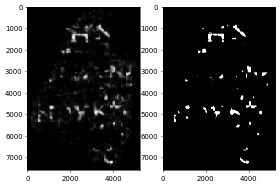

thr=0.400, precision=0.822, recall=0.232
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


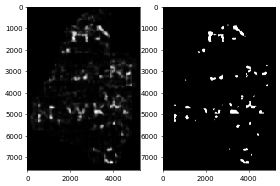

thr=0.400, precision=0.835, recall=0.230
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


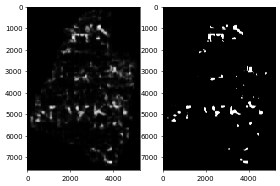

thr=0.400, precision=0.826, recall=0.218
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


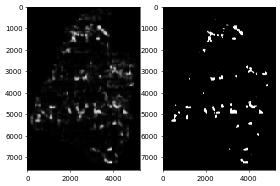

thr=0.400, precision=0.846, recall=0.220
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


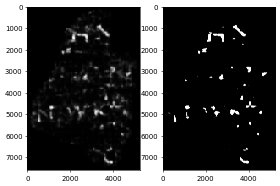

thr=0.400, precision=0.819, recall=0.209
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


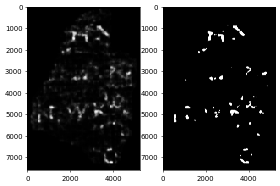

thr=0.400, precision=0.849, recall=0.209
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


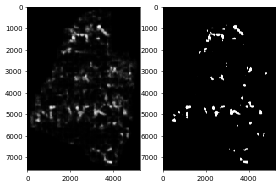

thr=0.400, precision=0.816, recall=0.195
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


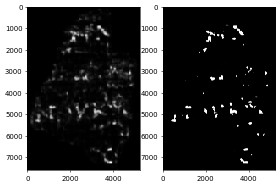

thr=0.400, precision=0.839, recall=0.194
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


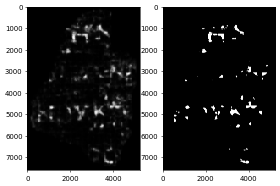

thr=0.400, precision=0.827, recall=0.211
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


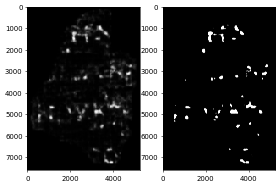

thr=0.400, precision=0.840, recall=0.206
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


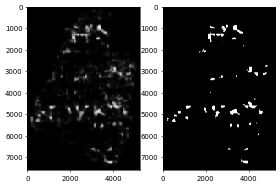

thr=0.400, precision=0.808, recall=0.207
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


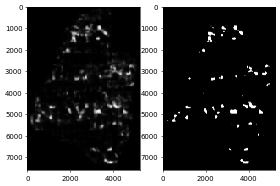

thr=0.400, precision=0.835, recall=0.210


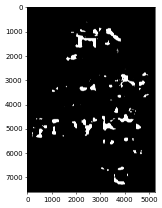

thr=0.400, fbate=0.523, precision=0.726, recall=0.381
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


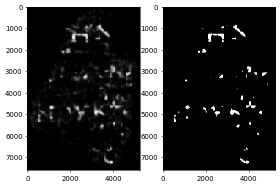

thr=0.450, precision=0.844, recall=0.203
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


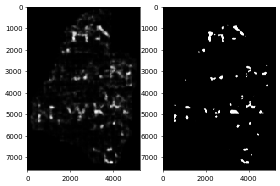

thr=0.450, precision=0.867, recall=0.199
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


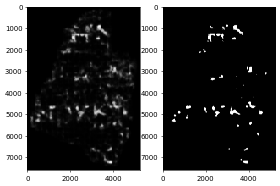

thr=0.450, precision=0.853, recall=0.185
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


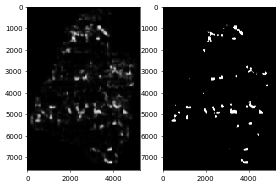

thr=0.450, precision=0.873, recall=0.189
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


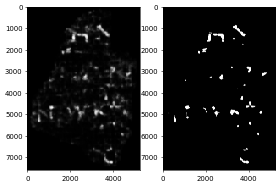

thr=0.450, precision=0.838, recall=0.181
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


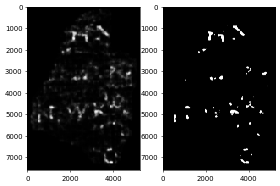

thr=0.450, precision=0.876, recall=0.180
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


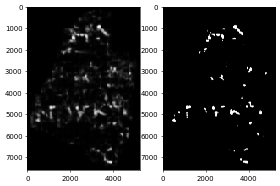

thr=0.450, precision=0.851, recall=0.163
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


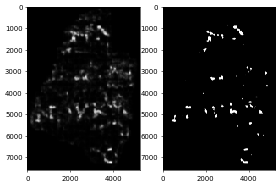

thr=0.450, precision=0.873, recall=0.163
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


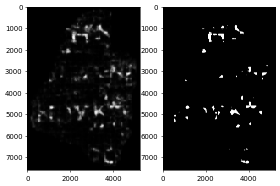

thr=0.450, precision=0.849, recall=0.178
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


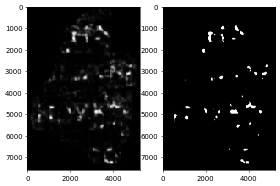

thr=0.450, precision=0.862, recall=0.176
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


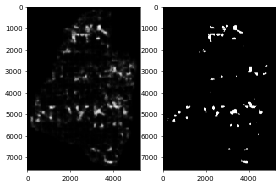

thr=0.450, precision=0.841, recall=0.176
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


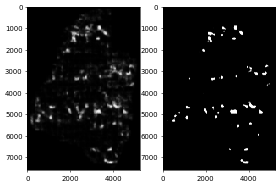

thr=0.450, precision=0.866, recall=0.178


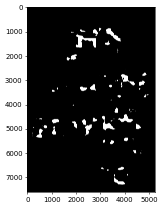

thr=0.450, fbate=0.489, precision=0.766, recall=0.337
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


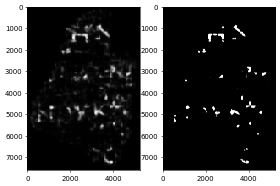

thr=0.500, precision=0.866, recall=0.172
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


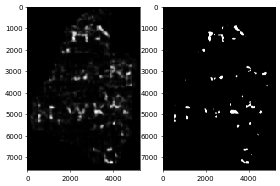

thr=0.500, precision=0.905, recall=0.169
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


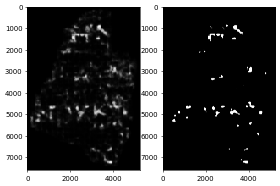

thr=0.500, precision=0.880, recall=0.153
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


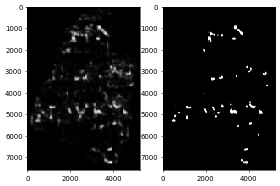

thr=0.500, precision=0.901, recall=0.159
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


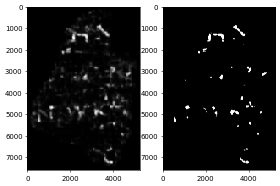

thr=0.500, precision=0.859, recall=0.151
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


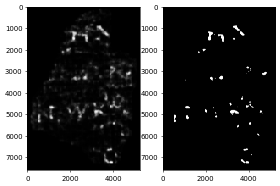

thr=0.500, precision=0.907, recall=0.152
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


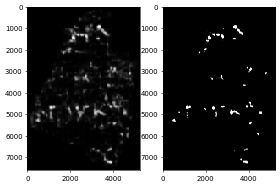

thr=0.500, precision=0.882, recall=0.130
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


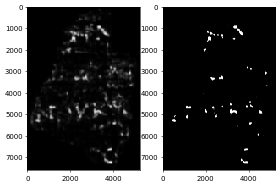

thr=0.500, precision=0.900, recall=0.134
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


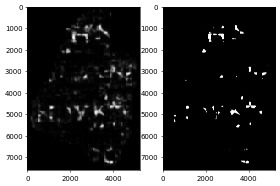

thr=0.500, precision=0.872, recall=0.149
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


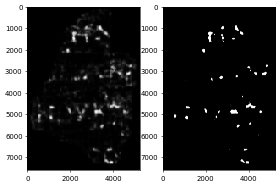

thr=0.500, precision=0.883, recall=0.149
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


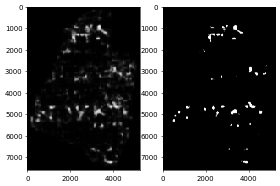

thr=0.500, precision=0.882, recall=0.144
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


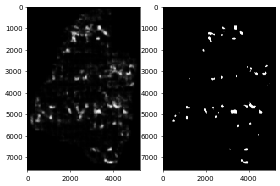

thr=0.500, precision=0.896, recall=0.148


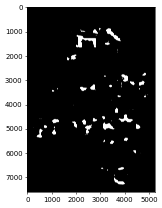

thr=0.500, fbate=0.446, precision=0.804, recall=0.294
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


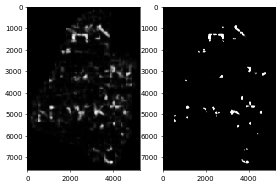

thr=0.550, precision=0.887, recall=0.142
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


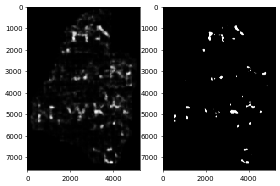

thr=0.550, precision=0.936, recall=0.137
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


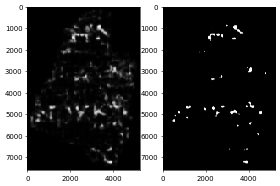

thr=0.550, precision=0.906, recall=0.124
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


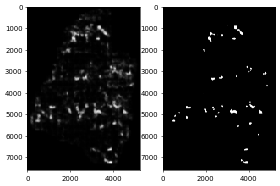

thr=0.550, precision=0.927, recall=0.128
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


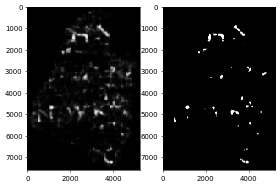

thr=0.550, precision=0.880, recall=0.122
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


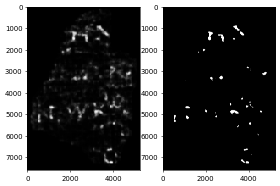

thr=0.550, precision=0.939, recall=0.125
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


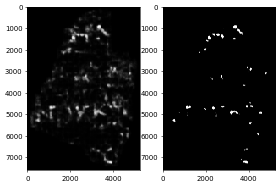

thr=0.550, precision=0.906, recall=0.100
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


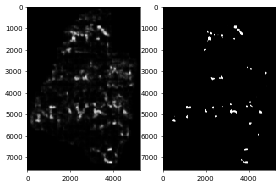

thr=0.550, precision=0.920, recall=0.107
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


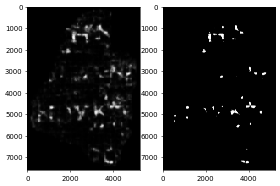

thr=0.550, precision=0.895, recall=0.122
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


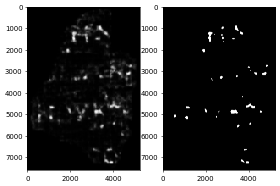

thr=0.550, precision=0.900, recall=0.124
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


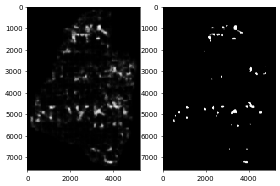

thr=0.550, precision=0.917, recall=0.112
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


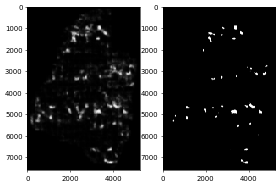

thr=0.550, precision=0.920, recall=0.119


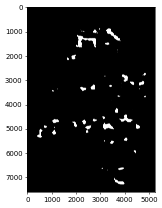

thr=0.550, fbate=0.392, precision=0.836, recall=0.254
--------- thrshold = 0.6000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


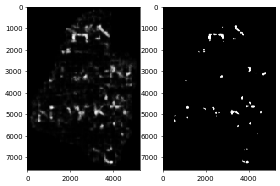

thr=0.600, precision=0.909, recall=0.111
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


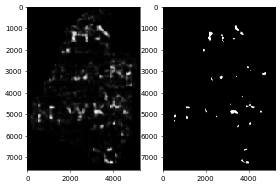

thr=0.600, precision=0.954, recall=0.106
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


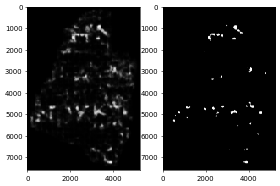

thr=0.600, precision=0.938, recall=0.096
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


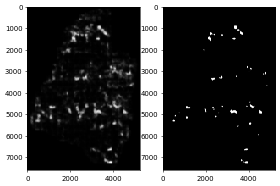

thr=0.600, precision=0.949, recall=0.099
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


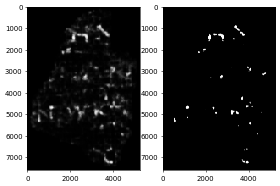

thr=0.600, precision=0.905, recall=0.095
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


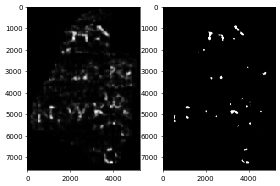

thr=0.600, precision=0.967, recall=0.099
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


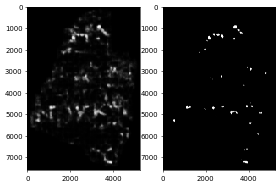

thr=0.600, precision=0.931, recall=0.073
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


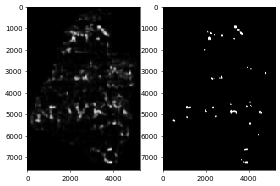

thr=0.600, precision=0.942, recall=0.081
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


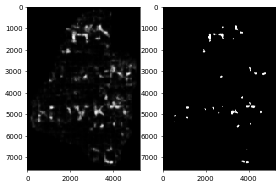

thr=0.600, precision=0.914, recall=0.095
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


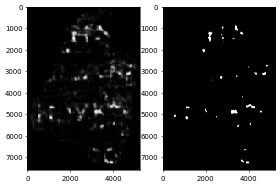

thr=0.600, precision=0.915, recall=0.100
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


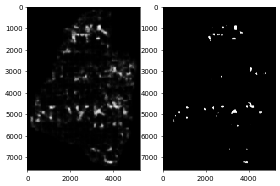

thr=0.600, precision=0.944, recall=0.084
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


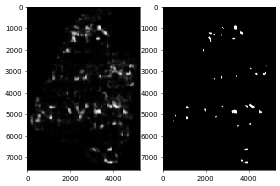

thr=0.600, precision=0.944, recall=0.090


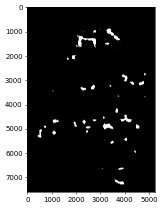

thr=0.600, fbate=0.326, precision=0.869, recall=0.214
--------- thrshold = 0.6500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


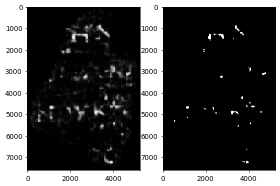

thr=0.650, precision=0.933, recall=0.084
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


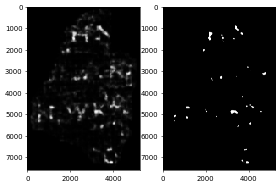

thr=0.650, precision=0.969, recall=0.082
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


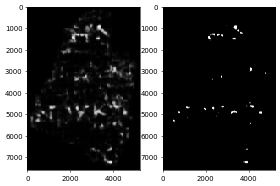

thr=0.650, precision=0.969, recall=0.071
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


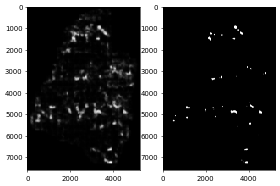

thr=0.650, precision=0.967, recall=0.072
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


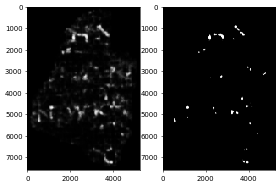

thr=0.650, precision=0.932, recall=0.072
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


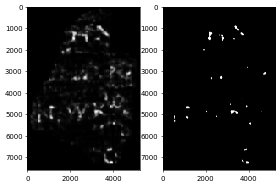

thr=0.650, precision=0.982, recall=0.077
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


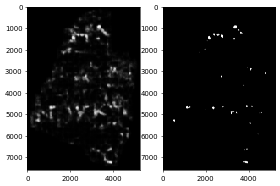

thr=0.650, precision=0.961, recall=0.052
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


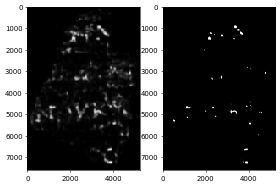

thr=0.650, precision=0.967, recall=0.058
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


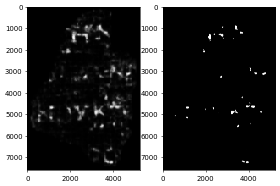

thr=0.650, precision=0.933, recall=0.072
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


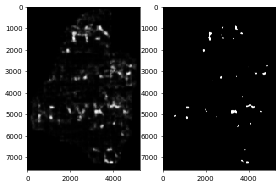

thr=0.650, precision=0.930, recall=0.080
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


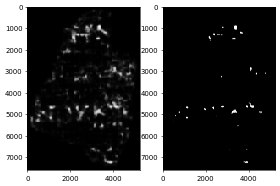

thr=0.650, precision=0.955, recall=0.061
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


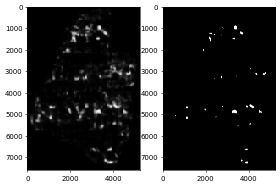

thr=0.650, precision=0.961, recall=0.066


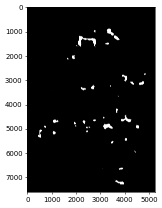

thr=0.650, fbate=0.260, precision=0.902, recall=0.174
--------- thrshold = 0.7000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


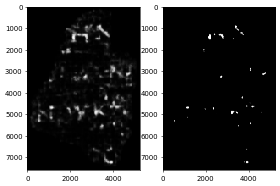

thr=0.700, precision=0.961, recall=0.057
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


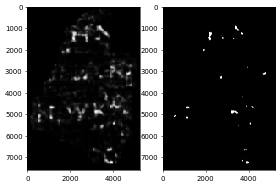

thr=0.700, precision=0.988, recall=0.060
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


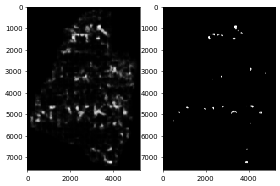

thr=0.700, precision=0.989, recall=0.045
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


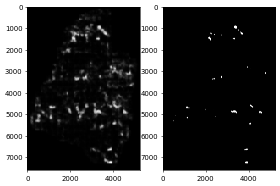

thr=0.700, precision=0.985, recall=0.047
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


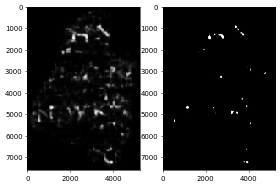

thr=0.700, precision=0.960, recall=0.051
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


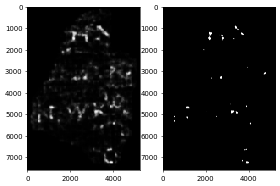

thr=0.700, precision=0.992, recall=0.054
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


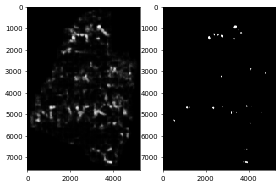

thr=0.700, precision=0.982, recall=0.034
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


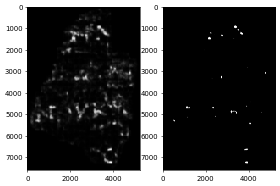

thr=0.700, precision=0.989, recall=0.035
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


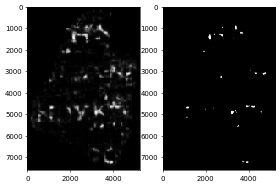

thr=0.700, precision=0.959, recall=0.049
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


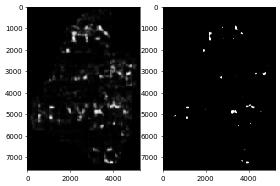

thr=0.700, precision=0.953, recall=0.059
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


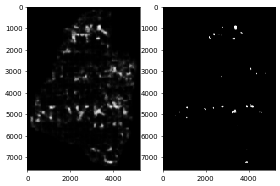

thr=0.700, precision=0.965, recall=0.039
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


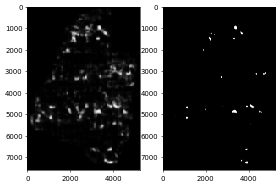

thr=0.700, precision=0.972, recall=0.045


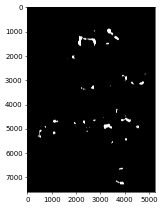

thr=0.700, fbate=0.191, precision=0.940, recall=0.131
--------- thrshold = 0.7500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


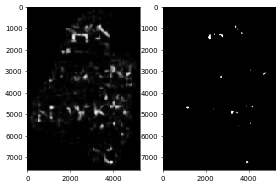

thr=0.750, precision=0.993, recall=0.036
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


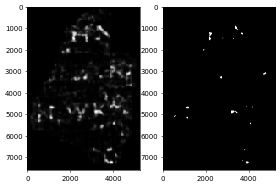

thr=0.750, precision=0.997, recall=0.040
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


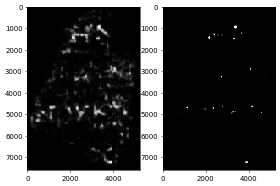

thr=0.750, precision=0.997, recall=0.025
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


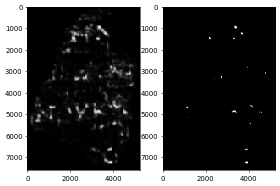

thr=0.750, precision=1.000, recall=0.027
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


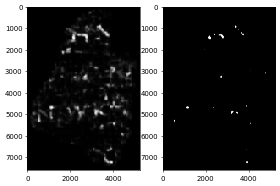

thr=0.750, precision=0.977, recall=0.034
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


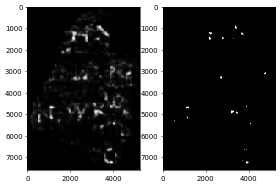

thr=0.750, precision=0.998, recall=0.035
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


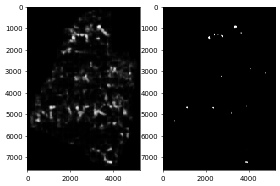

thr=0.750, precision=0.992, recall=0.020
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


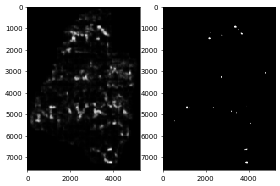

thr=0.750, precision=0.997, recall=0.019
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


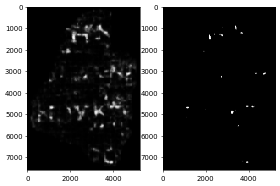

thr=0.750, precision=0.978, recall=0.031
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


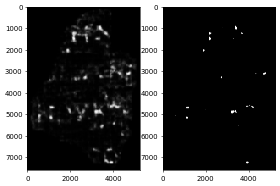

thr=0.750, precision=0.973, recall=0.039
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


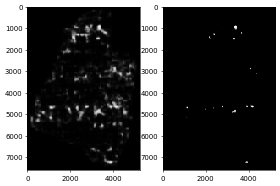

thr=0.750, precision=0.979, recall=0.022
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


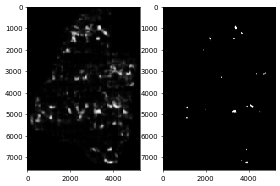

thr=0.750, precision=0.982, recall=0.028


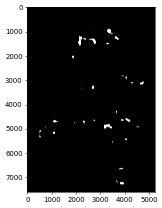

thr=0.750, fbate=0.127, precision=0.972, recall=0.089
--------- thrshold = 0.8000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


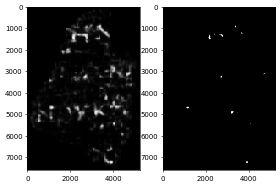

thr=0.800, precision=1.000, recall=0.020
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


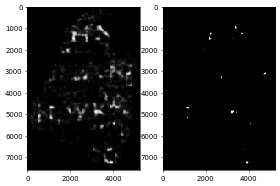

thr=0.800, precision=1.000, recall=0.023
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


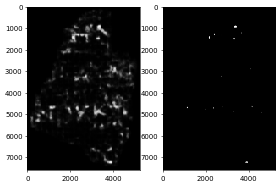

thr=0.800, precision=1.000, recall=0.012
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


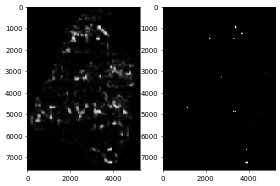

thr=0.800, precision=1.000, recall=0.012
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


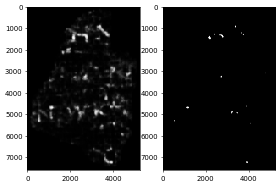

thr=0.800, precision=0.997, recall=0.021
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


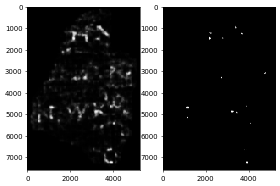

thr=0.800, precision=1.000, recall=0.019
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


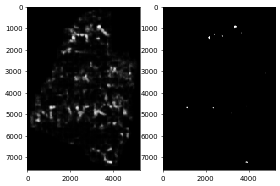

thr=0.800, precision=0.998, recall=0.011
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


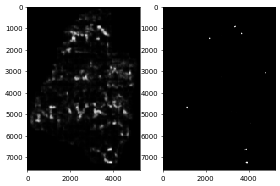

thr=0.800, precision=1.000, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


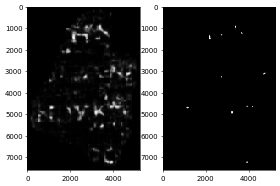

thr=0.800, precision=0.996, recall=0.017
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


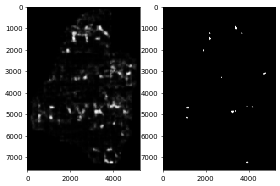

thr=0.800, precision=0.987, recall=0.023
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


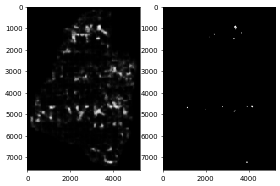

thr=0.800, precision=0.993, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


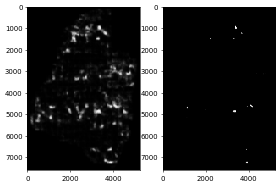

thr=0.800, precision=0.993, recall=0.015


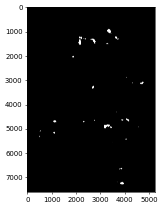

thr=0.800, fbate=0.073, precision=0.992, recall=0.053
--------- thrshold = 0.8500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


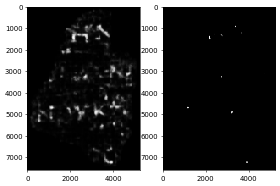

thr=0.850, precision=1.000, recall=0.010
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


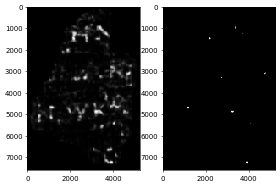

thr=0.850, precision=1.000, recall=0.011
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


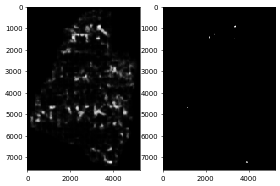

thr=0.850, precision=1.000, recall=0.005
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


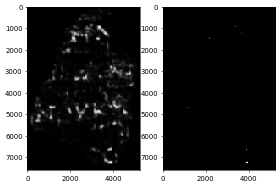

thr=0.850, precision=1.000, recall=0.004
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


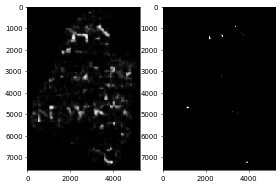

thr=0.850, precision=1.000, recall=0.009
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


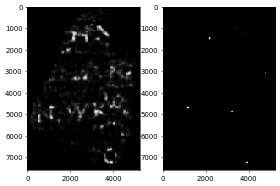

thr=0.850, precision=1.000, recall=0.008
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


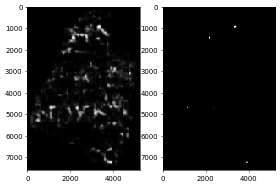

thr=0.850, precision=1.000, recall=0.006
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


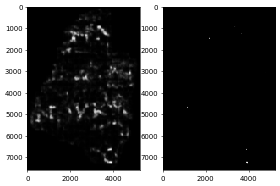

thr=0.850, precision=1.000, recall=0.004
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


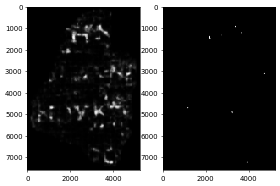

thr=0.850, precision=1.000, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


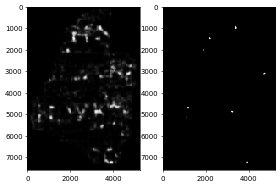

thr=0.850, precision=0.998, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


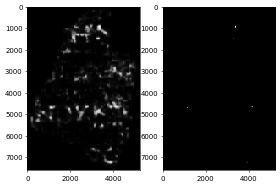

thr=0.850, precision=1.000, recall=0.004
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


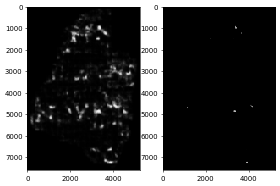

thr=0.850, precision=1.000, recall=0.006


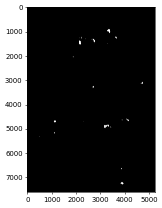

thr=0.850, fbate=0.030, precision=0.999, recall=0.027
--------- thrshold = 0.9000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


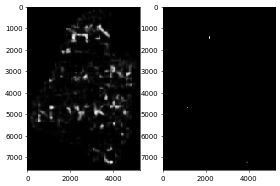

thr=0.900, precision=1.000, recall=0.003
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


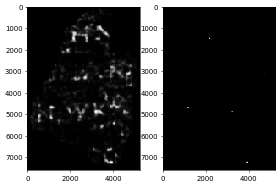

thr=0.900, precision=1.000, recall=0.003
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


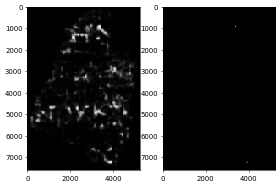

thr=0.900, precision=1.000, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


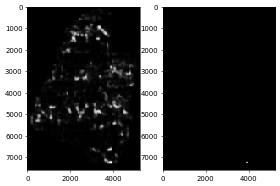

thr=0.900, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


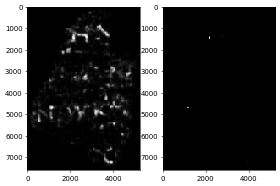

thr=0.900, precision=1.000, recall=0.003
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


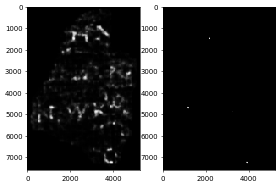

thr=0.900, precision=1.000, recall=0.003
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


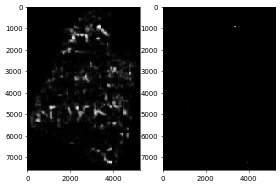

thr=0.900, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


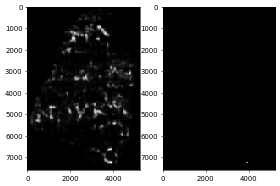

thr=0.900, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


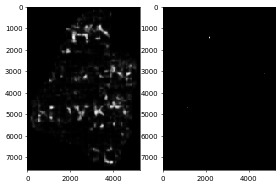

thr=0.900, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


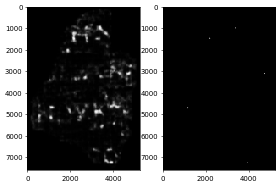

thr=0.900, precision=1.000, recall=0.002
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


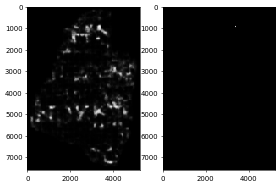

thr=0.900, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


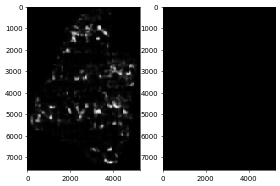

thr=0.900, precision=1.000, recall=0.000


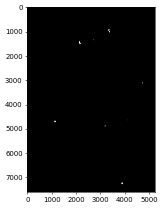

thr=0.900, fbate=0.001, precision=1.000, recall=0.007
--------- thrshold = 0.9500000000000003 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


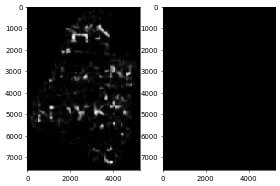

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


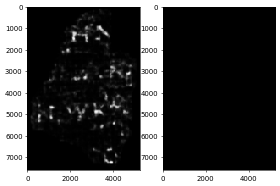

thr=0.950, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


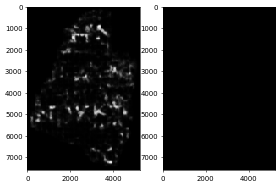

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


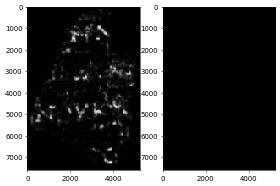

thr=0.950, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


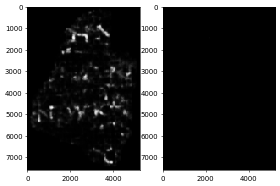

thr=0.950, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


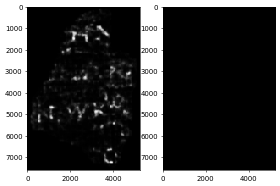

thr=0.950, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


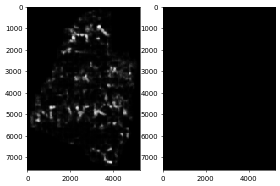

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


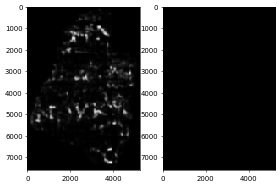

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


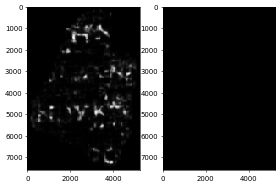

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


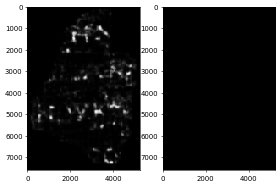

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


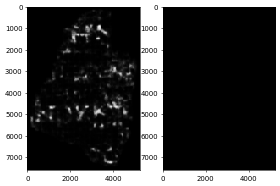

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


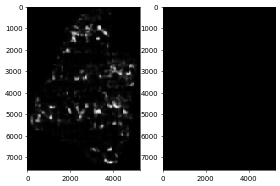

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000


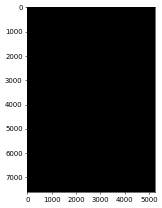

thr=0.950, fbate=0.000, precision=1.000, recall=0.000
fold =  1


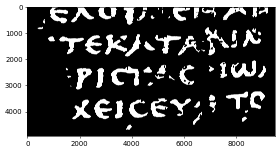

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


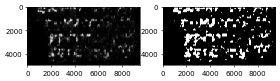

thr=0.100, precision=0.549, recall=0.578
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


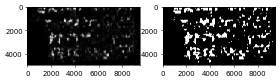

thr=0.100, precision=0.536, recall=0.497
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


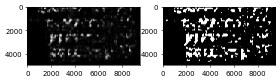

thr=0.100, precision=0.535, recall=0.558
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


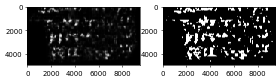

thr=0.100, precision=0.528, recall=0.501
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


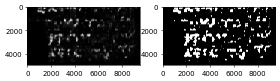

thr=0.100, precision=0.548, recall=0.540
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


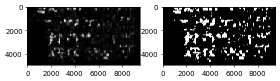

thr=0.100, precision=0.539, recall=0.474
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


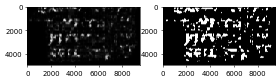

thr=0.100, precision=0.543, recall=0.543
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


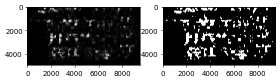

thr=0.100, precision=0.526, recall=0.482
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


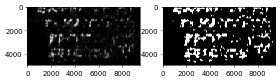

thr=0.100, precision=0.533, recall=0.591
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


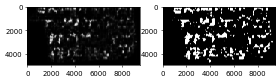

thr=0.100, precision=0.526, recall=0.513
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


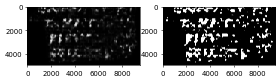

thr=0.100, precision=0.539, recall=0.570
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


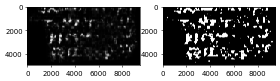

thr=0.100, precision=0.532, recall=0.505


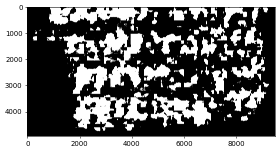

thr=0.100, fbate=0.526, precision=0.391, recall=0.802
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


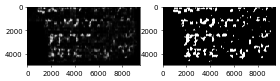

thr=0.150, precision=0.635, recall=0.486
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


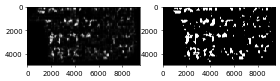

thr=0.150, precision=0.612, recall=0.411
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


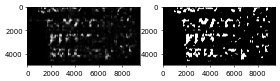

thr=0.150, precision=0.626, recall=0.468
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


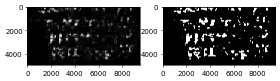

thr=0.150, precision=0.610, recall=0.410
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


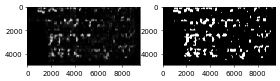

thr=0.150, precision=0.626, recall=0.454
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


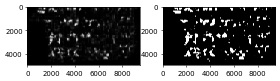

thr=0.150, precision=0.610, recall=0.388
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


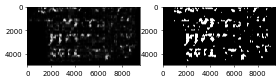

thr=0.150, precision=0.629, recall=0.447
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


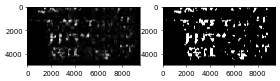

thr=0.150, precision=0.614, recall=0.387
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


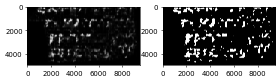

thr=0.150, precision=0.618, recall=0.497
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


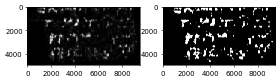

thr=0.150, precision=0.594, recall=0.416
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


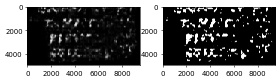

thr=0.150, precision=0.619, recall=0.475
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


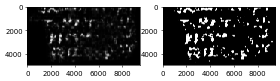

thr=0.150, precision=0.604, recall=0.411


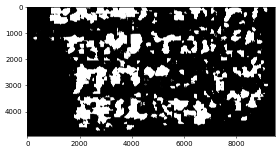

thr=0.150, fbate=0.552, precision=0.465, recall=0.704
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


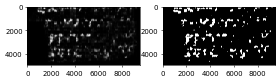

thr=0.200, precision=0.695, recall=0.417
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


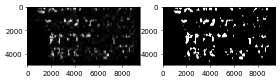

thr=0.200, precision=0.669, recall=0.353
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


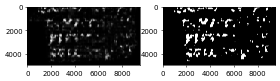

thr=0.200, precision=0.687, recall=0.400
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


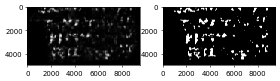

thr=0.200, precision=0.674, recall=0.347
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


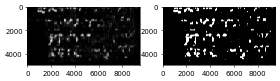

thr=0.200, precision=0.687, recall=0.390
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


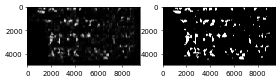

thr=0.200, precision=0.665, recall=0.330
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


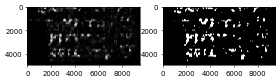

thr=0.200, precision=0.695, recall=0.376
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


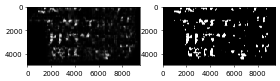

thr=0.200, precision=0.678, recall=0.326
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


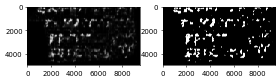

thr=0.200, precision=0.681, recall=0.424
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


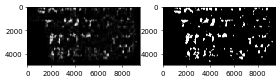

thr=0.200, precision=0.650, recall=0.351
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


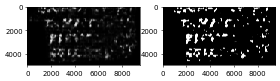

thr=0.200, precision=0.684, recall=0.407
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


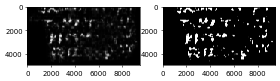

thr=0.200, precision=0.666, recall=0.347


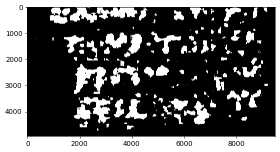

thr=0.200, fbate=0.562, precision=0.531, recall=0.627
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


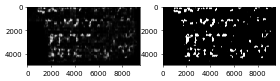

thr=0.250, precision=0.742, recall=0.367
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


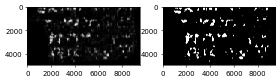

thr=0.250, precision=0.713, recall=0.307
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


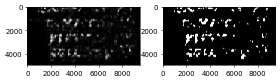

thr=0.250, precision=0.728, recall=0.348
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


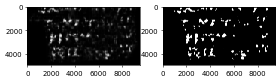

thr=0.250, precision=0.718, recall=0.301
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


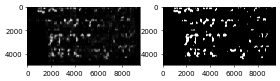

thr=0.250, precision=0.726, recall=0.339
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


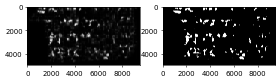

thr=0.250, precision=0.707, recall=0.287
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


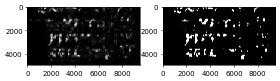

thr=0.250, precision=0.742, recall=0.322
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


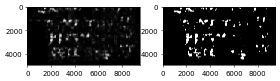

thr=0.250, precision=0.726, recall=0.280
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


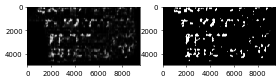

thr=0.250, precision=0.725, recall=0.367
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


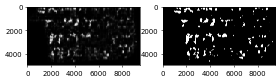

thr=0.250, precision=0.690, recall=0.301
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


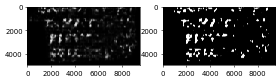

thr=0.250, precision=0.731, recall=0.354
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


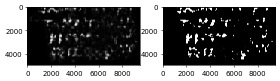

thr=0.250, precision=0.704, recall=0.296


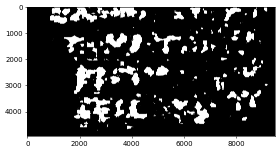

thr=0.250, fbate=0.552, precision=0.584, recall=0.565
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


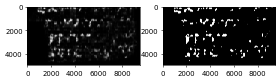

thr=0.300, precision=0.784, recall=0.317
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


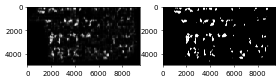

thr=0.300, precision=0.753, recall=0.263
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


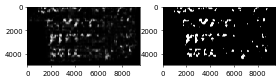

thr=0.300, precision=0.765, recall=0.300
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


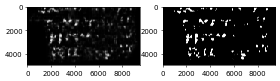

thr=0.300, precision=0.754, recall=0.260
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


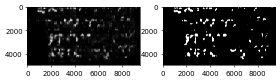

thr=0.300, precision=0.765, recall=0.292
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


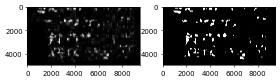

thr=0.300, precision=0.751, recall=0.246
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


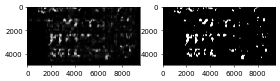

thr=0.300, precision=0.779, recall=0.271
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


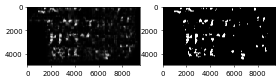

thr=0.300, precision=0.766, recall=0.239
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


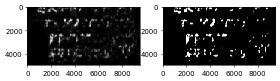

thr=0.300, precision=0.762, recall=0.314
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


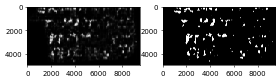

thr=0.300, precision=0.725, recall=0.257
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


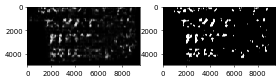

thr=0.300, precision=0.768, recall=0.304
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


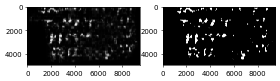

thr=0.300, precision=0.736, recall=0.250


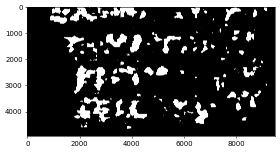

thr=0.300, fbate=0.530, precision=0.638, recall=0.509
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


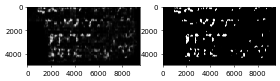

thr=0.350, precision=0.814, recall=0.270
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


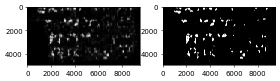

thr=0.350, precision=0.784, recall=0.225
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


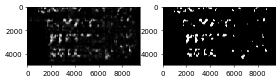

thr=0.350, precision=0.797, recall=0.259
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


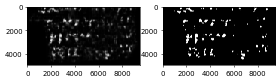

thr=0.350, precision=0.780, recall=0.223
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


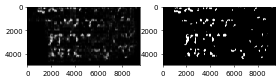

thr=0.350, precision=0.799, recall=0.249
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


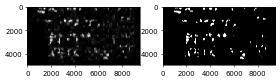

thr=0.350, precision=0.787, recall=0.212
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


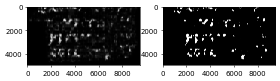

thr=0.350, precision=0.807, recall=0.228
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


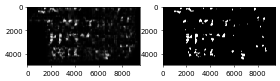

thr=0.350, precision=0.794, recall=0.204
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


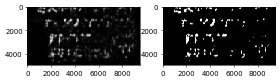

thr=0.350, precision=0.799, recall=0.270
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


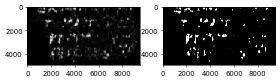

thr=0.350, precision=0.756, recall=0.220
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


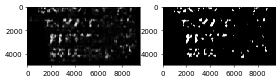

thr=0.350, precision=0.798, recall=0.260
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


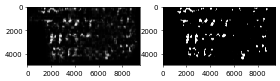

thr=0.350, precision=0.760, recall=0.212


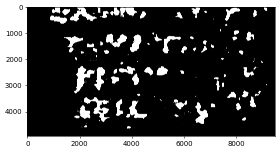

thr=0.350, fbate=0.501, precision=0.686, recall=0.455
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


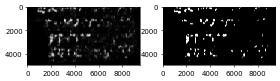

thr=0.400, precision=0.838, recall=0.230
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


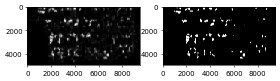

thr=0.400, precision=0.806, recall=0.190
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


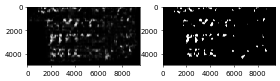

thr=0.400, precision=0.828, recall=0.223
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


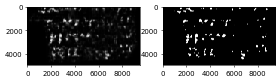

thr=0.400, precision=0.799, recall=0.188
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


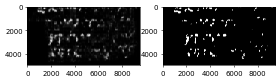

thr=0.400, precision=0.829, recall=0.210
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


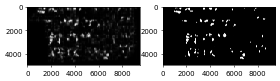

thr=0.400, precision=0.813, recall=0.179
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


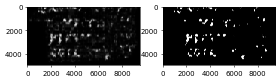

thr=0.400, precision=0.830, recall=0.192
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


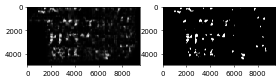

thr=0.400, precision=0.810, recall=0.171
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


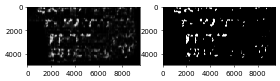

thr=0.400, precision=0.835, recall=0.231
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


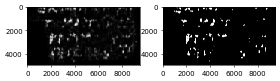

thr=0.400, precision=0.790, recall=0.189
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


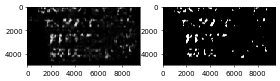

thr=0.400, precision=0.826, recall=0.222
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


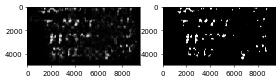

thr=0.400, precision=0.780, recall=0.179


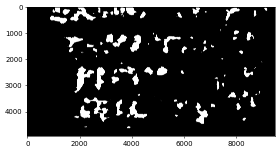

thr=0.400, fbate=0.467, precision=0.725, recall=0.402
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


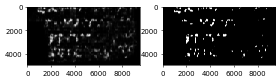

thr=0.450, precision=0.858, recall=0.197
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


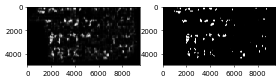

thr=0.450, precision=0.823, recall=0.161
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


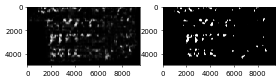

thr=0.450, precision=0.852, recall=0.192
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


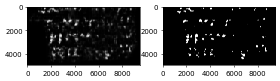

thr=0.450, precision=0.814, recall=0.156
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


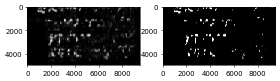

thr=0.450, precision=0.853, recall=0.176
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


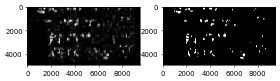

thr=0.450, precision=0.831, recall=0.151
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


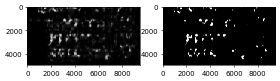

thr=0.450, precision=0.848, recall=0.164
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


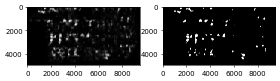

thr=0.450, precision=0.822, recall=0.144
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


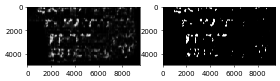

thr=0.450, precision=0.864, recall=0.199
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


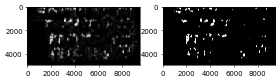

thr=0.450, precision=0.817, recall=0.163
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


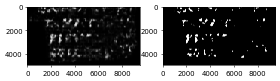

thr=0.450, precision=0.852, recall=0.191
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


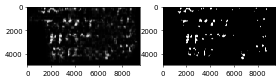

thr=0.450, precision=0.799, recall=0.153


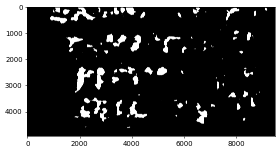

thr=0.450, fbate=0.433, precision=0.758, recall=0.357
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


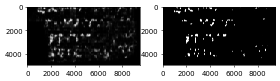

thr=0.500, precision=0.879, recall=0.164
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


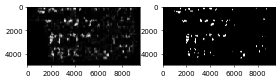

thr=0.500, precision=0.837, recall=0.133
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


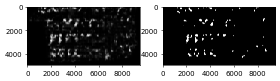

thr=0.500, precision=0.878, recall=0.161
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


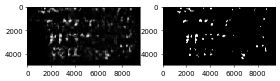

thr=0.500, precision=0.830, recall=0.127
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


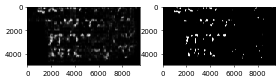

thr=0.500, precision=0.882, recall=0.145
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


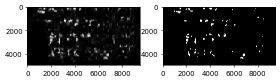

thr=0.500, precision=0.849, recall=0.124
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


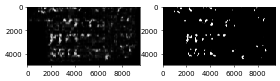

thr=0.500, precision=0.867, recall=0.138
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


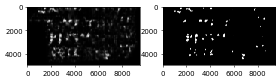

thr=0.500, precision=0.833, recall=0.117
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


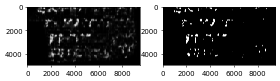

thr=0.500, precision=0.889, recall=0.167
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


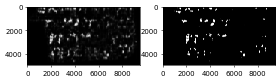

thr=0.500, precision=0.843, recall=0.138
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


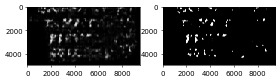

thr=0.500, precision=0.874, recall=0.159
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


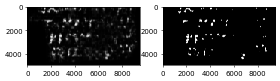

thr=0.500, precision=0.817, recall=0.128


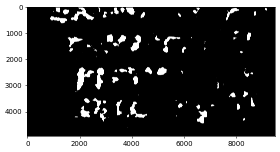

thr=0.500, fbate=0.394, precision=0.791, recall=0.310
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


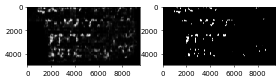

thr=0.550, precision=0.899, recall=0.133
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


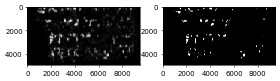

thr=0.550, precision=0.856, recall=0.110
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


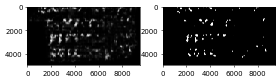

thr=0.550, precision=0.902, recall=0.130
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


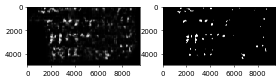

thr=0.550, precision=0.843, recall=0.101
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


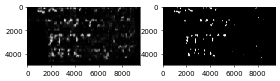

thr=0.550, precision=0.908, recall=0.117
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


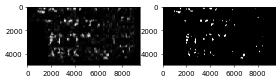

thr=0.550, precision=0.865, recall=0.101
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


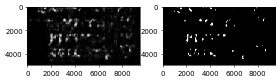

thr=0.550, precision=0.882, recall=0.113
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


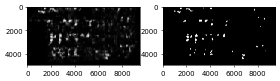

thr=0.550, precision=0.847, recall=0.094
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


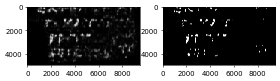

thr=0.550, precision=0.904, recall=0.138
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


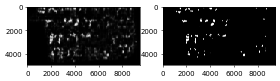

thr=0.550, precision=0.872, recall=0.115
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


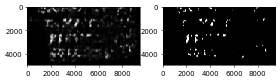

thr=0.550, precision=0.892, recall=0.130
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


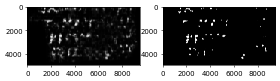

thr=0.550, precision=0.838, recall=0.106


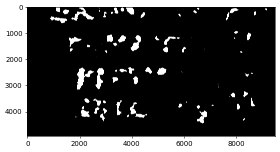

thr=0.550, fbate=0.352, precision=0.822, recall=0.265
--------- thrshold = 0.6000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


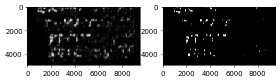

thr=0.600, precision=0.917, recall=0.105
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


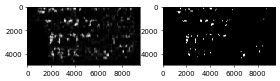

thr=0.600, precision=0.875, recall=0.088
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


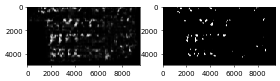

thr=0.600, precision=0.925, recall=0.102
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


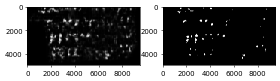

thr=0.600, precision=0.857, recall=0.079
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


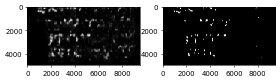

thr=0.600, precision=0.926, recall=0.091
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


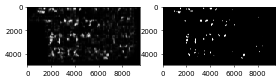

thr=0.600, precision=0.878, recall=0.079
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


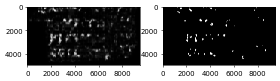

thr=0.600, precision=0.896, recall=0.087
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


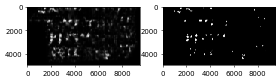

thr=0.600, precision=0.863, recall=0.072
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


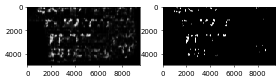

thr=0.600, precision=0.917, recall=0.109
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


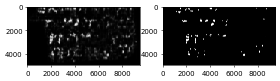

thr=0.600, precision=0.891, recall=0.095
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


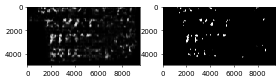

thr=0.600, precision=0.914, recall=0.105
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


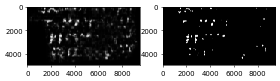

thr=0.600, precision=0.864, recall=0.086


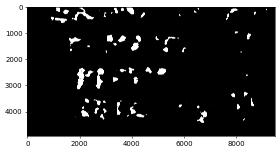

thr=0.600, fbate=0.308, precision=0.847, recall=0.221
--------- thrshold = 0.6500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


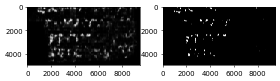

thr=0.650, precision=0.929, recall=0.079
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


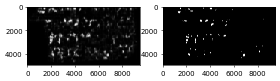

thr=0.650, precision=0.889, recall=0.069
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


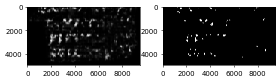

thr=0.650, precision=0.940, recall=0.078
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


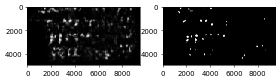

thr=0.650, precision=0.880, recall=0.062
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


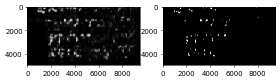

thr=0.650, precision=0.932, recall=0.068
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


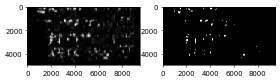

thr=0.650, precision=0.899, recall=0.061
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


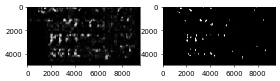

thr=0.650, precision=0.911, recall=0.066
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


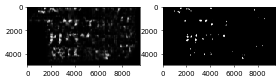

thr=0.650, precision=0.881, recall=0.055
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


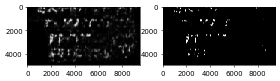

thr=0.650, precision=0.928, recall=0.084
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


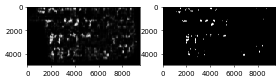

thr=0.650, precision=0.906, recall=0.077
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


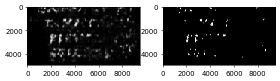

thr=0.650, precision=0.932, recall=0.082
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


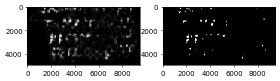

thr=0.650, precision=0.890, recall=0.069


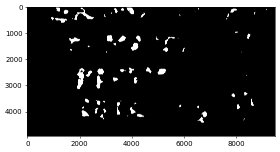

thr=0.650, fbate=0.263, precision=0.871, recall=0.181
--------- thrshold = 0.7000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


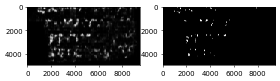

thr=0.700, precision=0.937, recall=0.054
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


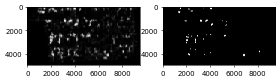

thr=0.700, precision=0.903, recall=0.052
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


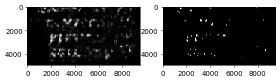

thr=0.700, precision=0.950, recall=0.056
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


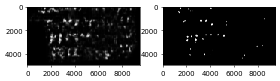

thr=0.700, precision=0.915, recall=0.047
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


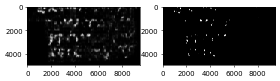

thr=0.700, precision=0.932, recall=0.044
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


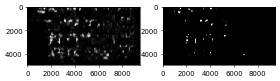

thr=0.700, precision=0.926, recall=0.044
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


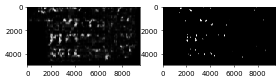

thr=0.700, precision=0.928, recall=0.044
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


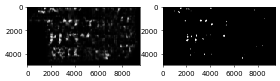

thr=0.700, precision=0.905, recall=0.039
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


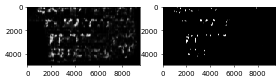

thr=0.700, precision=0.938, recall=0.060
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


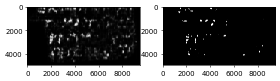

thr=0.700, precision=0.921, recall=0.058
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


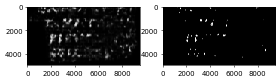

thr=0.700, precision=0.943, recall=0.059
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


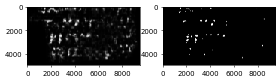

thr=0.700, precision=0.914, recall=0.052


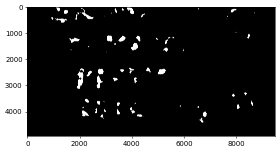

thr=0.700, fbate=0.212, precision=0.893, recall=0.137
--------- thrshold = 0.7500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


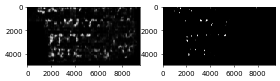

thr=0.750, precision=0.943, recall=0.033
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


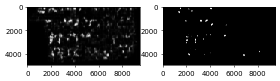

thr=0.750, precision=0.907, recall=0.036
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


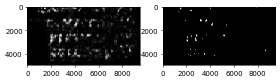

thr=0.750, precision=0.955, recall=0.036
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


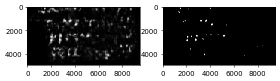

thr=0.750, precision=0.939, recall=0.034
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


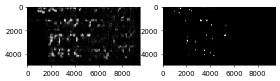

thr=0.750, precision=0.940, recall=0.026
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


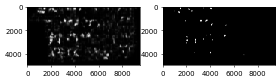

thr=0.750, precision=0.942, recall=0.030
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


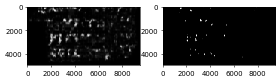

thr=0.750, precision=0.946, recall=0.027
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


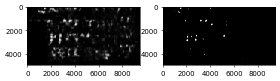

thr=0.750, precision=0.924, recall=0.026
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


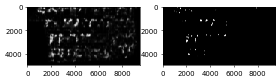

thr=0.750, precision=0.940, recall=0.037
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


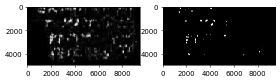

thr=0.750, precision=0.928, recall=0.041
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


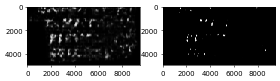

thr=0.750, precision=0.951, recall=0.040
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


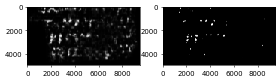

thr=0.750, precision=0.927, recall=0.037


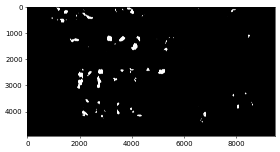

thr=0.750, fbate=0.161, precision=0.916, recall=0.096
--------- thrshold = 0.8000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


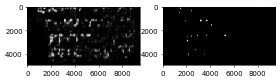

thr=0.800, precision=0.948, recall=0.017
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


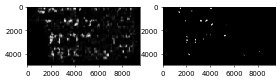

thr=0.800, precision=0.920, recall=0.023
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


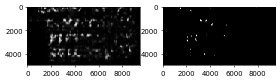

thr=0.800, precision=0.949, recall=0.021
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


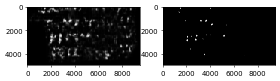

thr=0.800, precision=0.936, recall=0.023
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


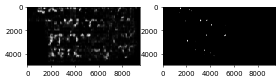

thr=0.800, precision=0.961, recall=0.013
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


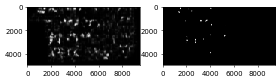

thr=0.800, precision=0.952, recall=0.018
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


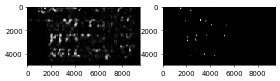

thr=0.800, precision=0.942, recall=0.015
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


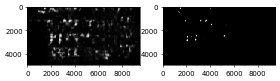

thr=0.800, precision=0.923, recall=0.017
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


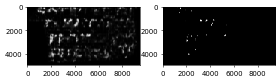

thr=0.800, precision=0.940, recall=0.020
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


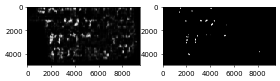

thr=0.800, precision=0.938, recall=0.027
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


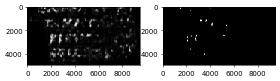

thr=0.800, precision=0.944, recall=0.024
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


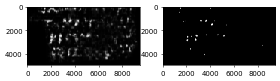

thr=0.800, precision=0.918, recall=0.024


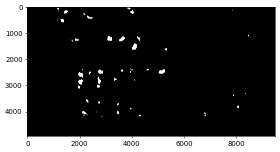

thr=0.800, fbate=0.107, precision=0.932, recall=0.059
--------- thrshold = 0.8500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


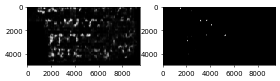

thr=0.850, precision=0.966, recall=0.007
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


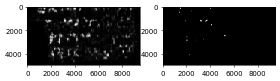

thr=0.850, precision=0.943, recall=0.012
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


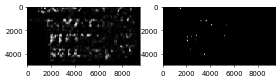

thr=0.850, precision=0.933, recall=0.010
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


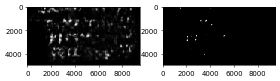

thr=0.850, precision=0.907, recall=0.013
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


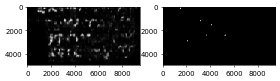

thr=0.850, precision=0.990, recall=0.005
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


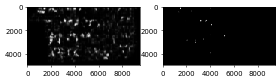

thr=0.850, precision=0.947, recall=0.009
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


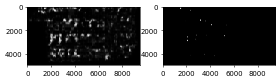

thr=0.850, precision=0.932, recall=0.006
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


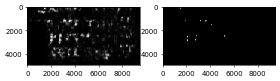

thr=0.850, precision=0.901, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


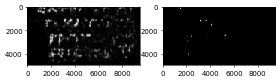

thr=0.850, precision=0.951, recall=0.009
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


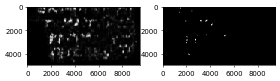

thr=0.850, precision=0.939, recall=0.015
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


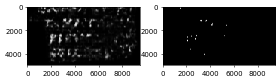

thr=0.850, precision=0.937, recall=0.012
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


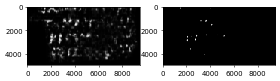

thr=0.850, precision=0.903, recall=0.014


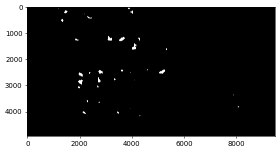

thr=0.850, fbate=0.066, precision=0.945, recall=0.033
--------- thrshold = 0.9000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


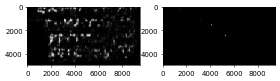

thr=0.900, precision=0.999, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


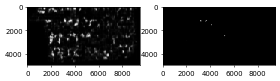

thr=0.900, precision=0.910, recall=0.003
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


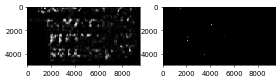

thr=0.900, precision=0.945, recall=0.002
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


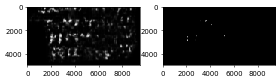

thr=0.900, precision=0.806, recall=0.004
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


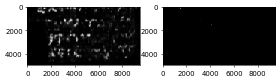

thr=0.900, precision=0.999, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


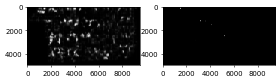

thr=0.900, precision=0.967, recall=0.002
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


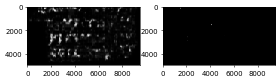

thr=0.900, precision=0.996, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


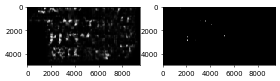

thr=0.900, precision=0.814, recall=0.004
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


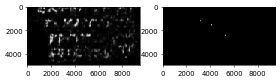

thr=0.900, precision=0.980, recall=0.002
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


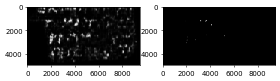

thr=0.900, precision=0.914, recall=0.004
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


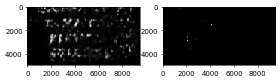

thr=0.900, precision=0.974, recall=0.003
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


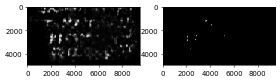

thr=0.900, precision=0.834, recall=0.005


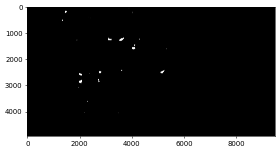

thr=0.900, fbate=0.026, precision=0.906, recall=0.011
--------- thrshold = 0.9500000000000003 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


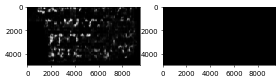

thr=0.950, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


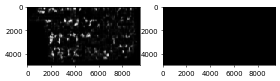

thr=0.950, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


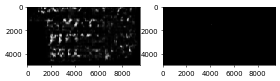

thr=0.950, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


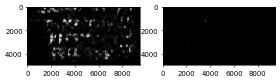

thr=0.950, precision=0.216, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


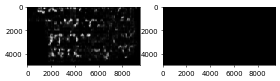

thr=0.950, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


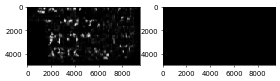

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


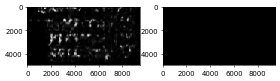

thr=0.950, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


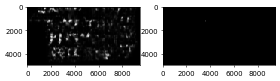

thr=0.950, precision=0.049, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


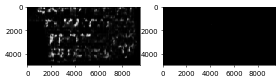

thr=0.950, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


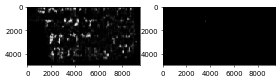

thr=0.950, precision=0.668, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


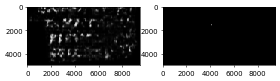

thr=0.950, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


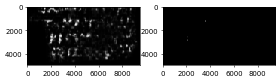

thr=0.950, precision=0.465, recall=0.000


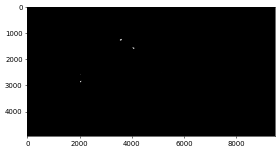

thr=0.950, fbate=0.002, precision=0.626, recall=0.001
fold =  2


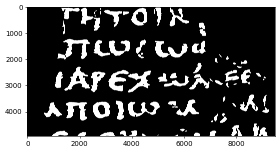

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


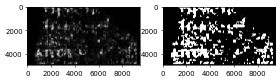

thr=0.100, precision=0.397, recall=0.584
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


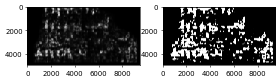

thr=0.100, precision=0.392, recall=0.516
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


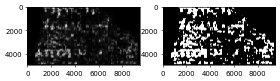

thr=0.100, precision=0.391, recall=0.578
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


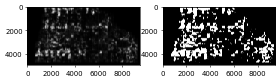

thr=0.100, precision=0.389, recall=0.509
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


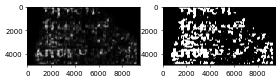

thr=0.100, precision=0.405, recall=0.600
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


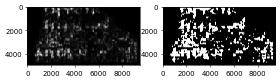

thr=0.100, precision=0.406, recall=0.541
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


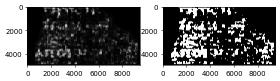

thr=0.100, precision=0.394, recall=0.595
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


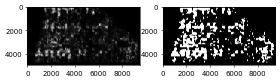

thr=0.100, precision=0.406, recall=0.546
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


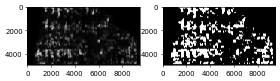

thr=0.100, precision=0.401, recall=0.578
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


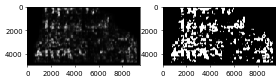

thr=0.100, precision=0.388, recall=0.511
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


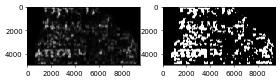

thr=0.100, precision=0.395, recall=0.576
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


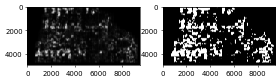

thr=0.100, precision=0.386, recall=0.500


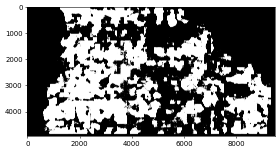

thr=0.100, fbate=0.405, precision=0.304, recall=0.794
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


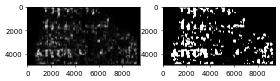

thr=0.150, precision=0.477, recall=0.476
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


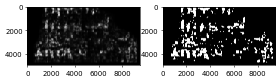

thr=0.150, precision=0.474, recall=0.424
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


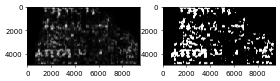

thr=0.150, precision=0.464, recall=0.461
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


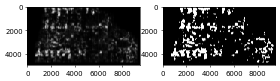

thr=0.150, precision=0.476, recall=0.412
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


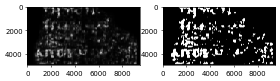

thr=0.150, precision=0.491, recall=0.489
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


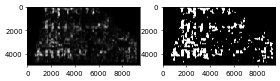

thr=0.150, precision=0.492, recall=0.444
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


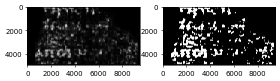

thr=0.150, precision=0.474, recall=0.485
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


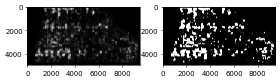

thr=0.150, precision=0.486, recall=0.433
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


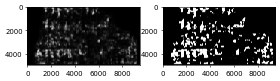

thr=0.150, precision=0.476, recall=0.466
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


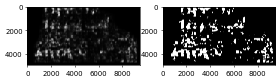

thr=0.150, precision=0.466, recall=0.410
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


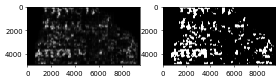

thr=0.150, precision=0.470, recall=0.450
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


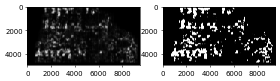

thr=0.150, precision=0.466, recall=0.400


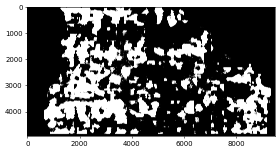

thr=0.150, fbate=0.451, precision=0.364, recall=0.686
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


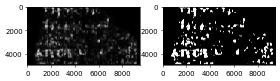

thr=0.200, precision=0.562, recall=0.399
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


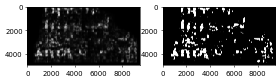

thr=0.200, precision=0.555, recall=0.356
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


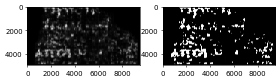

thr=0.200, precision=0.535, recall=0.377
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


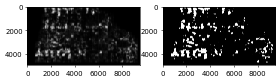

thr=0.200, precision=0.556, recall=0.339
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


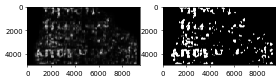

thr=0.200, precision=0.567, recall=0.405
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


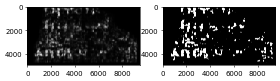

thr=0.200, precision=0.568, recall=0.370
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


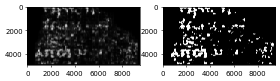

thr=0.200, precision=0.554, recall=0.399
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


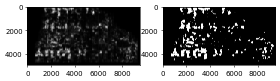

thr=0.200, precision=0.555, recall=0.353
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


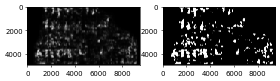

thr=0.200, precision=0.552, recall=0.384
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


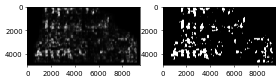

thr=0.200, precision=0.551, recall=0.338
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


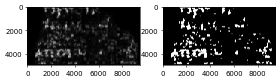

thr=0.200, precision=0.535, recall=0.362
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


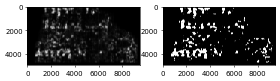

thr=0.200, precision=0.545, recall=0.327


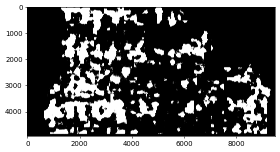

thr=0.200, fbate=0.481, precision=0.428, recall=0.596
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


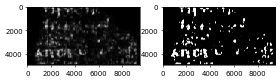

thr=0.250, precision=0.633, recall=0.339
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


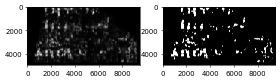

thr=0.250, precision=0.627, recall=0.300
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


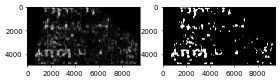

thr=0.250, precision=0.607, recall=0.314
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


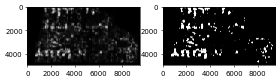

thr=0.250, precision=0.621, recall=0.285
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


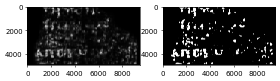

thr=0.250, precision=0.640, recall=0.344
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


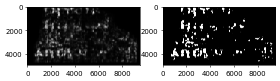

thr=0.250, precision=0.626, recall=0.308
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


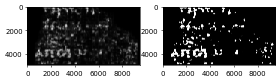

thr=0.250, precision=0.622, recall=0.337
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


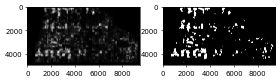

thr=0.250, precision=0.614, recall=0.293
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


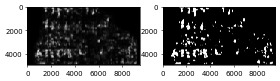

thr=0.250, precision=0.622, recall=0.321
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


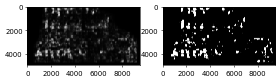

thr=0.250, precision=0.623, recall=0.285
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


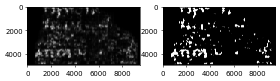

thr=0.250, precision=0.599, recall=0.297
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


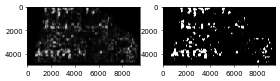

thr=0.250, precision=0.615, recall=0.274


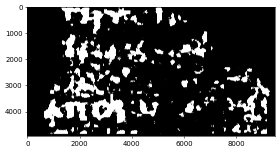

thr=0.250, fbate=0.493, precision=0.491, recall=0.521
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


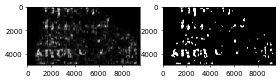

thr=0.300, precision=0.699, recall=0.279
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


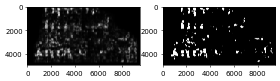

thr=0.300, precision=0.700, recall=0.245
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


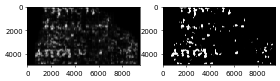

thr=0.300, precision=0.687, recall=0.258
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


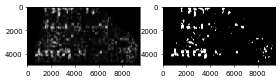

thr=0.300, precision=0.684, recall=0.235
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


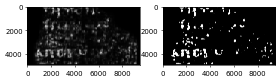

thr=0.300, precision=0.716, recall=0.284
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


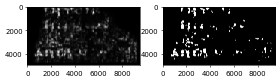

thr=0.300, precision=0.689, recall=0.250
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


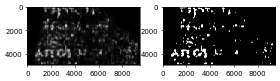

thr=0.300, precision=0.688, recall=0.278
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


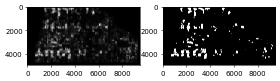

thr=0.300, precision=0.669, recall=0.240
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


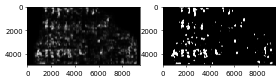

thr=0.300, precision=0.694, recall=0.264
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


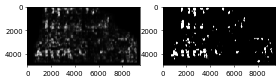

thr=0.300, precision=0.700, recall=0.239
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


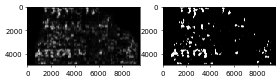

thr=0.300, precision=0.673, recall=0.241
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


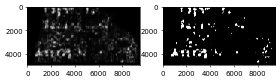

thr=0.300, precision=0.678, recall=0.227


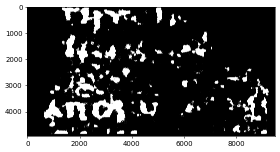

thr=0.300, fbate=0.485, precision=0.561, recall=0.445
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


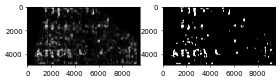

thr=0.350, precision=0.761, recall=0.226
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


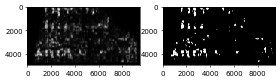

thr=0.350, precision=0.765, recall=0.199
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


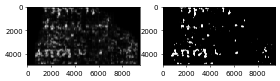

thr=0.350, precision=0.756, recall=0.208
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


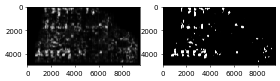

thr=0.350, precision=0.737, recall=0.189
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


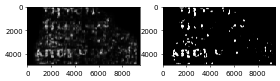

thr=0.350, precision=0.787, recall=0.232
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


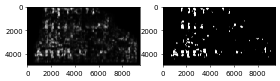

thr=0.350, precision=0.753, recall=0.200
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


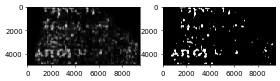

thr=0.350, precision=0.752, recall=0.224
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


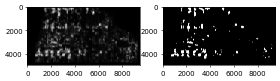

thr=0.350, precision=0.721, recall=0.194
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


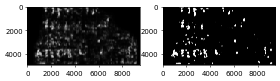

thr=0.350, precision=0.758, recall=0.216
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


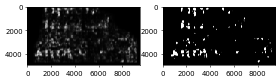

thr=0.350, precision=0.765, recall=0.196
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


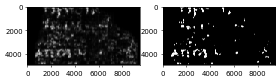

thr=0.350, precision=0.743, recall=0.195
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


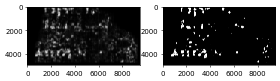

thr=0.350, precision=0.731, recall=0.186


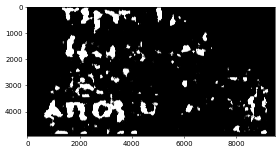

thr=0.350, fbate=0.460, precision=0.632, recall=0.378
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


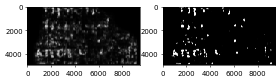

thr=0.400, precision=0.821, recall=0.178
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


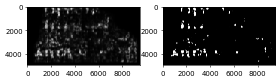

thr=0.400, precision=0.814, recall=0.157
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


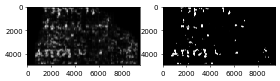

thr=0.400, precision=0.816, recall=0.163
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


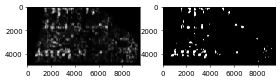

thr=0.400, precision=0.782, recall=0.148
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


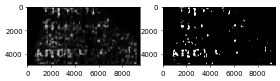

thr=0.400, precision=0.847, recall=0.183
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


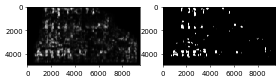

thr=0.400, precision=0.807, recall=0.157
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


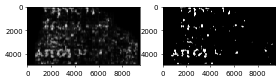

thr=0.400, precision=0.812, recall=0.174
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


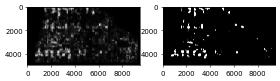

thr=0.400, precision=0.774, recall=0.152
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


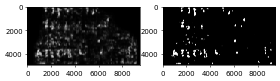

thr=0.400, precision=0.812, recall=0.173
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


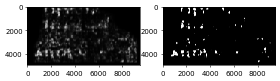

thr=0.400, precision=0.823, recall=0.155
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


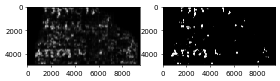

thr=0.400, precision=0.802, recall=0.153
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


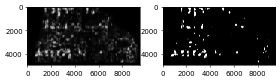

thr=0.400, precision=0.782, recall=0.148


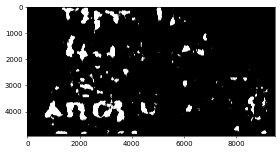

thr=0.400, fbate=0.420, precision=0.706, recall=0.315
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


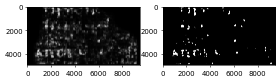

thr=0.450, precision=0.862, recall=0.138
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


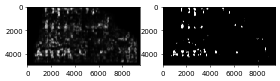

thr=0.450, precision=0.854, recall=0.122
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


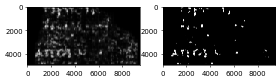

thr=0.450, precision=0.858, recall=0.125
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


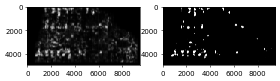

thr=0.450, precision=0.828, recall=0.116
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


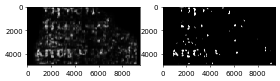

thr=0.450, precision=0.886, recall=0.140
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


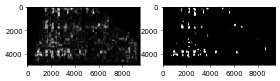

thr=0.450, precision=0.842, recall=0.122
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


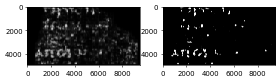

thr=0.450, precision=0.860, recall=0.132
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


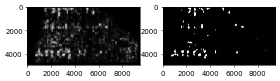

thr=0.450, precision=0.824, recall=0.118
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


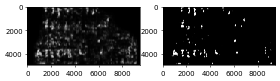

thr=0.450, precision=0.849, recall=0.134
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


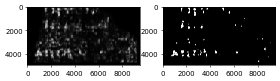

thr=0.450, precision=0.862, recall=0.122
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


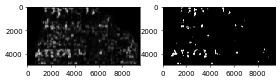

thr=0.450, precision=0.847, recall=0.119
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


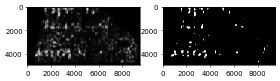

thr=0.450, precision=0.824, recall=0.116


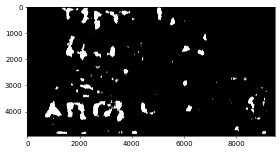

thr=0.450, fbate=0.370, precision=0.767, recall=0.261
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


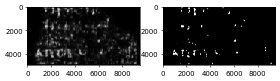

thr=0.500, precision=0.893, recall=0.100
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


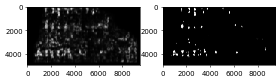

thr=0.500, precision=0.881, recall=0.087
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


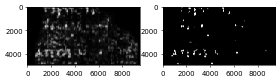

thr=0.500, precision=0.894, recall=0.088
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


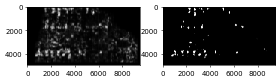

thr=0.500, precision=0.861, recall=0.085
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


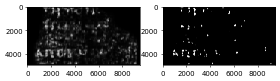

thr=0.500, precision=0.913, recall=0.098
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


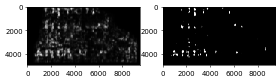

thr=0.500, precision=0.873, recall=0.085
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


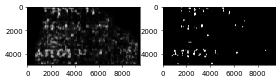

thr=0.500, precision=0.898, recall=0.092
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


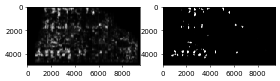

thr=0.500, precision=0.865, recall=0.087
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


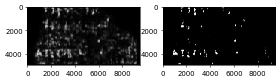

thr=0.500, precision=0.879, recall=0.095
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


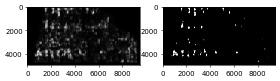

thr=0.500, precision=0.888, recall=0.090
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


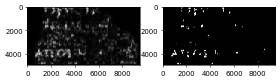

thr=0.500, precision=0.897, recall=0.087
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


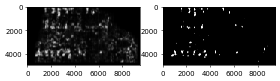

thr=0.500, precision=0.869, recall=0.086


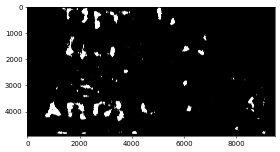

thr=0.500, fbate=0.308, precision=0.824, recall=0.205
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


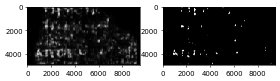

thr=0.550, precision=0.908, recall=0.066
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


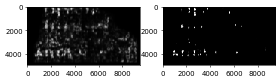

thr=0.550, precision=0.890, recall=0.056
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


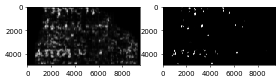

thr=0.550, precision=0.929, recall=0.057
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


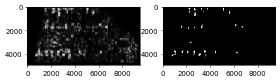

thr=0.550, precision=0.887, recall=0.058
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


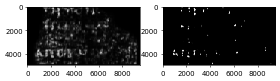

thr=0.550, precision=0.926, recall=0.063
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


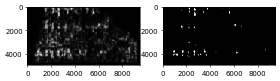

thr=0.550, precision=0.894, recall=0.055
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


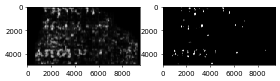

thr=0.550, precision=0.935, recall=0.058
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


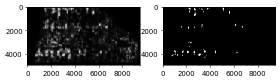

thr=0.550, precision=0.898, recall=0.059
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


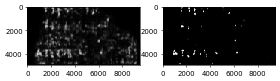

thr=0.550, precision=0.908, recall=0.064
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


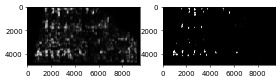

thr=0.550, precision=0.903, recall=0.061
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


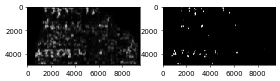

thr=0.550, precision=0.939, recall=0.058
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


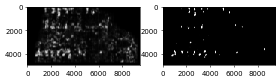

thr=0.550, precision=0.902, recall=0.059


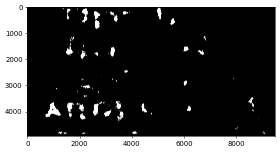

thr=0.550, fbate=0.234, precision=0.873, recall=0.152
--------- thrshold = 0.6000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


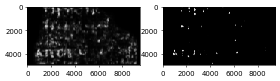

thr=0.600, precision=0.915, recall=0.039
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


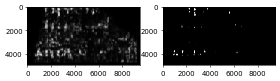

thr=0.600, precision=0.891, recall=0.034
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


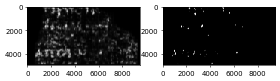

thr=0.600, precision=0.956, recall=0.033
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


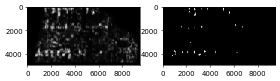

thr=0.600, precision=0.911, recall=0.036
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


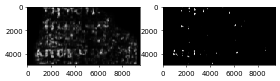

thr=0.600, precision=0.928, recall=0.037
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


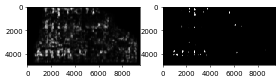

thr=0.600, precision=0.904, recall=0.033
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


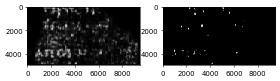

thr=0.600, precision=0.959, recall=0.033
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


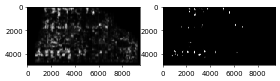

thr=0.600, precision=0.932, recall=0.037
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


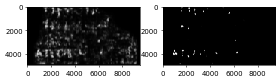

thr=0.600, precision=0.936, recall=0.040
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


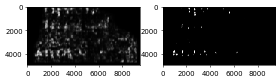

thr=0.600, precision=0.913, recall=0.036
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


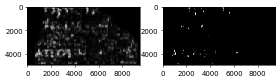

thr=0.600, precision=0.966, recall=0.033
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


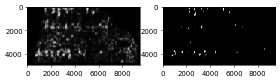

thr=0.600, precision=0.919, recall=0.036


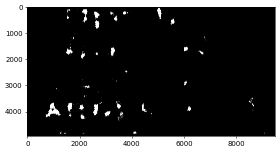

thr=0.600, fbate=0.156, precision=0.907, recall=0.105
--------- thrshold = 0.6500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


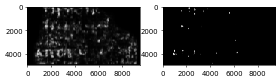

thr=0.650, precision=0.923, recall=0.022
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


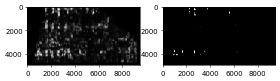

thr=0.650, precision=0.885, recall=0.019
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


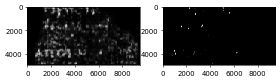

thr=0.650, precision=0.978, recall=0.018
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


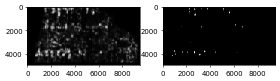

thr=0.650, precision=0.943, recall=0.020
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


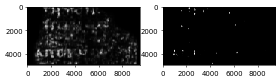

thr=0.650, precision=0.934, recall=0.020
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


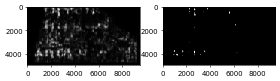

thr=0.650, precision=0.908, recall=0.018
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


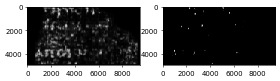

thr=0.650, precision=0.969, recall=0.017
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


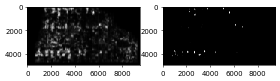

thr=0.650, precision=0.955, recall=0.021
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


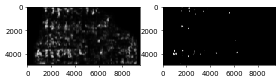

thr=0.650, precision=0.967, recall=0.023
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


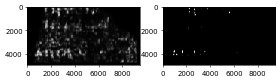

thr=0.650, precision=0.915, recall=0.019
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


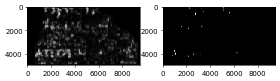

thr=0.650, precision=0.986, recall=0.018
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


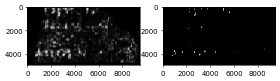

thr=0.650, precision=0.928, recall=0.020


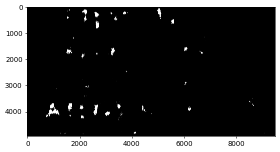

thr=0.650, fbate=0.090, precision=0.927, recall=0.067
--------- thrshold = 0.7000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


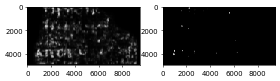

thr=0.700, precision=0.951, recall=0.010
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


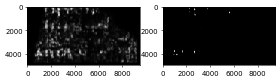

thr=0.700, precision=0.853, recall=0.009
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


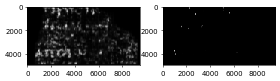

thr=0.700, precision=0.988, recall=0.008
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


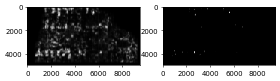

thr=0.700, precision=0.964, recall=0.007
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


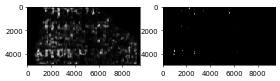

thr=0.700, precision=0.954, recall=0.009
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


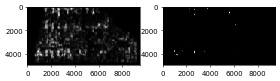

thr=0.700, precision=0.916, recall=0.008
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


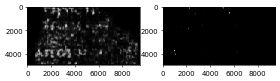

thr=0.700, precision=0.984, recall=0.007
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


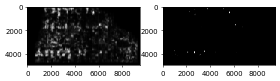

thr=0.700, precision=0.972, recall=0.008
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


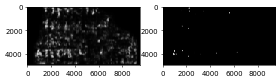

thr=0.700, precision=0.990, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


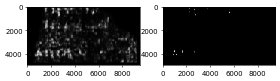

thr=0.700, precision=0.907, recall=0.008
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


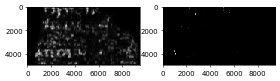

thr=0.700, precision=0.994, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


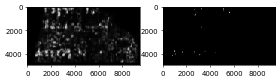

thr=0.700, precision=0.945, recall=0.008


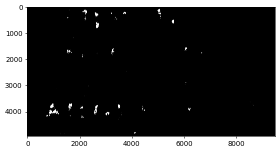

thr=0.700, fbate=0.037, precision=0.939, recall=0.035
--------- thrshold = 0.7500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


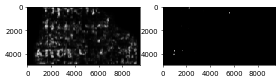

thr=0.750, precision=0.988, recall=0.003
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


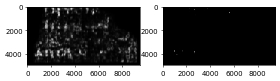

thr=0.750, precision=0.807, recall=0.002
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


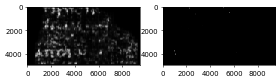

thr=0.750, precision=0.996, recall=0.002
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


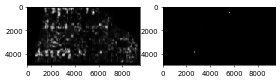

thr=0.750, precision=0.989, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


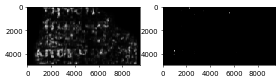

thr=0.750, precision=0.985, recall=0.002
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


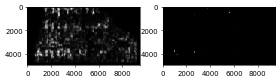

thr=0.750, precision=0.951, recall=0.003
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


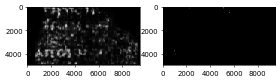

thr=0.750, precision=0.992, recall=0.002
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


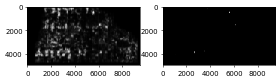

thr=0.750, precision=0.991, recall=0.002
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


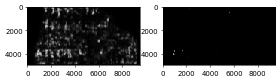

thr=0.750, precision=0.997, recall=0.003
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


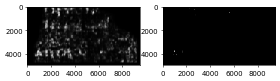

thr=0.750, precision=0.878, recall=0.002
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


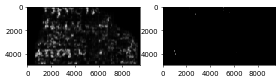

thr=0.750, precision=0.998, recall=0.002
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


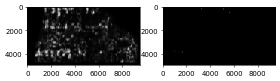

thr=0.750, precision=0.963, recall=0.001


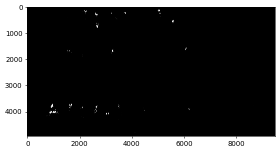

thr=0.750, fbate=0.007, precision=0.942, recall=0.011
--------- thrshold = 0.8000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


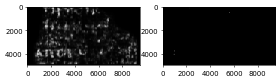

thr=0.800, precision=0.999, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


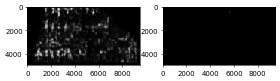

thr=0.800, precision=0.955, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


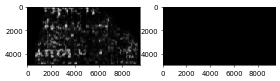

thr=0.800, precision=0.998, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


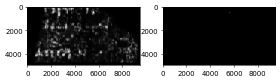

thr=0.800, precision=0.998, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


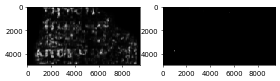

thr=0.800, precision=0.999, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


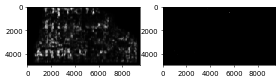

thr=0.800, precision=0.999, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


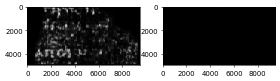

thr=0.800, precision=0.995, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


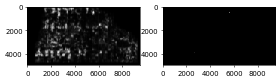

thr=0.800, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


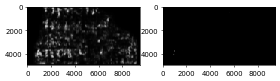

thr=0.800, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


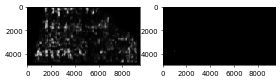

thr=0.800, precision=0.941, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


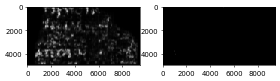

thr=0.800, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


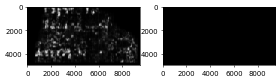

thr=0.800, precision=0.987, recall=0.000


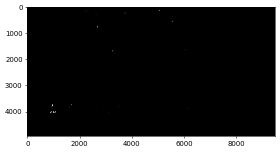

thr=0.800, fbate=0.000, precision=0.990, recall=0.002
--------- thrshold = 0.8500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


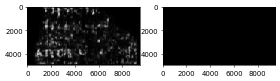

thr=0.850, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


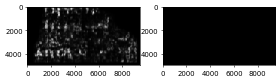

thr=0.850, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


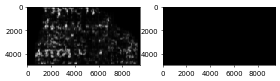

thr=0.850, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


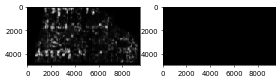

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.850, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


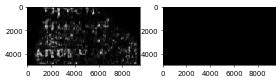

thr=0.850, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


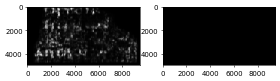

thr=0.850, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


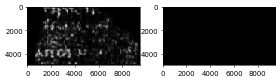

thr=0.850, precision=0.933, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


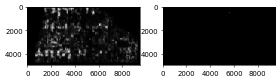

thr=0.850, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


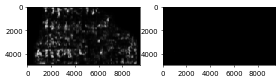

thr=0.850, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


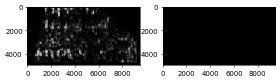

thr=0.850, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


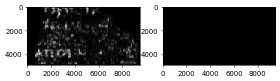

thr=0.850, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


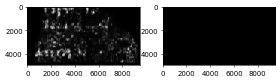

thr=0.850, precision=1.000, recall=0.000


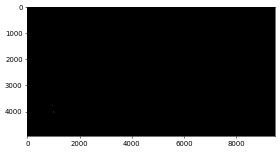

thr=0.850, fbate=0.000, precision=0.999, recall=0.000
--------- thrshold = 0.9000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


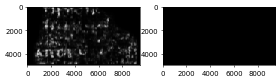

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


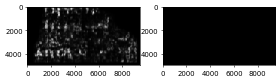

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


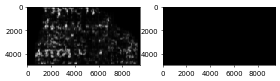

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


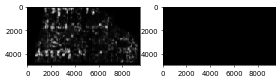

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


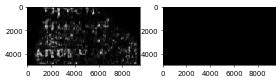

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


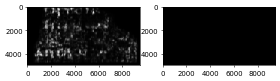

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


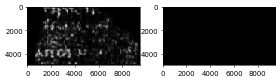

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


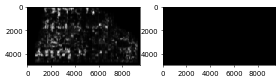

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


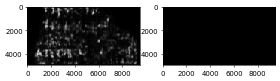

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


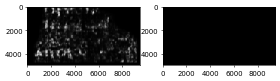

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


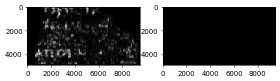

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


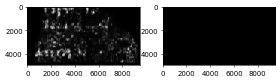

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000


/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


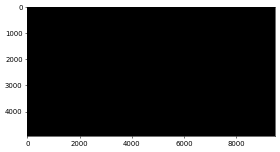

thr=0.900, fbate=0.000, precision=0.000, recall=0.000
--------- thrshold = 0.9500000000000003 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


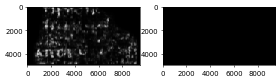

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


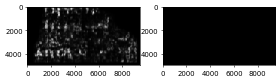

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


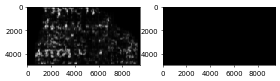

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


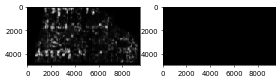

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


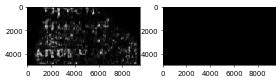

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


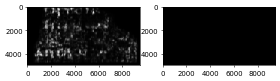

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


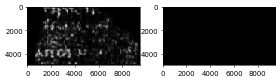

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


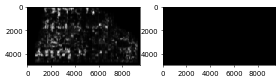

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


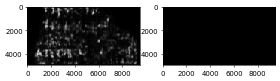

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


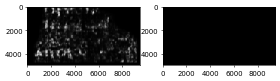

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


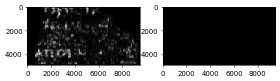

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


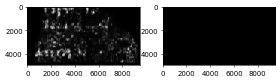

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000


/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


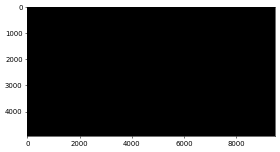

thr=0.950, fbate=0.000, precision=0.000, recall=0.000
fold =  3


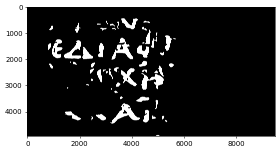

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


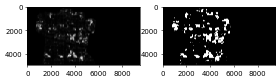

thr=0.100, precision=0.474, recall=0.530
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


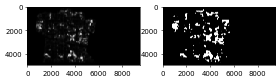

thr=0.100, precision=0.477, recall=0.514
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


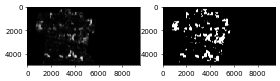

thr=0.100, precision=0.485, recall=0.521
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


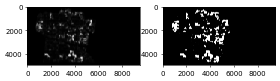

thr=0.100, precision=0.468, recall=0.505
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


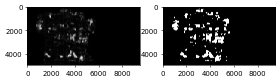

thr=0.100, precision=0.461, recall=0.531
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


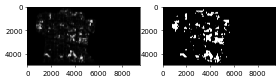

thr=0.100, precision=0.465, recall=0.496
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


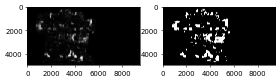

thr=0.100, precision=0.480, recall=0.520
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


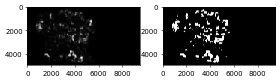

thr=0.100, precision=0.458, recall=0.492
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


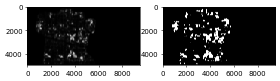

thr=0.100, precision=0.457, recall=0.499
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


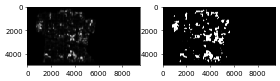

thr=0.100, precision=0.475, recall=0.492
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


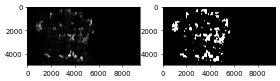

thr=0.100, precision=0.472, recall=0.506
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


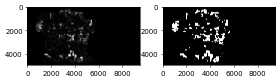

thr=0.100, precision=0.470, recall=0.491


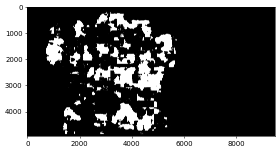

thr=0.100, fbate=0.474, precision=0.346, recall=0.711
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


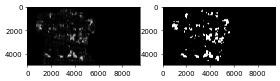

thr=0.150, precision=0.557, recall=0.431
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


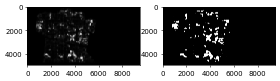

thr=0.150, precision=0.559, recall=0.419
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


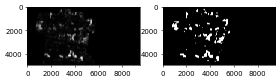

thr=0.150, precision=0.574, recall=0.420
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


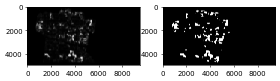

thr=0.150, precision=0.547, recall=0.404
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


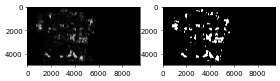

thr=0.150, precision=0.542, recall=0.445
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


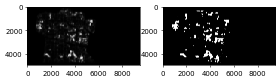

thr=0.150, precision=0.549, recall=0.406
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


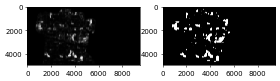

thr=0.150, precision=0.565, recall=0.418
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


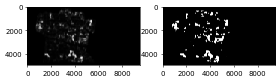

thr=0.150, precision=0.551, recall=0.395
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


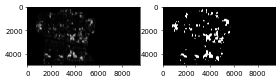

thr=0.150, precision=0.543, recall=0.411
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


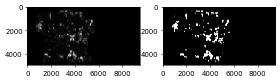

thr=0.150, precision=0.563, recall=0.403
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


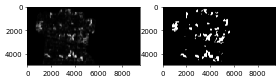

thr=0.150, precision=0.550, recall=0.407
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


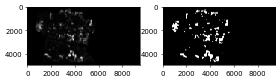

thr=0.150, precision=0.563, recall=0.401


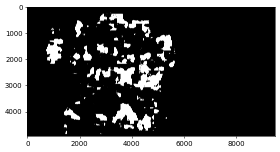

thr=0.150, fbate=0.521, precision=0.420, recall=0.619
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


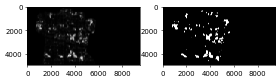

thr=0.200, precision=0.620, recall=0.361
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


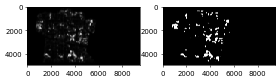

thr=0.200, precision=0.620, recall=0.348
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


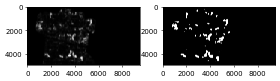

thr=0.200, precision=0.631, recall=0.349
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


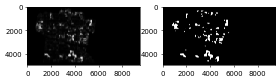

thr=0.200, precision=0.608, recall=0.333
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


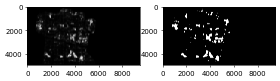

thr=0.200, precision=0.612, recall=0.374
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


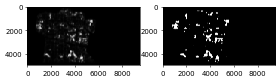

thr=0.200, precision=0.612, recall=0.337
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


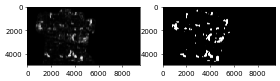

thr=0.200, precision=0.621, recall=0.347
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


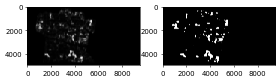

thr=0.200, precision=0.621, recall=0.326
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


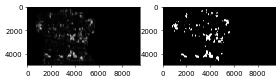

thr=0.200, precision=0.606, recall=0.344
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


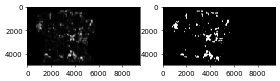

thr=0.200, precision=0.626, recall=0.334
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


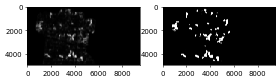

thr=0.200, precision=0.617, recall=0.335
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


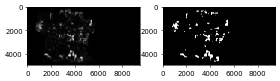

thr=0.200, precision=0.638, recall=0.338


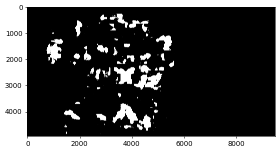

thr=0.200, fbate=0.542, precision=0.486, recall=0.543
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


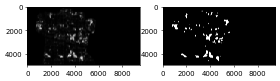

thr=0.250, precision=0.667, recall=0.308
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


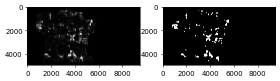

thr=0.250, precision=0.667, recall=0.292
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


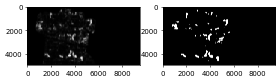

thr=0.250, precision=0.668, recall=0.292
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


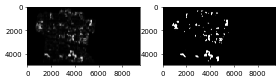

thr=0.250, precision=0.662, recall=0.283
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


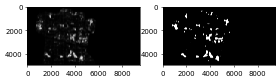

thr=0.250, precision=0.667, recall=0.313
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


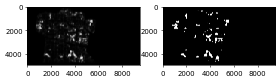

thr=0.250, precision=0.661, recall=0.288
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


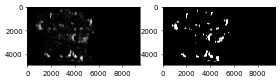

thr=0.250, precision=0.663, recall=0.297
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


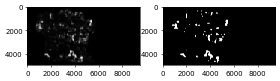

thr=0.250, precision=0.665, recall=0.282
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


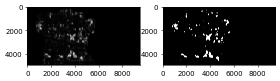

thr=0.250, precision=0.660, recall=0.289
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


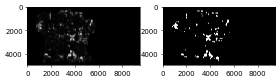

thr=0.250, precision=0.669, recall=0.280
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


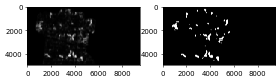

thr=0.250, precision=0.671, recall=0.282
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


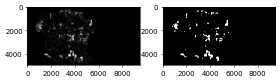

thr=0.250, precision=0.688, recall=0.282


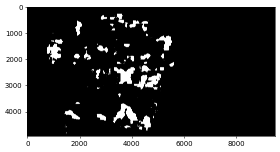

thr=0.250, fbate=0.534, precision=0.542, recall=0.479
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


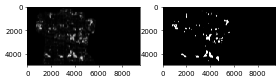

thr=0.300, precision=0.712, recall=0.256
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


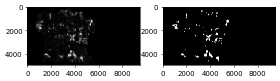

thr=0.300, precision=0.713, recall=0.239
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


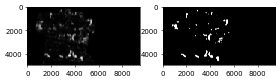

thr=0.300, precision=0.706, recall=0.240
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


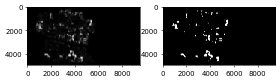

thr=0.300, precision=0.706, recall=0.239
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


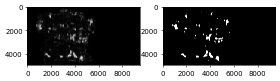

thr=0.300, precision=0.716, recall=0.259
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


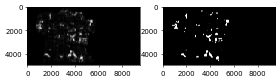

thr=0.300, precision=0.712, recall=0.245
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


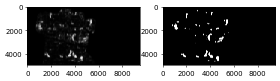

thr=0.300, precision=0.711, recall=0.253
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


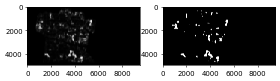

thr=0.300, precision=0.708, recall=0.243
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


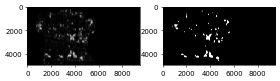

thr=0.300, precision=0.716, recall=0.240
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


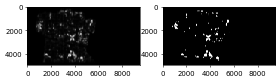

thr=0.300, precision=0.711, recall=0.229
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


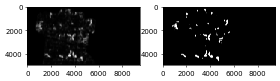

thr=0.300, precision=0.718, recall=0.228
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


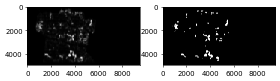

thr=0.300, precision=0.726, recall=0.228


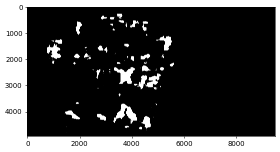

thr=0.300, fbate=0.505, precision=0.588, recall=0.415
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


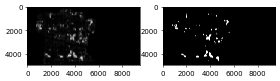

thr=0.350, precision=0.758, recall=0.209
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


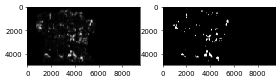

thr=0.350, precision=0.746, recall=0.190
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


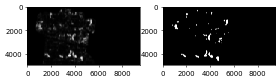

thr=0.350, precision=0.755, recall=0.200
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


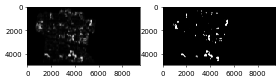

thr=0.350, precision=0.757, recall=0.199
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


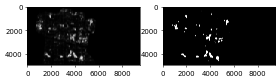

thr=0.350, precision=0.761, recall=0.217
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


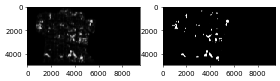

thr=0.350, precision=0.757, recall=0.208
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


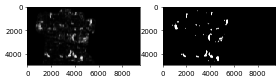

thr=0.350, precision=0.759, recall=0.214
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


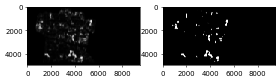

thr=0.350, precision=0.752, recall=0.208
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


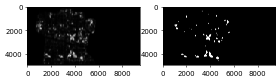

thr=0.350, precision=0.767, recall=0.194
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


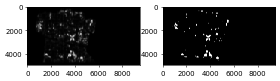

thr=0.350, precision=0.756, recall=0.186
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


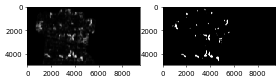

thr=0.350, precision=0.766, recall=0.184
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


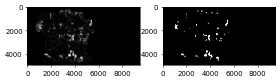

thr=0.350, precision=0.765, recall=0.181


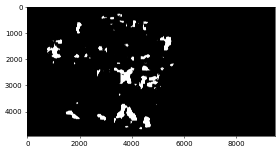

thr=0.350, fbate=0.465, precision=0.634, recall=0.357
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


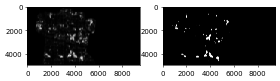

thr=0.400, precision=0.802, recall=0.167
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


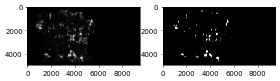

thr=0.400, precision=0.773, recall=0.150
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


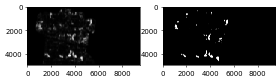

thr=0.400, precision=0.807, recall=0.166
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


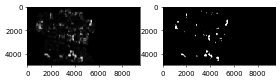

thr=0.400, precision=0.804, recall=0.164
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


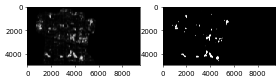

thr=0.400, precision=0.796, recall=0.181
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


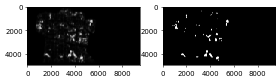

thr=0.400, precision=0.795, recall=0.173
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


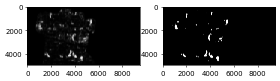

thr=0.400, precision=0.806, recall=0.180
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


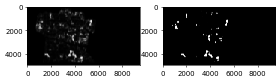

thr=0.400, precision=0.797, recall=0.176
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


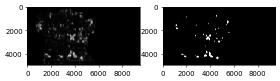

thr=0.400, precision=0.816, recall=0.154
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


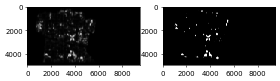

thr=0.400, precision=0.787, recall=0.150
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


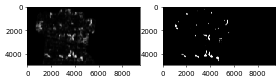

thr=0.400, precision=0.821, recall=0.148
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


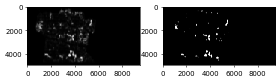

thr=0.400, precision=0.808, recall=0.142


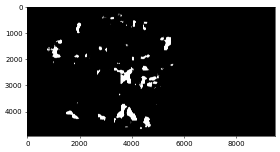

thr=0.400, fbate=0.417, precision=0.679, recall=0.308
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


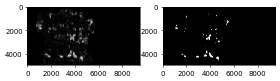

thr=0.450, precision=0.833, recall=0.135
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


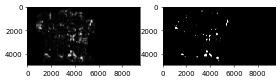

thr=0.450, precision=0.795, recall=0.122
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


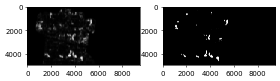

thr=0.450, precision=0.845, recall=0.138
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


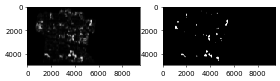

thr=0.450, precision=0.838, recall=0.135
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


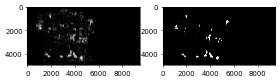

thr=0.450, precision=0.830, recall=0.151
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


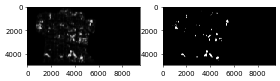

thr=0.450, precision=0.825, recall=0.144
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


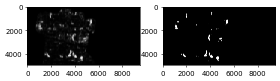

thr=0.450, precision=0.854, recall=0.154
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


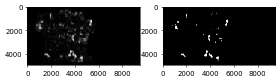

thr=0.450, precision=0.845, recall=0.150
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


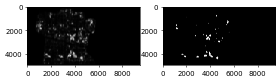

thr=0.450, precision=0.847, recall=0.121
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


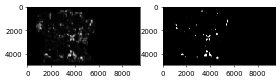

thr=0.450, precision=0.805, recall=0.121
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


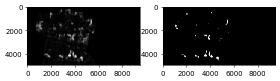

thr=0.450, precision=0.868, recall=0.118
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


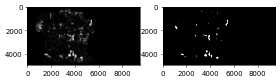

thr=0.450, precision=0.854, recall=0.115


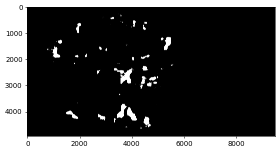

thr=0.450, fbate=0.374, precision=0.720, recall=0.267
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


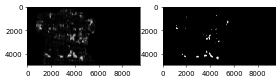

thr=0.500, precision=0.851, recall=0.101
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


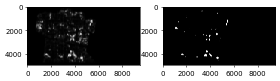

thr=0.500, precision=0.813, recall=0.098
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


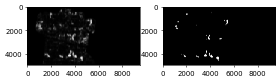

thr=0.500, precision=0.885, recall=0.111
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


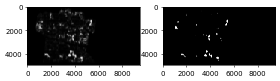

thr=0.500, precision=0.875, recall=0.108
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


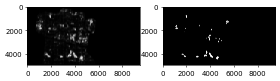

thr=0.500, precision=0.867, recall=0.120
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


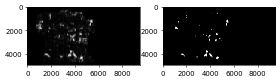

thr=0.500, precision=0.852, recall=0.117
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


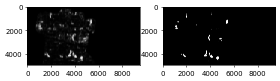

thr=0.500, precision=0.890, recall=0.127
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


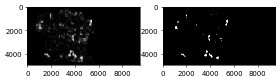

thr=0.500, precision=0.894, recall=0.124
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


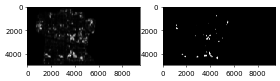

thr=0.500, precision=0.879, recall=0.091
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


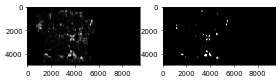

thr=0.500, precision=0.821, recall=0.094
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


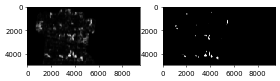

thr=0.500, precision=0.898, recall=0.089
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


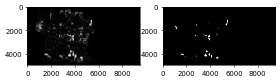

thr=0.500, precision=0.895, recall=0.092


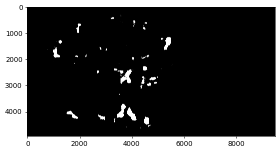

thr=0.500, fbate=0.327, precision=0.764, recall=0.223
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


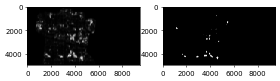

thr=0.550, precision=0.869, recall=0.074
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


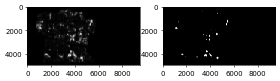

thr=0.550, precision=0.838, recall=0.078
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


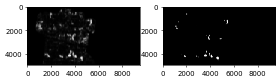

thr=0.550, precision=0.912, recall=0.086
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


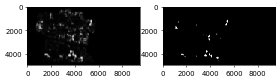

thr=0.550, precision=0.915, recall=0.087
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


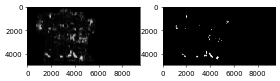

thr=0.550, precision=0.894, recall=0.093
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


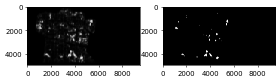

thr=0.550, precision=0.876, recall=0.094
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


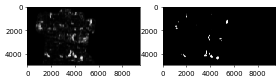

thr=0.550, precision=0.915, recall=0.103
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


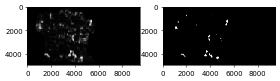

thr=0.550, precision=0.922, recall=0.100
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


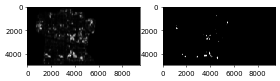

thr=0.550, precision=0.912, recall=0.065
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


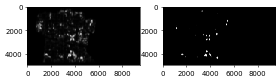

thr=0.550, precision=0.835, recall=0.071
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


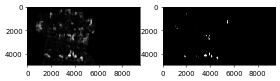

thr=0.550, precision=0.931, recall=0.064
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


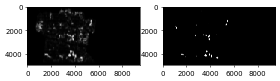

thr=0.550, precision=0.930, recall=0.073


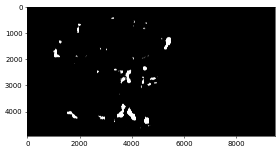

thr=0.550, fbate=0.278, precision=0.808, recall=0.183
--------- thrshold = 0.6000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


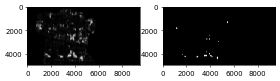

thr=0.600, precision=0.899, recall=0.053
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


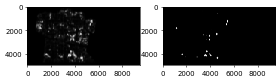

thr=0.600, precision=0.871, recall=0.060
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


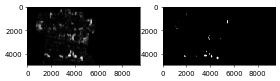

thr=0.600, precision=0.933, recall=0.061
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


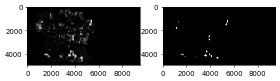

thr=0.600, precision=0.944, recall=0.068
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


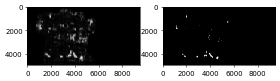

thr=0.600, precision=0.918, recall=0.066
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


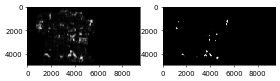

thr=0.600, precision=0.897, recall=0.071
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


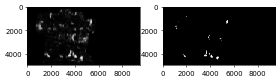

thr=0.600, precision=0.935, recall=0.079
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


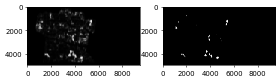

thr=0.600, precision=0.939, recall=0.078
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


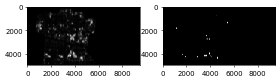

thr=0.600, precision=0.943, recall=0.044
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


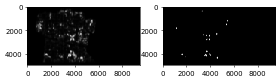

thr=0.600, precision=0.850, recall=0.051
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


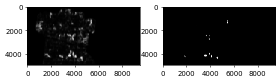

thr=0.600, precision=0.967, recall=0.045
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


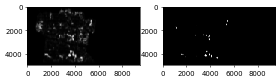

thr=0.600, precision=0.956, recall=0.054


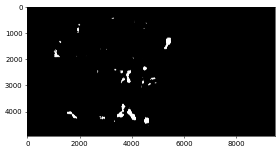

thr=0.600, fbate=0.221, precision=0.852, recall=0.146
--------- thrshold = 0.6500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


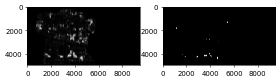

thr=0.650, precision=0.931, recall=0.036
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


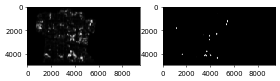

thr=0.650, precision=0.885, recall=0.044
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


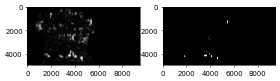

thr=0.650, precision=0.952, recall=0.043
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


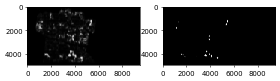

thr=0.650, precision=0.955, recall=0.051
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


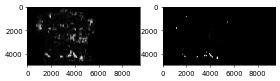

thr=0.650, precision=0.948, recall=0.046
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


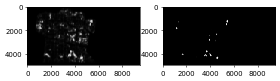

thr=0.650, precision=0.915, recall=0.052
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


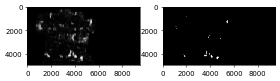

thr=0.650, precision=0.948, recall=0.059
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


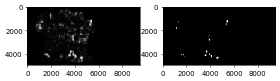

thr=0.650, precision=0.948, recall=0.058
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


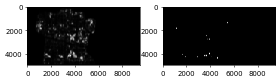

thr=0.650, precision=0.966, recall=0.030
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


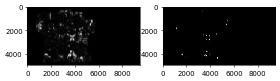

thr=0.650, precision=0.886, recall=0.035
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


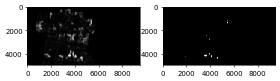

thr=0.650, precision=0.984, recall=0.032
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


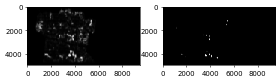

thr=0.650, precision=0.972, recall=0.037


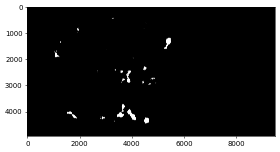

thr=0.650, fbate=0.160, precision=0.888, recall=0.113
--------- thrshold = 0.7000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


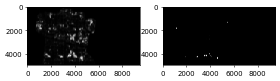

thr=0.700, precision=0.974, recall=0.020
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


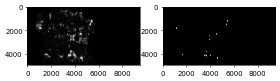

thr=0.700, precision=0.891, recall=0.027
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


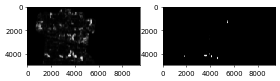

thr=0.700, precision=0.964, recall=0.029
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


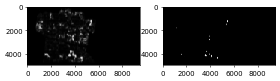

thr=0.700, precision=0.960, recall=0.033
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


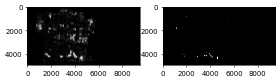

thr=0.700, precision=0.968, recall=0.028
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


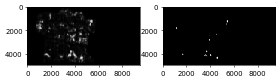

thr=0.700, precision=0.940, recall=0.034
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


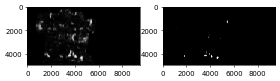

thr=0.700, precision=0.956, recall=0.040
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


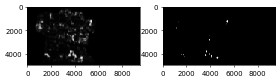

thr=0.700, precision=0.953, recall=0.038
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


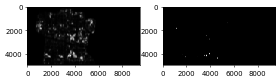

thr=0.700, precision=0.987, recall=0.016
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


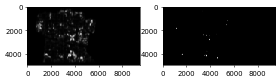

thr=0.700, precision=0.954, recall=0.019
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


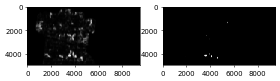

thr=0.700, precision=0.997, recall=0.021
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


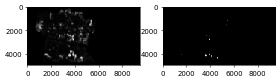

thr=0.700, precision=0.989, recall=0.021


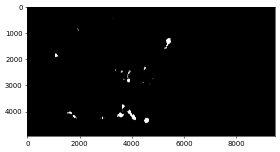

thr=0.700, fbate=0.098, precision=0.926, recall=0.080
--------- thrshold = 0.7500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


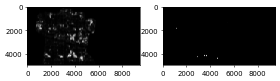

thr=0.750, precision=0.994, recall=0.010
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


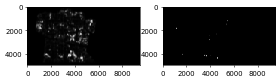

thr=0.750, precision=0.921, recall=0.012
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


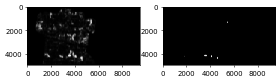

thr=0.750, precision=0.977, recall=0.018
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


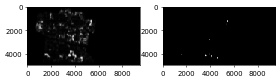

thr=0.750, precision=0.970, recall=0.016
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


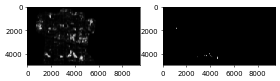

thr=0.750, precision=0.980, recall=0.013
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


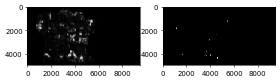

thr=0.750, precision=0.954, recall=0.017
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


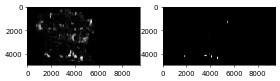

thr=0.750, precision=0.962, recall=0.026
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


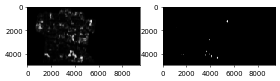

thr=0.750, precision=0.949, recall=0.022
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


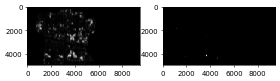

thr=0.750, precision=0.999, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


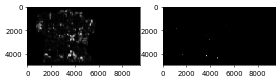

thr=0.750, precision=0.959, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


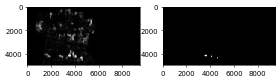

thr=0.750, precision=1.000, recall=0.013
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


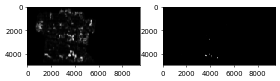

thr=0.750, precision=0.999, recall=0.010


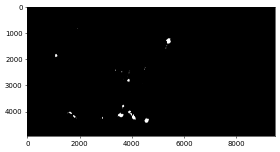

thr=0.750, fbate=0.048, precision=0.953, recall=0.049
--------- thrshold = 0.8000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


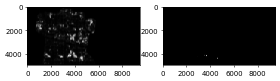

thr=0.800, precision=0.997, recall=0.004
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


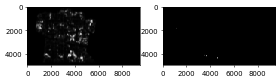

thr=0.800, precision=0.944, recall=0.004
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


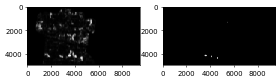

thr=0.800, precision=0.981, recall=0.011
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


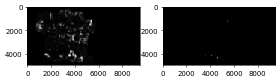

thr=0.800, precision=0.997, recall=0.005
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


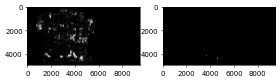

thr=0.800, precision=0.995, recall=0.004
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


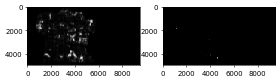

thr=0.800, precision=0.935, recall=0.005
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


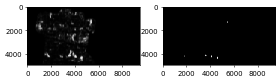

thr=0.800, precision=0.976, recall=0.014
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


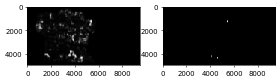

thr=0.800, precision=0.956, recall=0.011
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


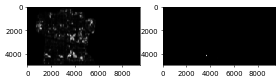

thr=0.800, precision=1.000, recall=0.003
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


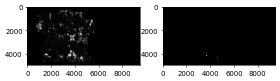

thr=0.800, precision=0.982, recall=0.003
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


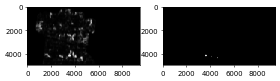

thr=0.800, precision=1.000, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


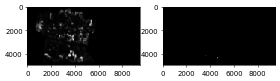

thr=0.800, precision=1.000, recall=0.002


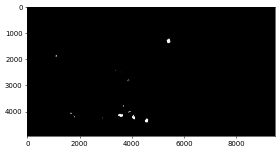

thr=0.800, fbate=0.010, precision=0.968, recall=0.026
--------- thrshold = 0.8500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


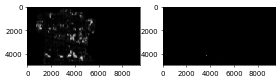

thr=0.850, precision=1.000, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


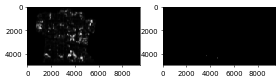

thr=0.850, precision=0.992, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


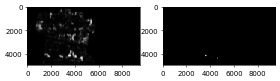

thr=0.850, precision=1.000, recall=0.004
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


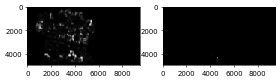

thr=0.850, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


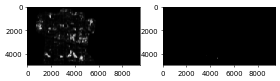

thr=0.850, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


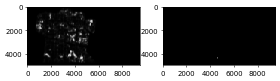

thr=0.850, precision=0.975, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


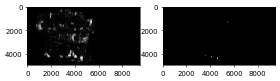

thr=0.850, precision=0.979, recall=0.005
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


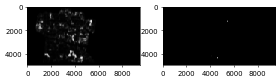

thr=0.850, precision=0.994, recall=0.004
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


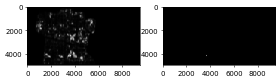

thr=0.850, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


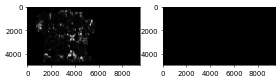

thr=0.850, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


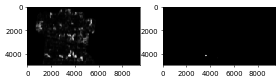

thr=0.850, precision=1.000, recall=0.003
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


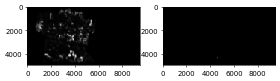

thr=0.850, precision=1.000, recall=0.000


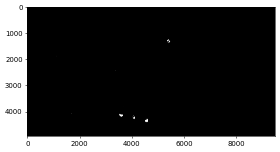

thr=0.850, fbate=0.001, precision=0.987, recall=0.011
--------- thrshold = 0.9000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


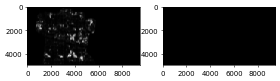

thr=0.900, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


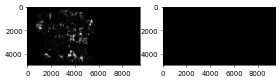

thr=0.900, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


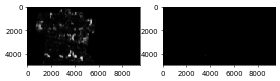

thr=0.900, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


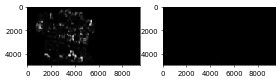

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


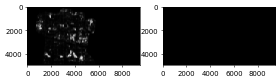

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


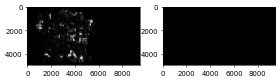

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


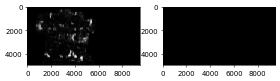

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


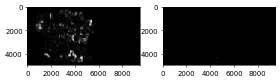

thr=0.900, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


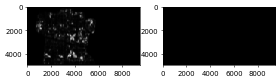

thr=0.900, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


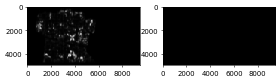

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


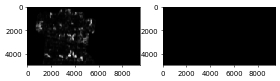

thr=0.900, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


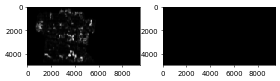

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.900, precision=0.000, recall=0.000


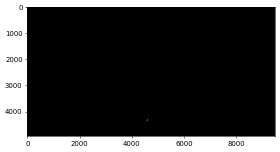

thr=0.900, fbate=0.000, precision=1.000, recall=0.000
--------- thrshold = 0.9500000000000003 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


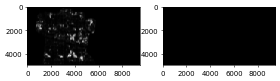

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


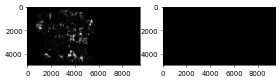

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


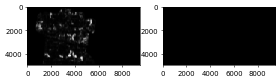

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


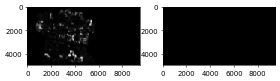

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


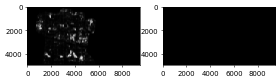

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


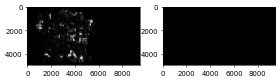

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


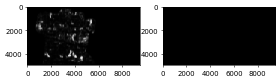

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


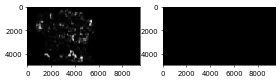

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


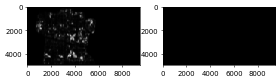

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


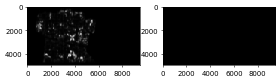

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


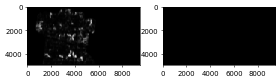

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


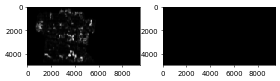

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000


/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


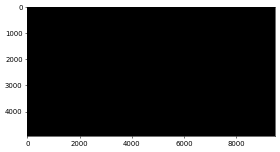

thr=0.950, fbate=0.000, precision=0.000, recall=0.000
fold =  4


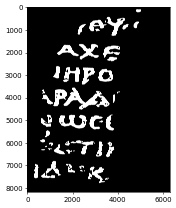

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


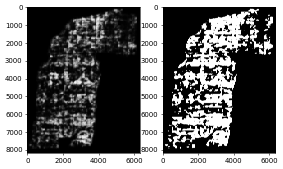

thr=0.100, precision=0.308, recall=0.837
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


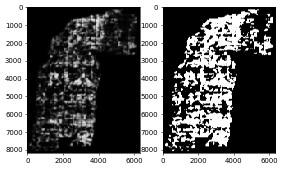

thr=0.100, precision=0.307, recall=0.833
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


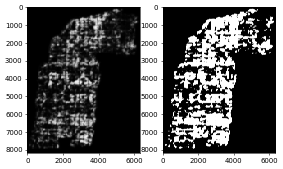

thr=0.100, precision=0.314, recall=0.841
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


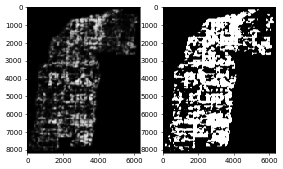

thr=0.100, precision=0.312, recall=0.842
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


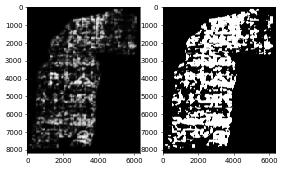

thr=0.100, precision=0.316, recall=0.840
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


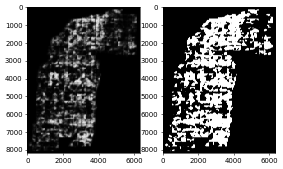

thr=0.100, precision=0.316, recall=0.844
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


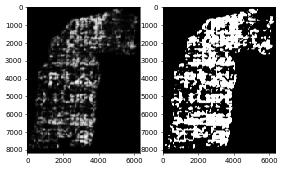

thr=0.100, precision=0.323, recall=0.848
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


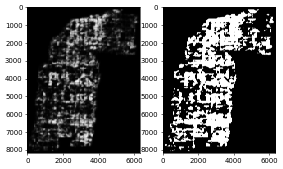

thr=0.100, precision=0.320, recall=0.844
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


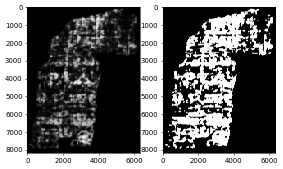

thr=0.100, precision=0.297, recall=0.853
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


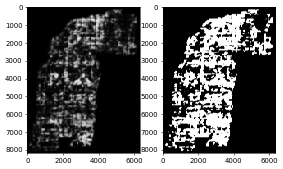

thr=0.100, precision=0.292, recall=0.845
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


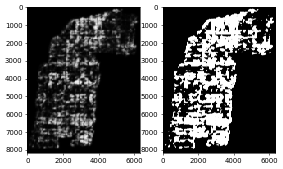

thr=0.100, precision=0.299, recall=0.845
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


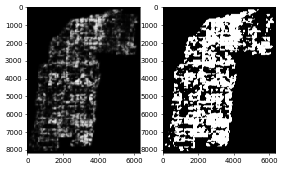

thr=0.100, precision=0.295, recall=0.844


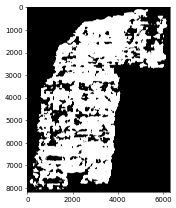

thr=0.100, fbate=0.339, precision=0.249, recall=0.956
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


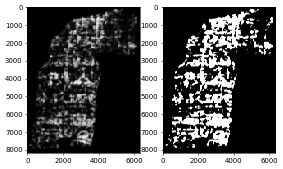

thr=0.150, precision=0.350, recall=0.759
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


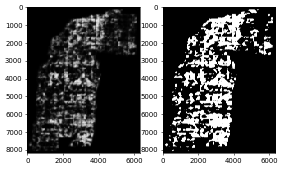

thr=0.150, precision=0.347, recall=0.750
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


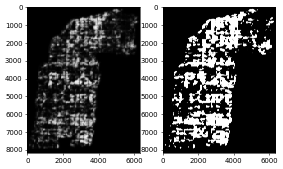

thr=0.150, precision=0.351, recall=0.762
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


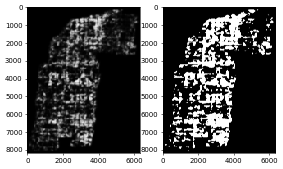

thr=0.150, precision=0.350, recall=0.750
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


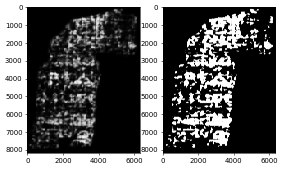

thr=0.150, precision=0.360, recall=0.760
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


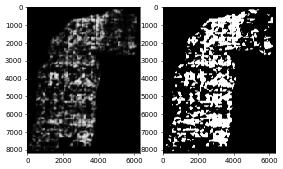

thr=0.150, precision=0.356, recall=0.758
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


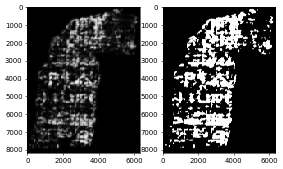

thr=0.150, precision=0.363, recall=0.767
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


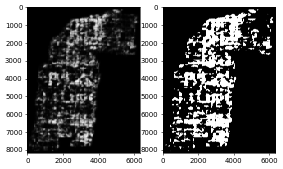

thr=0.150, precision=0.360, recall=0.762
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


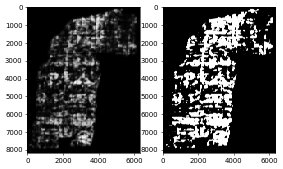

thr=0.150, precision=0.337, recall=0.771
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


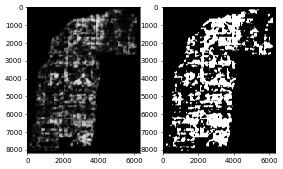

thr=0.150, precision=0.333, recall=0.762
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


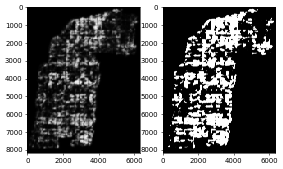

thr=0.150, precision=0.335, recall=0.765
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


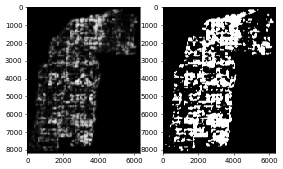

thr=0.150, precision=0.329, recall=0.752


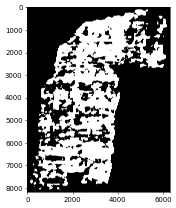

thr=0.150, fbate=0.371, precision=0.281, recall=0.918
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


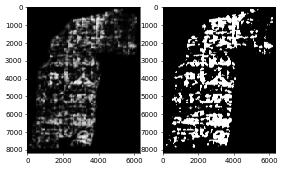

thr=0.200, precision=0.386, recall=0.686
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


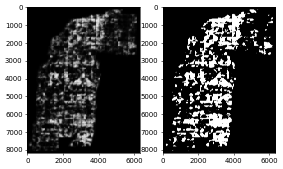

thr=0.200, precision=0.382, recall=0.678
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


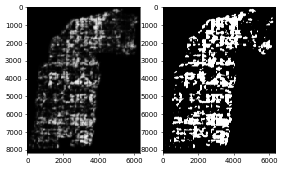

thr=0.200, precision=0.381, recall=0.690
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


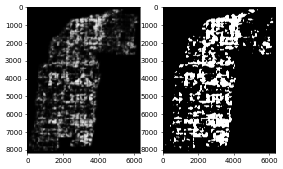

thr=0.200, precision=0.381, recall=0.669
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


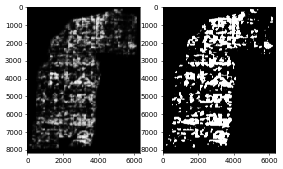

thr=0.200, precision=0.396, recall=0.685
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


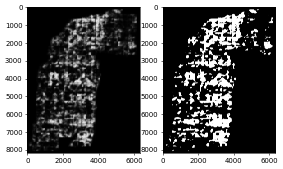

thr=0.200, precision=0.394, recall=0.689
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


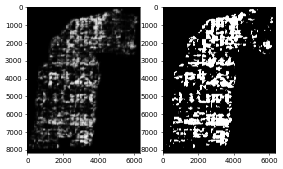

thr=0.200, precision=0.395, recall=0.690
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


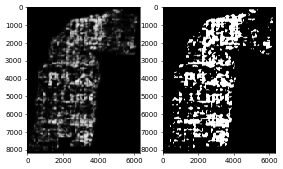

thr=0.200, precision=0.395, recall=0.689
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


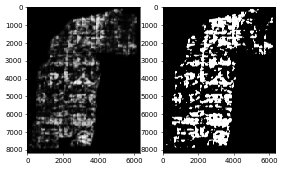

thr=0.200, precision=0.372, recall=0.695
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


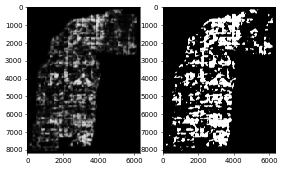

thr=0.200, precision=0.367, recall=0.687
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


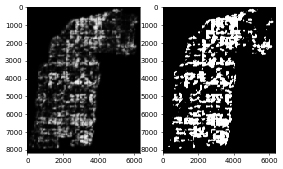

thr=0.200, precision=0.365, recall=0.692
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


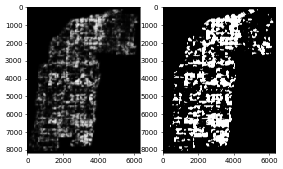

thr=0.200, precision=0.361, recall=0.674


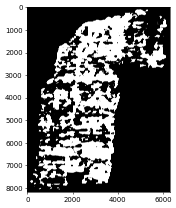

thr=0.200, fbate=0.398, precision=0.309, recall=0.869
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


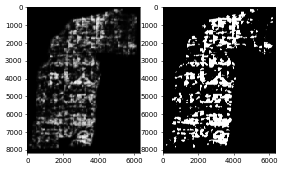

thr=0.250, precision=0.415, recall=0.624
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


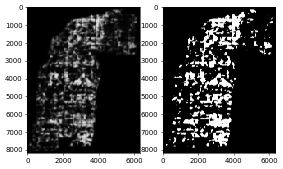

thr=0.250, precision=0.414, recall=0.619
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


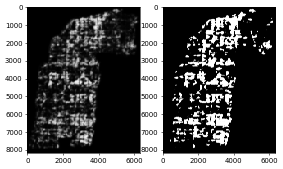

thr=0.250, precision=0.407, recall=0.629
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


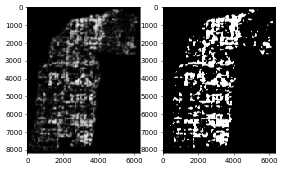

thr=0.250, precision=0.409, recall=0.611
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


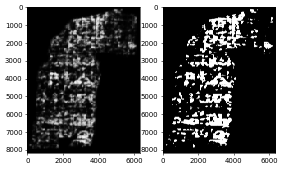

thr=0.250, precision=0.424, recall=0.624
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


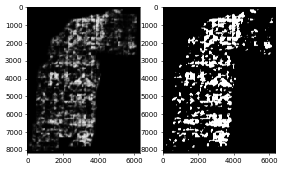

thr=0.250, precision=0.427, recall=0.631
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


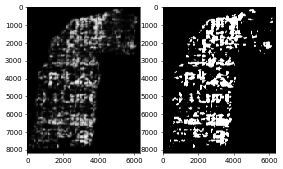

thr=0.250, precision=0.422, recall=0.627
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


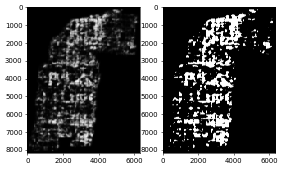

thr=0.250, precision=0.424, recall=0.629
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


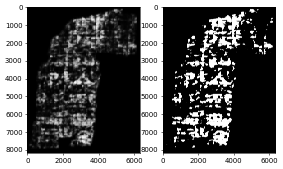

thr=0.250, precision=0.402, recall=0.630
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


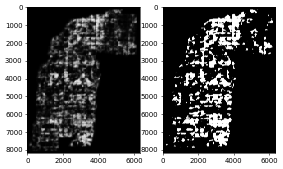

thr=0.250, precision=0.396, recall=0.620
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


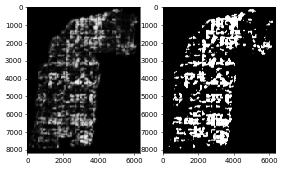

thr=0.250, precision=0.389, recall=0.629
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


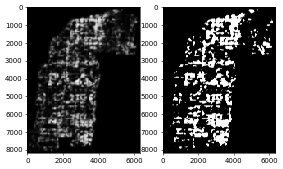

thr=0.250, precision=0.388, recall=0.611


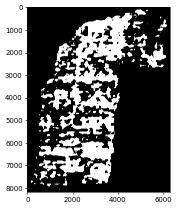

thr=0.250, fbate=0.419, precision=0.333, recall=0.824
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


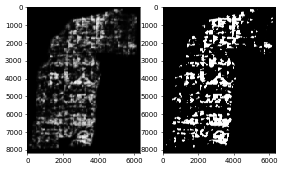

thr=0.300, precision=0.448, recall=0.565
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


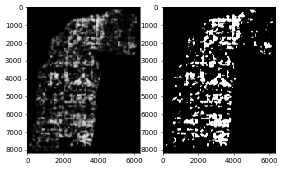

thr=0.300, precision=0.448, recall=0.559
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


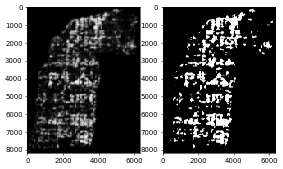

thr=0.300, precision=0.436, recall=0.567
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


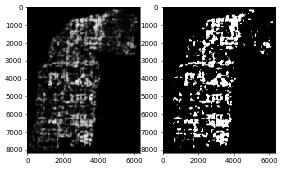

thr=0.300, precision=0.438, recall=0.551
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


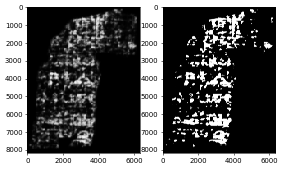

thr=0.300, precision=0.455, recall=0.565
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


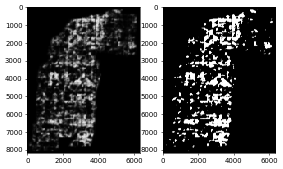

thr=0.300, precision=0.459, recall=0.571
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


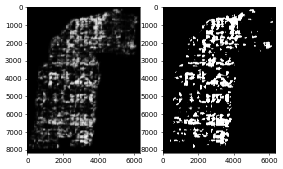

thr=0.300, precision=0.449, recall=0.563
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


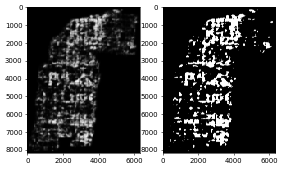

thr=0.300, precision=0.451, recall=0.568
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


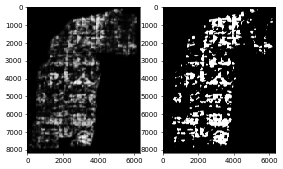

thr=0.300, precision=0.433, recall=0.567
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


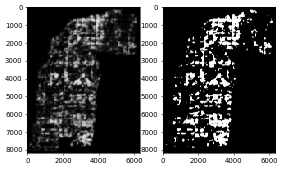

thr=0.300, precision=0.426, recall=0.552
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


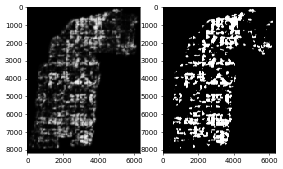

thr=0.300, precision=0.418, recall=0.567
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


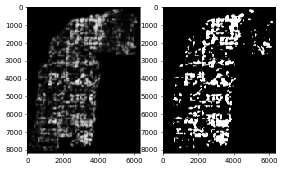

thr=0.300, precision=0.417, recall=0.548


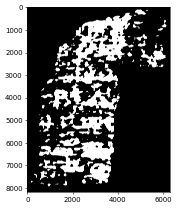

thr=0.300, fbate=0.438, precision=0.359, recall=0.772
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


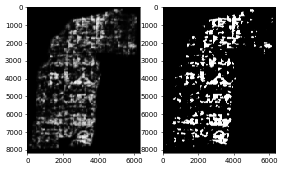

thr=0.350, precision=0.483, recall=0.510
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


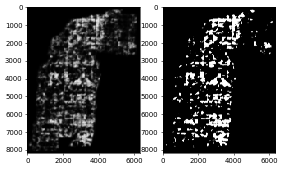

thr=0.350, precision=0.481, recall=0.500
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


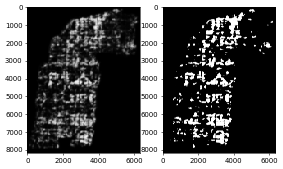

thr=0.350, precision=0.467, recall=0.509
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


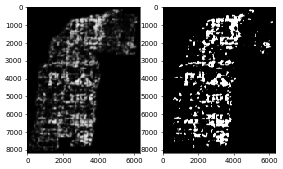

thr=0.350, precision=0.467, recall=0.495
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


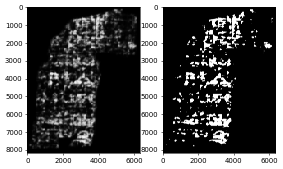

thr=0.350, precision=0.486, recall=0.508
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


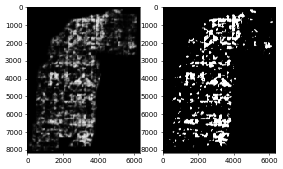

thr=0.350, precision=0.490, recall=0.513
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


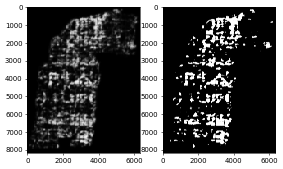

thr=0.350, precision=0.474, recall=0.505
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


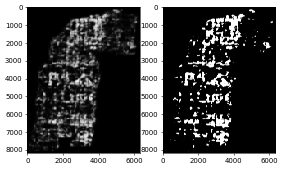

thr=0.350, precision=0.477, recall=0.509
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


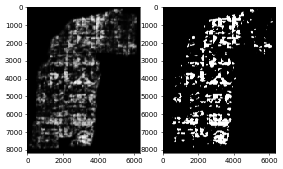

thr=0.350, precision=0.464, recall=0.508
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


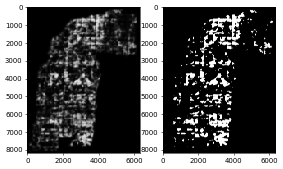

thr=0.350, precision=0.458, recall=0.490
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


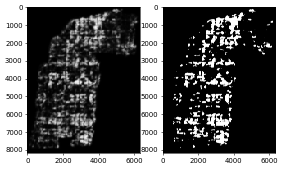

thr=0.350, precision=0.450, recall=0.509
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


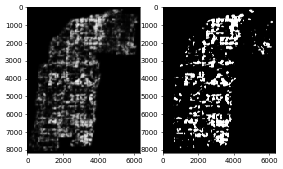

thr=0.350, precision=0.447, recall=0.488


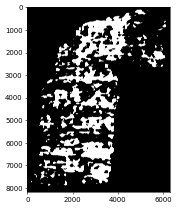

thr=0.350, fbate=0.455, precision=0.385, recall=0.717
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


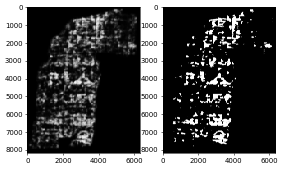

thr=0.400, precision=0.517, recall=0.455
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


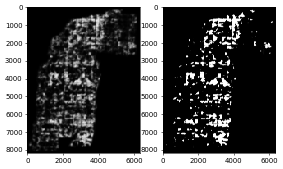

thr=0.400, precision=0.517, recall=0.443
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


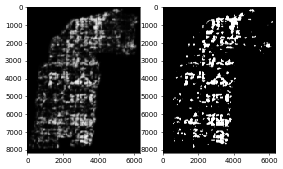

thr=0.400, precision=0.502, recall=0.454
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


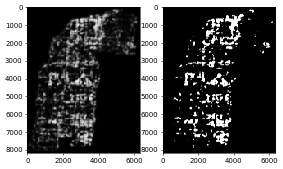

thr=0.400, precision=0.499, recall=0.440
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


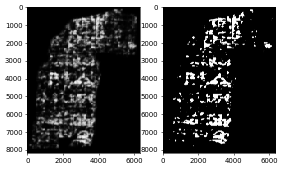

thr=0.400, precision=0.515, recall=0.453
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


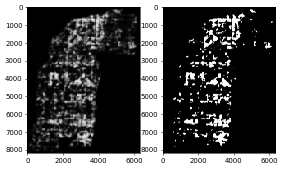

thr=0.400, precision=0.522, recall=0.455
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


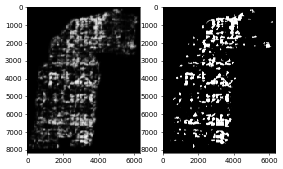

thr=0.400, precision=0.500, recall=0.448
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


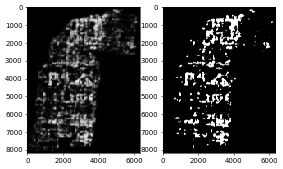

thr=0.400, precision=0.506, recall=0.453
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


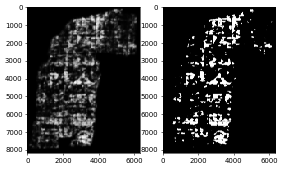

thr=0.400, precision=0.496, recall=0.450
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


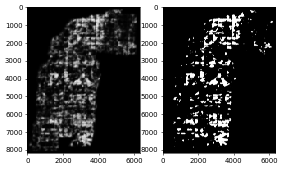

thr=0.400, precision=0.493, recall=0.432
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


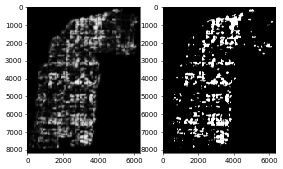

thr=0.400, precision=0.486, recall=0.453
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


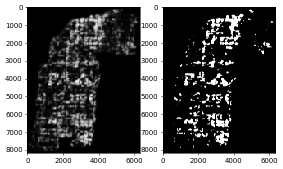

thr=0.400, precision=0.480, recall=0.432


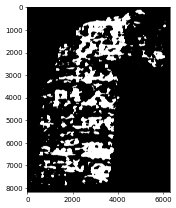

thr=0.400, fbate=0.469, precision=0.413, recall=0.659
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


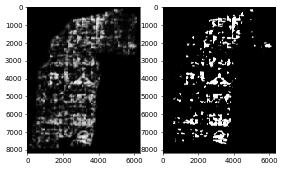

thr=0.450, precision=0.550, recall=0.404
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


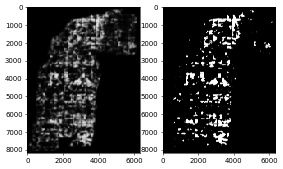

thr=0.450, precision=0.554, recall=0.393
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


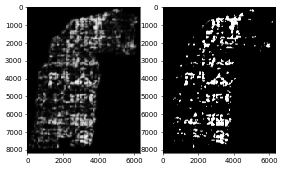

thr=0.450, precision=0.536, recall=0.404
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


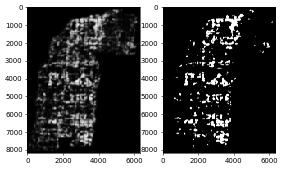

thr=0.450, precision=0.532, recall=0.388
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


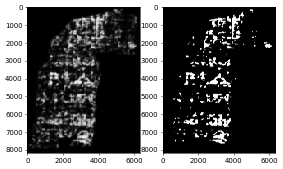

thr=0.450, precision=0.543, recall=0.400
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


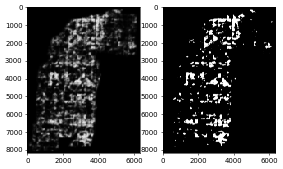

thr=0.450, precision=0.553, recall=0.402
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


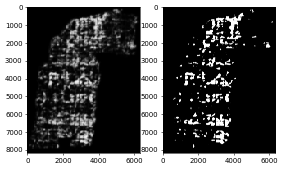

thr=0.450, precision=0.526, recall=0.400
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


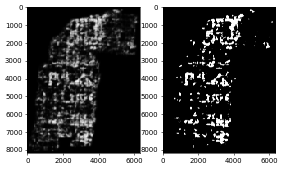

thr=0.450, precision=0.536, recall=0.402
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


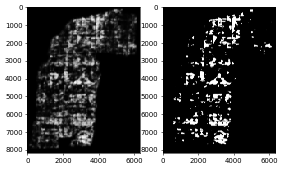

thr=0.450, precision=0.527, recall=0.396
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


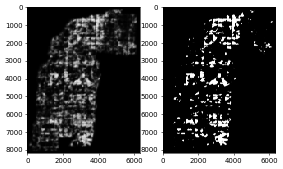

thr=0.450, precision=0.527, recall=0.381
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


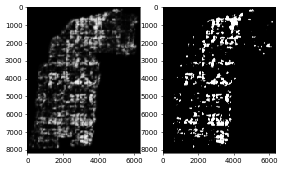

thr=0.450, precision=0.519, recall=0.399
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


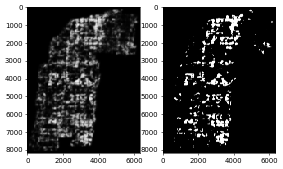

thr=0.450, precision=0.509, recall=0.380


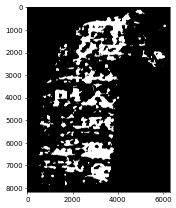

thr=0.450, fbate=0.477, precision=0.442, recall=0.608
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


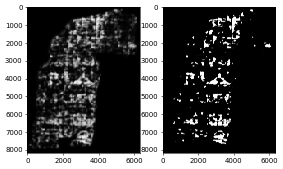

thr=0.500, precision=0.589, recall=0.349
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


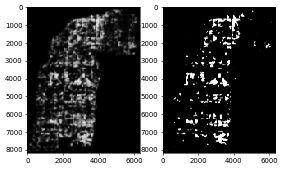

thr=0.500, precision=0.595, recall=0.338
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


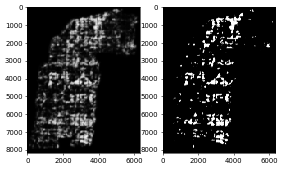

thr=0.500, precision=0.576, recall=0.347
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


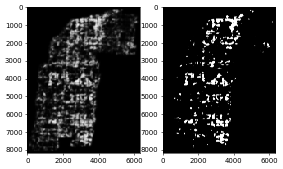

thr=0.500, precision=0.573, recall=0.332
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


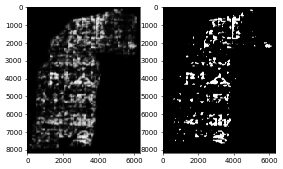

thr=0.500, precision=0.577, recall=0.344
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


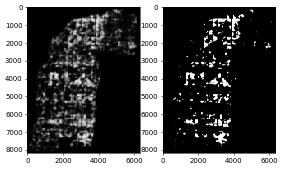

thr=0.500, precision=0.589, recall=0.345
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


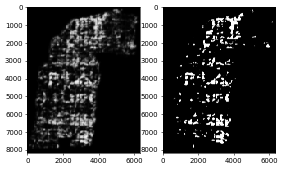

thr=0.500, precision=0.559, recall=0.347
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


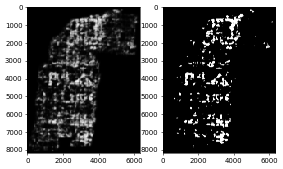

thr=0.500, precision=0.573, recall=0.345
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


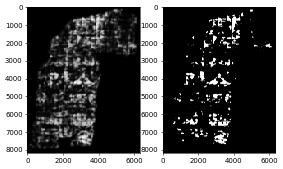

thr=0.500, precision=0.563, recall=0.335
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


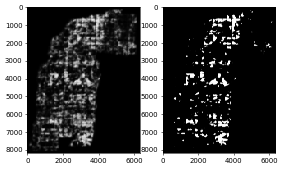

thr=0.500, precision=0.567, recall=0.326
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


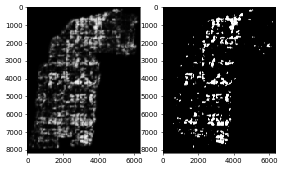

thr=0.500, precision=0.558, recall=0.341
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


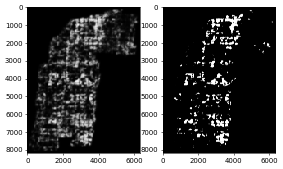

thr=0.500, precision=0.546, recall=0.322


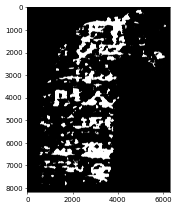

thr=0.500, fbate=0.479, precision=0.476, recall=0.551
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


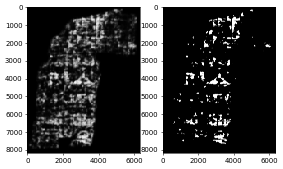

thr=0.550, precision=0.635, recall=0.291
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


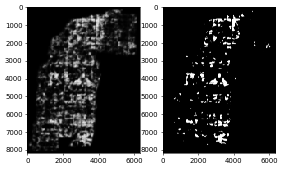

thr=0.550, precision=0.641, recall=0.280
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


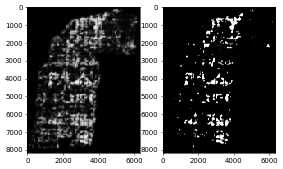

thr=0.550, precision=0.622, recall=0.289
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


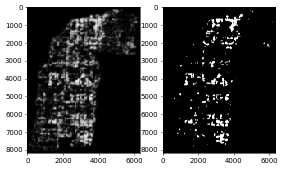

thr=0.550, precision=0.615, recall=0.274
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


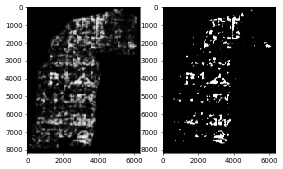

thr=0.550, precision=0.617, recall=0.288
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


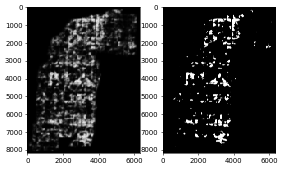

thr=0.550, precision=0.629, recall=0.291
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


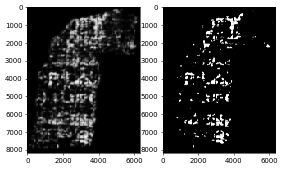

thr=0.550, precision=0.601, recall=0.293
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


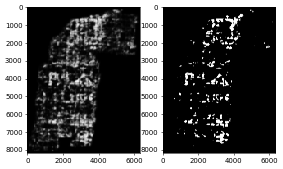

thr=0.550, precision=0.611, recall=0.287
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


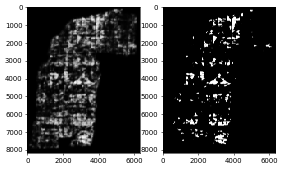

thr=0.550, precision=0.607, recall=0.276
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


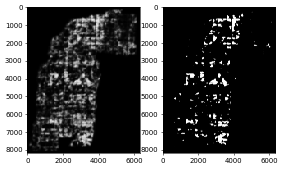

thr=0.550, precision=0.613, recall=0.273
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


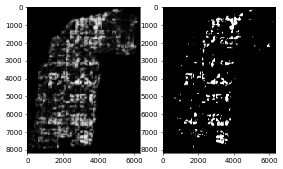

thr=0.550, precision=0.600, recall=0.282
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


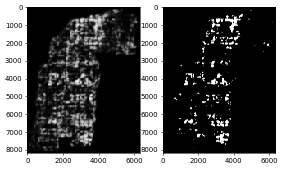

thr=0.550, precision=0.586, recall=0.264


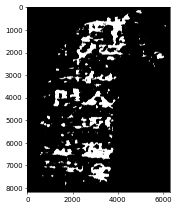

thr=0.550, fbate=0.471, precision=0.516, recall=0.488
--------- thrshold = 0.6000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


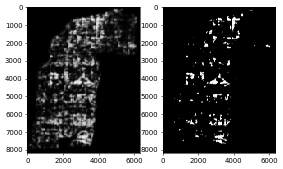

thr=0.600, precision=0.691, recall=0.232
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


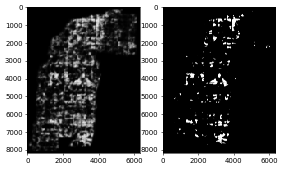

thr=0.600, precision=0.691, recall=0.222
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


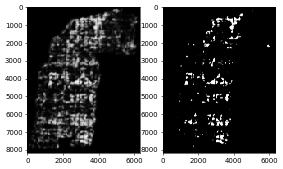

thr=0.600, precision=0.677, recall=0.230
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


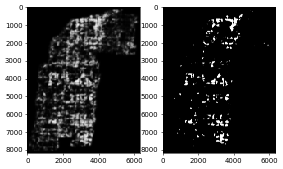

thr=0.600, precision=0.661, recall=0.216
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


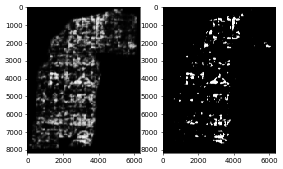

thr=0.600, precision=0.665, recall=0.232
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


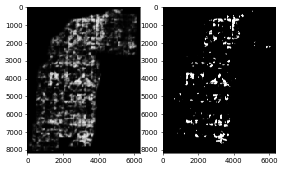

thr=0.600, precision=0.675, recall=0.235
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


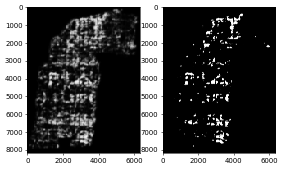

thr=0.600, precision=0.651, recall=0.237
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


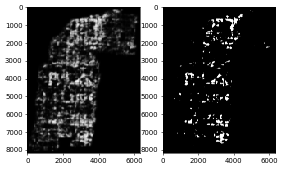

thr=0.600, precision=0.650, recall=0.226
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


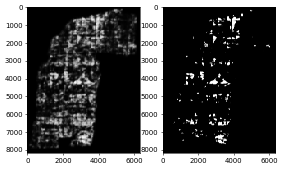

thr=0.600, precision=0.670, recall=0.219
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


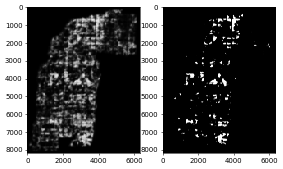

thr=0.600, precision=0.664, recall=0.217
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


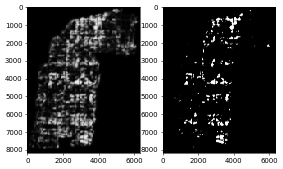

thr=0.600, precision=0.650, recall=0.221
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


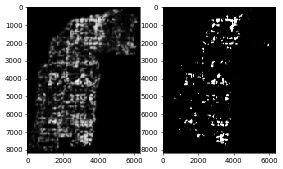

thr=0.600, precision=0.629, recall=0.206


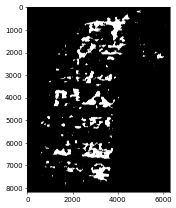

thr=0.600, fbate=0.446, precision=0.562, recall=0.419
--------- thrshold = 0.6500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


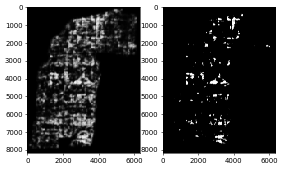

thr=0.650, precision=0.759, recall=0.178
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


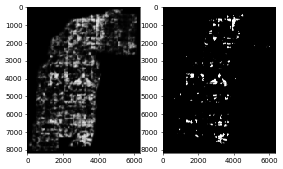

thr=0.650, precision=0.742, recall=0.169
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


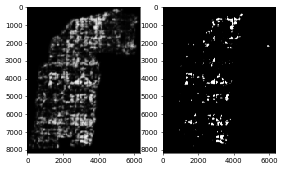

thr=0.650, precision=0.735, recall=0.177
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


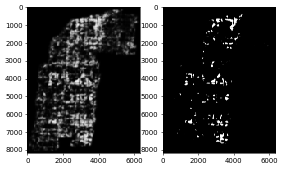

thr=0.650, precision=0.708, recall=0.165
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


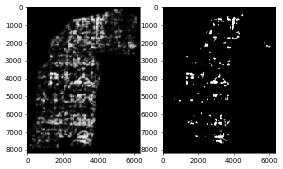

thr=0.650, precision=0.718, recall=0.181
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


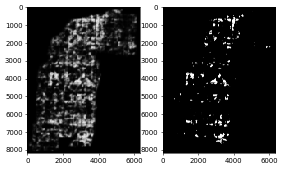

thr=0.650, precision=0.722, recall=0.180
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


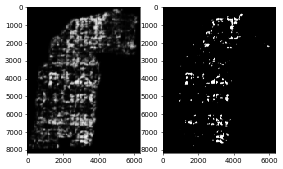

thr=0.650, precision=0.709, recall=0.182
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


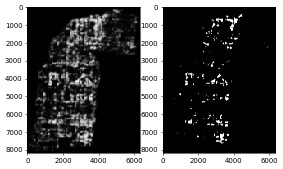

thr=0.650, precision=0.694, recall=0.170
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


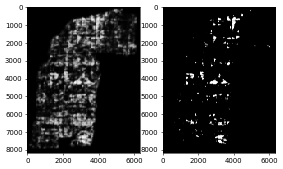

thr=0.650, precision=0.742, recall=0.166
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


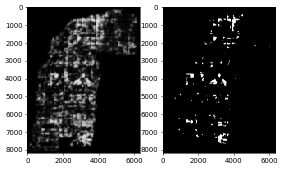

thr=0.650, precision=0.716, recall=0.164
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


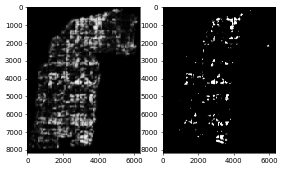

thr=0.650, precision=0.710, recall=0.165
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


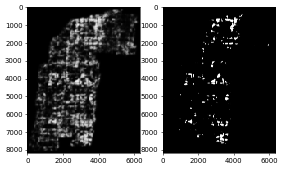

thr=0.650, precision=0.680, recall=0.154


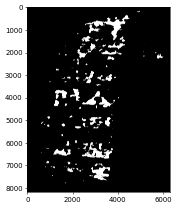

thr=0.650, fbate=0.405, precision=0.613, recall=0.349
--------- thrshold = 0.7000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


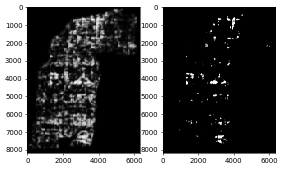

thr=0.700, precision=0.840, recall=0.121
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


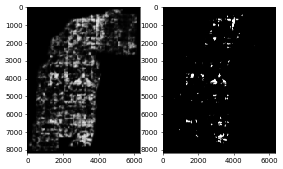

thr=0.700, precision=0.806, recall=0.114
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


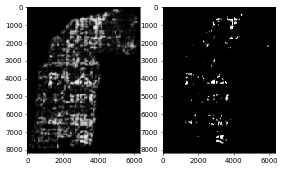

thr=0.700, precision=0.805, recall=0.120
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


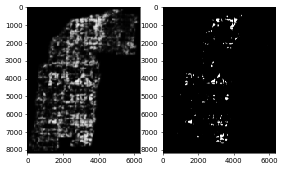

thr=0.700, precision=0.766, recall=0.110
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


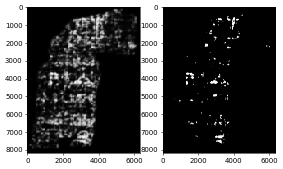

thr=0.700, precision=0.795, recall=0.126
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


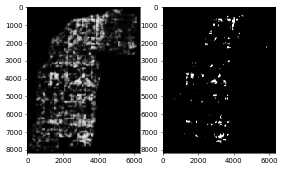

thr=0.700, precision=0.784, recall=0.120
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


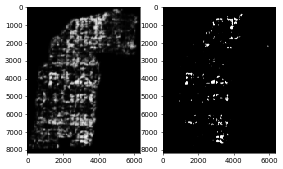

thr=0.700, precision=0.795, recall=0.125
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


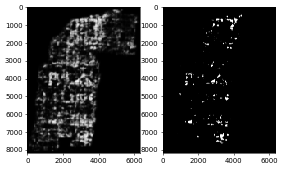

thr=0.700, precision=0.751, recall=0.113
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


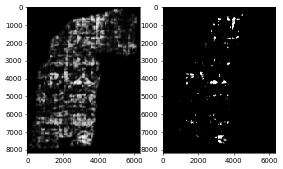

thr=0.700, precision=0.823, recall=0.110
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


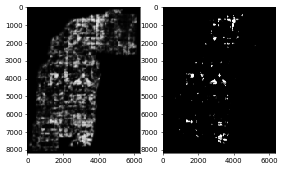

thr=0.700, precision=0.787, recall=0.108
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


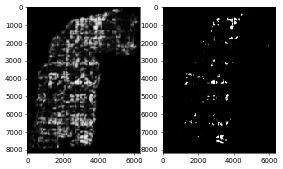

thr=0.700, precision=0.785, recall=0.110
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


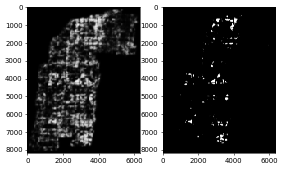

thr=0.700, precision=0.753, recall=0.102


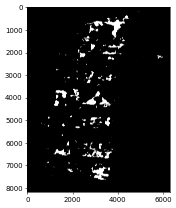

thr=0.700, fbate=0.332, precision=0.691, recall=0.264
--------- thrshold = 0.7500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


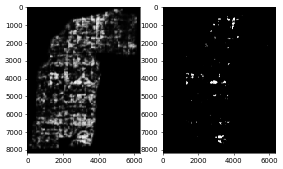

thr=0.750, precision=0.904, recall=0.068
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


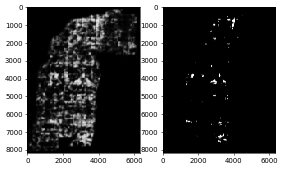

thr=0.750, precision=0.874, recall=0.063
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


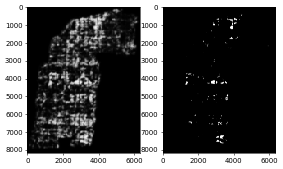

thr=0.750, precision=0.889, recall=0.067
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


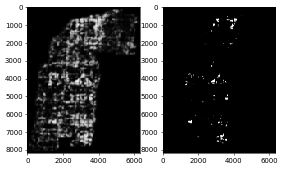

thr=0.750, precision=0.826, recall=0.062
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


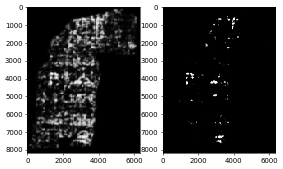

thr=0.750, precision=0.887, recall=0.074
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


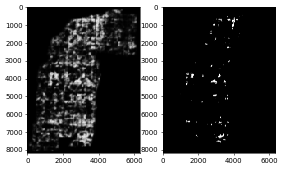

thr=0.750, precision=0.848, recall=0.067
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


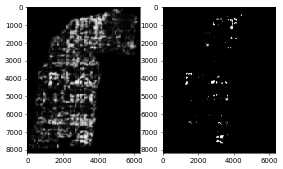

thr=0.750, precision=0.888, recall=0.072
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


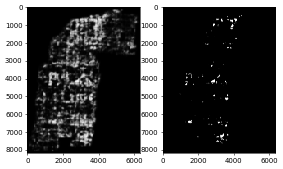

thr=0.750, precision=0.837, recall=0.064
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


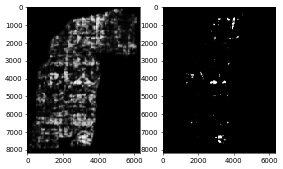

thr=0.750, precision=0.896, recall=0.062
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


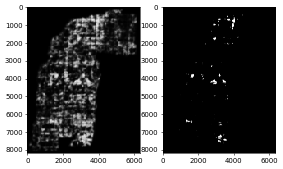

thr=0.750, precision=0.874, recall=0.061
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


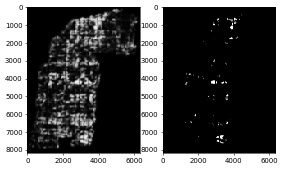

thr=0.750, precision=0.876, recall=0.062
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


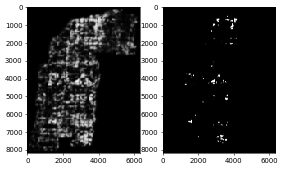

thr=0.750, precision=0.815, recall=0.057


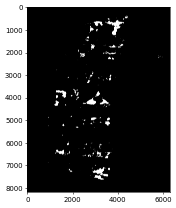

thr=0.750, fbate=0.224, precision=0.789, recall=0.170
--------- thrshold = 0.8000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


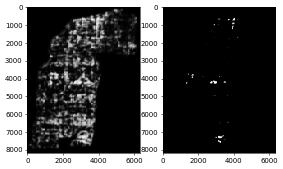

thr=0.800, precision=0.943, recall=0.030
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


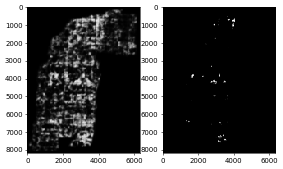

thr=0.800, precision=0.925, recall=0.026
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


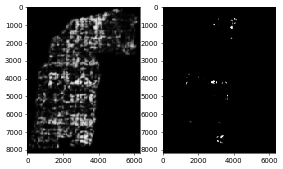

thr=0.800, precision=0.957, recall=0.028
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


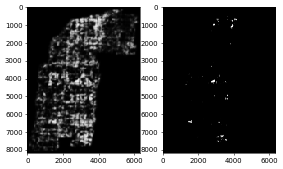

thr=0.800, precision=0.905, recall=0.025
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


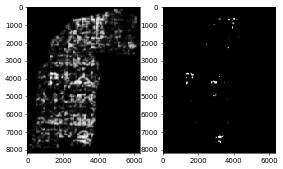

thr=0.800, precision=0.945, recall=0.034
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


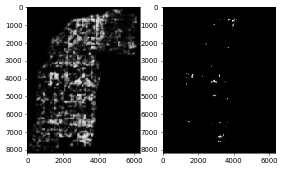

thr=0.800, precision=0.929, recall=0.025
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


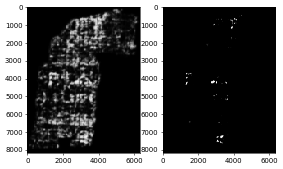

thr=0.800, precision=0.944, recall=0.030
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


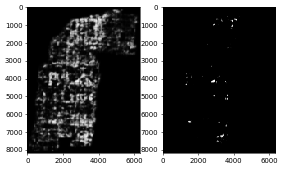

thr=0.800, precision=0.932, recall=0.027
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


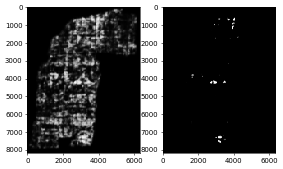

thr=0.800, precision=0.942, recall=0.031
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


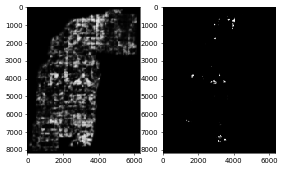

thr=0.800, precision=0.922, recall=0.026
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


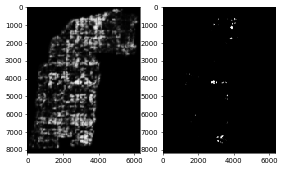

thr=0.800, precision=0.965, recall=0.027
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


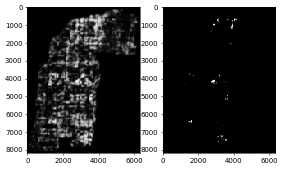

thr=0.800, precision=0.866, recall=0.023


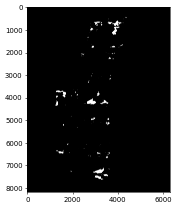

thr=0.800, fbate=0.102, precision=0.885, recall=0.087
--------- thrshold = 0.8500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


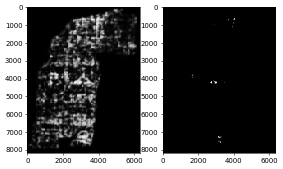

thr=0.850, precision=0.971, recall=0.009
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


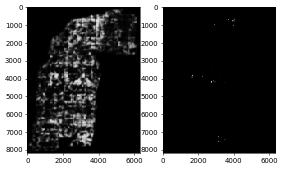

thr=0.850, precision=0.961, recall=0.005
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


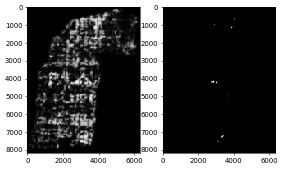

thr=0.850, precision=0.982, recall=0.008
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


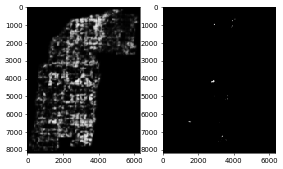

thr=0.850, precision=0.982, recall=0.006
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


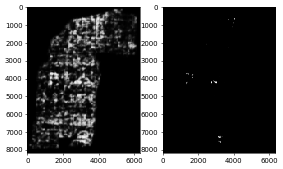

thr=0.850, precision=0.978, recall=0.010
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


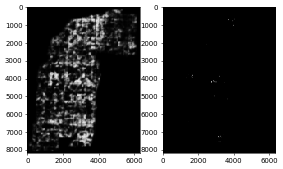

thr=0.850, precision=0.989, recall=0.004
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


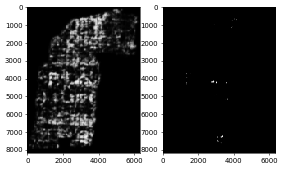

thr=0.850, precision=0.980, recall=0.008
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


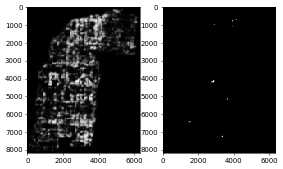

thr=0.850, precision=0.982, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


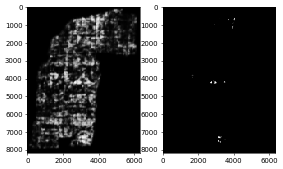

thr=0.850, precision=0.983, recall=0.010
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


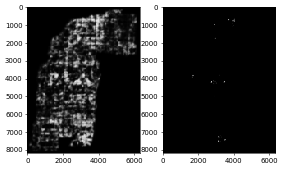

thr=0.850, precision=0.902, recall=0.006
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


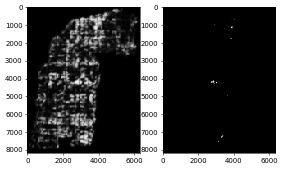

thr=0.850, precision=0.998, recall=0.007
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


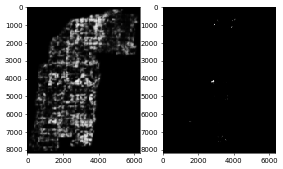

thr=0.850, precision=0.951, recall=0.005


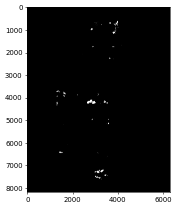

thr=0.850, fbate=0.023, precision=0.955, recall=0.029
--------- thrshold = 0.9000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


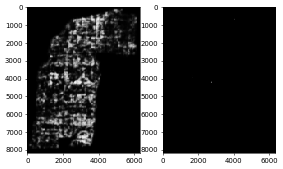

thr=0.900, precision=1.000, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


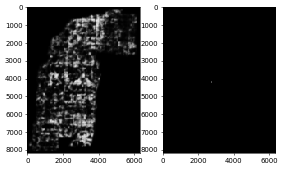

thr=0.900, precision=0.999, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


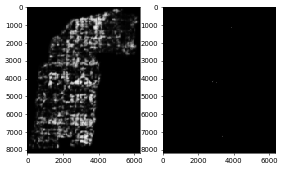

thr=0.900, precision=0.999, recall=0.001
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


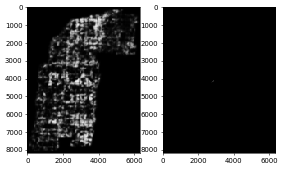

thr=0.900, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


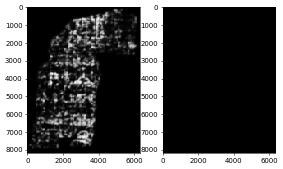

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


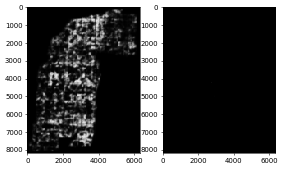

thr=0.900, precision=1.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


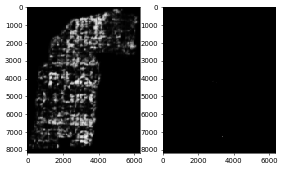

thr=0.900, precision=1.000, recall=0.001
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


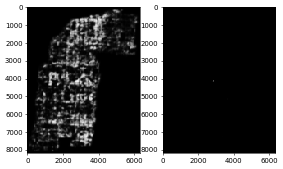

thr=0.900, precision=1.000, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


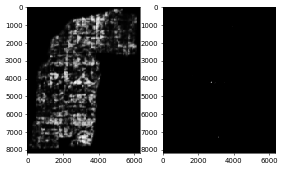

thr=0.900, precision=0.999, recall=0.001
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


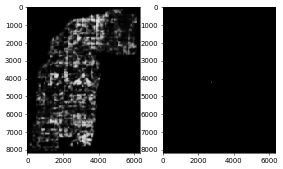

thr=0.900, precision=0.963, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


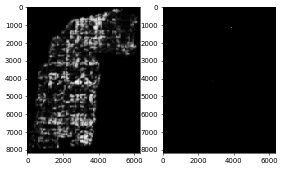

thr=0.900, precision=1.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


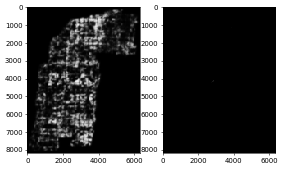

thr=0.900, precision=1.000, recall=0.000


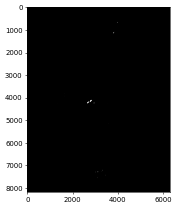

thr=0.900, fbate=0.002, precision=0.995, recall=0.003
--------- thrshold = 0.9500000000000003 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


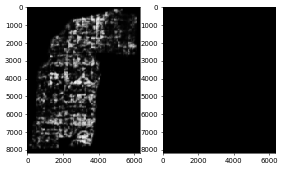

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


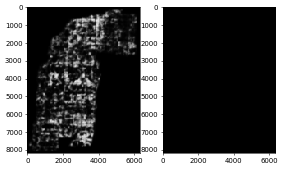

thr=0.950, precision=1.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


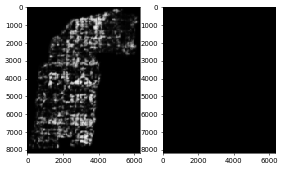

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


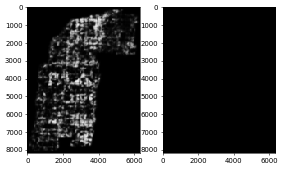

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


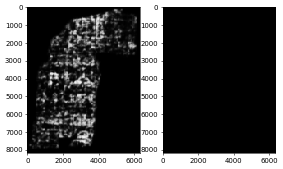

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


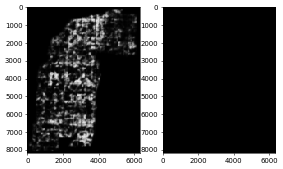

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


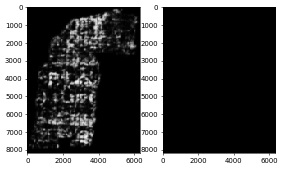

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


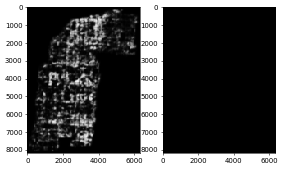

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


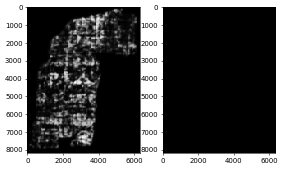

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


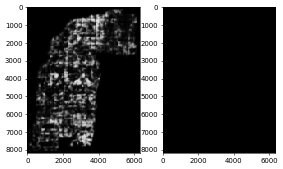

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


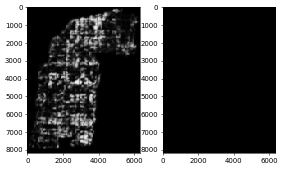

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


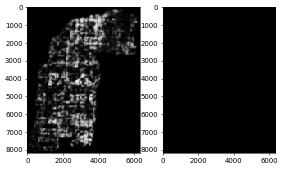

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


thr=0.950, precision=0.000, recall=0.000


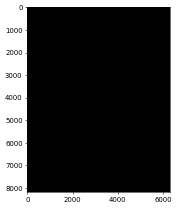

thr=0.950, fbate=0.000, precision=1.000, recall=0.000


In [43]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score

mode = "slide_tta"
# tta_list = ["default", "hflip", "vflip"]
tta_list = ["default"]
for fold in CFG["folds"]:
    print("=================")
    print("fold = ", fold)
    valid_dirs = CFG["VALID_DIR_LIST"][fold]
    mask_path = os.path.join(CFG["INPUT_DIR"], "train", valid_dirs[0], "inklabels.png")
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    plt.figure(dpi=50)
    plt.imshow(mask, cmap="gray")
    plt.show()
    mask_binary = (mask > 0).astype(np.uint8)
    for threshold in np.arange(0.10, 1.0, 0.05):
        print(f"--------- thrshold = {threshold} -------------")
        pred_add = np.zeros_like(mask)
        for slice_idx, surface_list in enumerate(CFG["SURFACE_LIST"]):
            for slide_idx, slide_pos in enumerate(CFG["slide_pos_list"]):
                for tta in tta_list:
                    print(f"surface_list: {surface_list}, slide pos:{slide_pos}, tta:{tta}")
                    pred_path = os.path.join(CFG["OUTPUT_DIR"], "imgs_each", f"fold{fold}_{mode}_slice{slice_idx}_slide{slide_idx}_{tta}_valid_pred_img.png")
                    # print(pred_path)
                    pred_img = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)/255.
                    pred_binary = (pred_img >= threshold).astype(np.uint8)
                    pred_add += pred_binary
                    plt.figure(dpi=50)
                    plt.subplot(1,2,1)
                    plt.imshow(pred_img, cmap="gray")
                    plt.subplot(1,2,2)
                    plt.imshow(pred_binary, cmap="gray")
                    plt.show()
                    
                    # cm = confusion_matrix(mask_binary.flatten(), pred_binary.flatten())
                    precision  = precision_score(mask_binary.flatten(), pred_binary.flatten())
                    recall  = recall_score(mask_binary.flatten(), pred_binary.flatten())
                    # confusion flatten
                    # tn, fp, fn, tp = cm.ravel()
                    print(f"thr={threshold:.3f}, precision={precision:.3f}, recall={recall:.3f}")
                    # print(f"thr={threshold:.3f}, tn={tn}, fp={fp}, fn={fn}, tp={tp}, precision={precision:.3f}, recall={recall:.3f}")
        pred_add = (pred_add > 0).astype(np.uint8)
        precision  = precision_score(mask_binary.flatten(), pred_add.flatten())
        recall  = recall_score(mask_binary.flatten(), pred_add.flatten())
        fbata = fbeta_numpy(mask_binary.flatten(), pred_binary.flatten(), beta=0.5)
        plt.figure(dpi=50)
        plt.imshow(pred_add, cmap="gray")
        plt.show()
        print(f"thr={threshold:.3f}, fbate={fbata:.3f}, precision={precision:.3f}, recall={recall:.3f}")

# SCORING 3 TTA

fold =  0


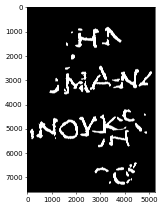

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


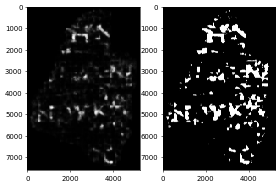

thr=0.100, precision=0.504, recall=0.579
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


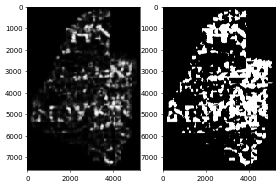

thr=0.100, precision=0.290, recall=0.758
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


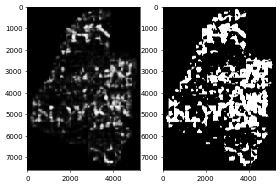

thr=0.100, precision=0.288, recall=0.784
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


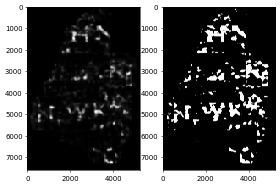

thr=0.100, precision=0.497, recall=0.575
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


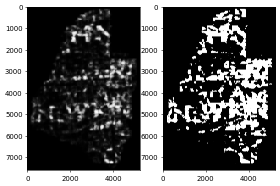

thr=0.100, precision=0.294, recall=0.773
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


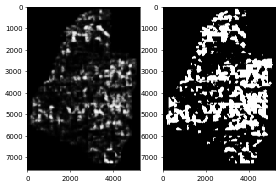

thr=0.100, precision=0.291, recall=0.805
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


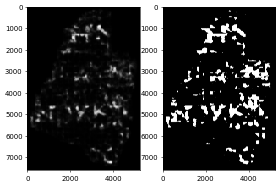

thr=0.100, precision=0.479, recall=0.582
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


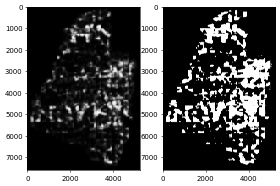

thr=0.100, precision=0.295, recall=0.773
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


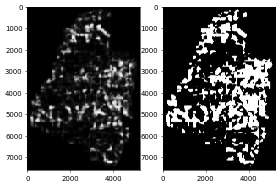

thr=0.100, precision=0.285, recall=0.782
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


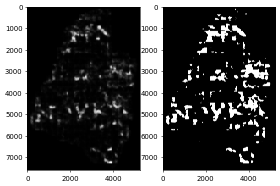

thr=0.100, precision=0.473, recall=0.579
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


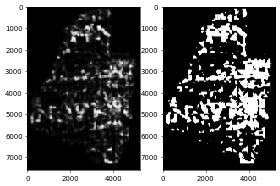

thr=0.100, precision=0.296, recall=0.777
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


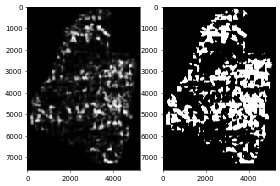

thr=0.100, precision=0.286, recall=0.790
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


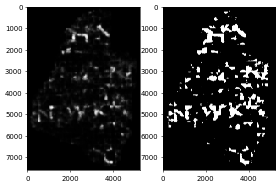

thr=0.100, precision=0.485, recall=0.569
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


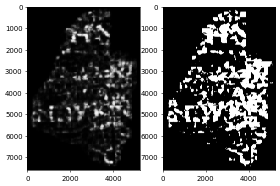

thr=0.100, precision=0.289, recall=0.761
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


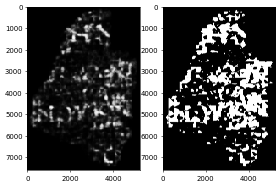

thr=0.100, precision=0.291, recall=0.778
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


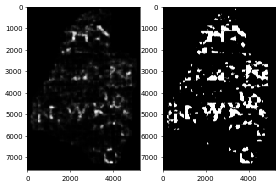

thr=0.100, precision=0.489, recall=0.568
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


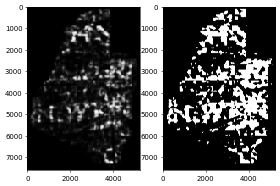

thr=0.100, precision=0.289, recall=0.769
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


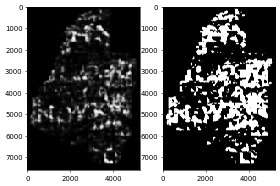

thr=0.100, precision=0.289, recall=0.803
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


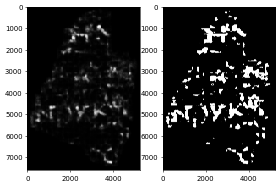

thr=0.100, precision=0.475, recall=0.585
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


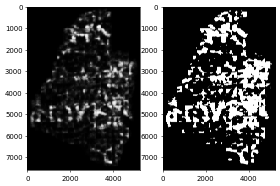

thr=0.100, precision=0.296, recall=0.781
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


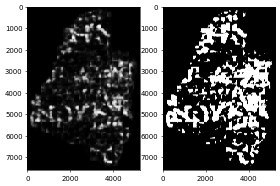

thr=0.100, precision=0.288, recall=0.779
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


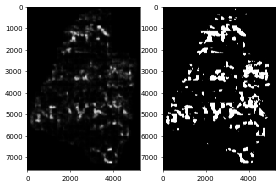

thr=0.100, precision=0.472, recall=0.581
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


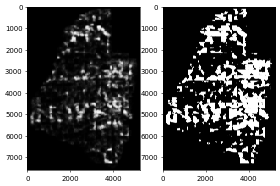

thr=0.100, precision=0.296, recall=0.784
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


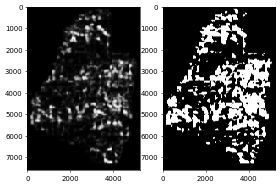

thr=0.100, precision=0.284, recall=0.788
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


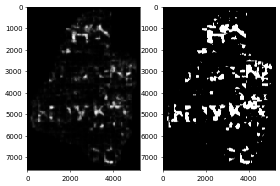

thr=0.100, precision=0.512, recall=0.570
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


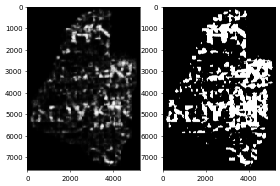

thr=0.100, precision=0.302, recall=0.755
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


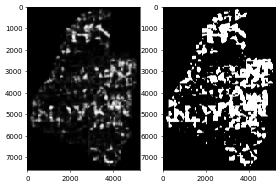

thr=0.100, precision=0.299, recall=0.764
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


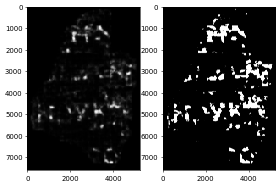

thr=0.100, precision=0.515, recall=0.562
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


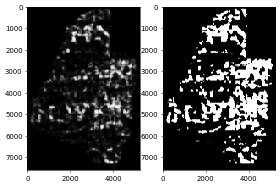

thr=0.100, precision=0.304, recall=0.774
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


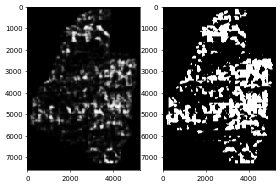

thr=0.100, precision=0.297, recall=0.787
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


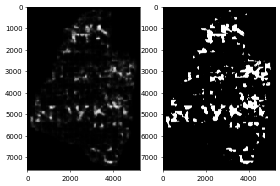

thr=0.100, precision=0.498, recall=0.554
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


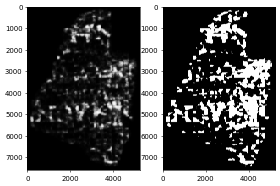

thr=0.100, precision=0.303, recall=0.757
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


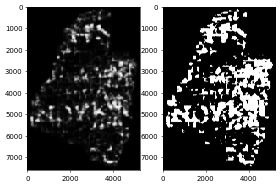

thr=0.100, precision=0.294, recall=0.764
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


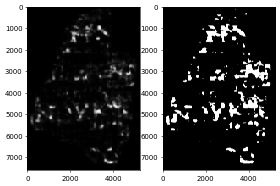

thr=0.100, precision=0.487, recall=0.548
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


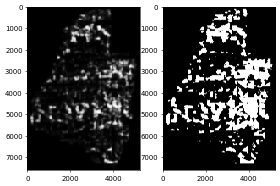

thr=0.100, precision=0.305, recall=0.776
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


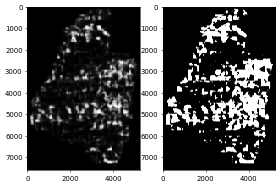

thr=0.100, precision=0.293, recall=0.770


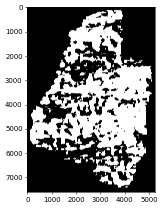

thr=0.100, fbate=0.335, precision=0.198, recall=0.940
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


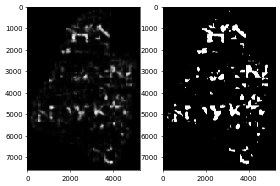

thr=0.150, precision=0.596, recall=0.470
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


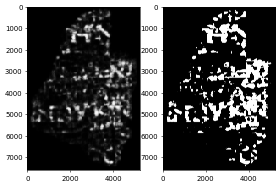

thr=0.150, precision=0.351, recall=0.687
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


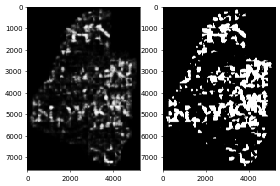

thr=0.150, precision=0.346, recall=0.717
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


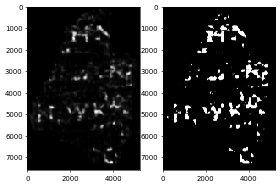

thr=0.150, precision=0.609, recall=0.462
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


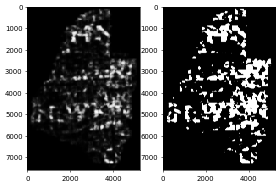

thr=0.150, precision=0.347, recall=0.688
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


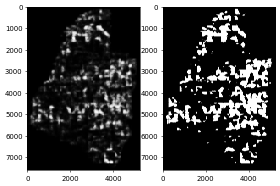

thr=0.150, precision=0.344, recall=0.731
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


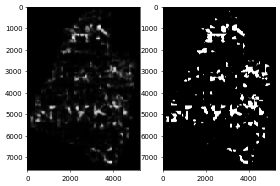

thr=0.150, precision=0.572, recall=0.473
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


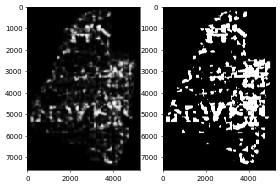

thr=0.150, precision=0.353, recall=0.701
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


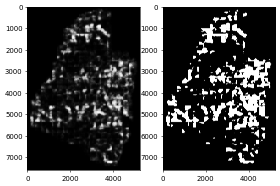

thr=0.150, precision=0.340, recall=0.714
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


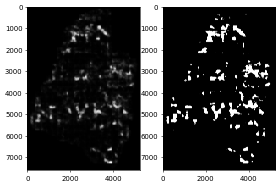

thr=0.150, precision=0.577, recall=0.469
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


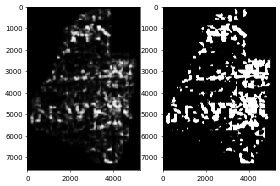

thr=0.150, precision=0.353, recall=0.706
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


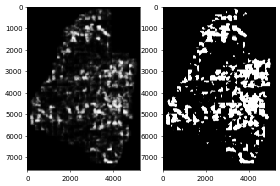

thr=0.150, precision=0.342, recall=0.719
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


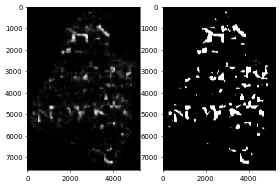

thr=0.150, precision=0.582, recall=0.453
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


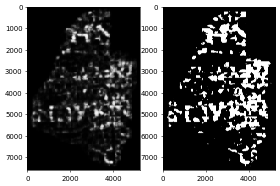

thr=0.150, precision=0.352, recall=0.686
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


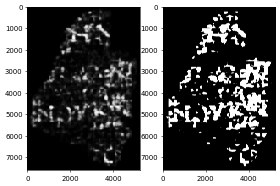

thr=0.150, precision=0.351, recall=0.705
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


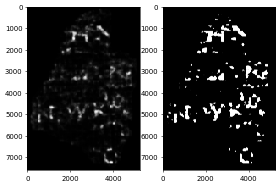

thr=0.150, precision=0.600, recall=0.460
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


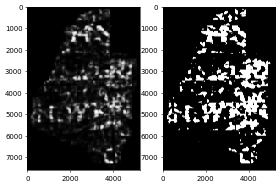

thr=0.150, precision=0.353, recall=0.694
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


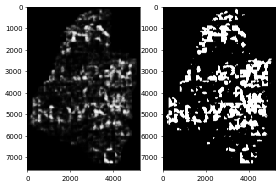

thr=0.150, precision=0.346, recall=0.727
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


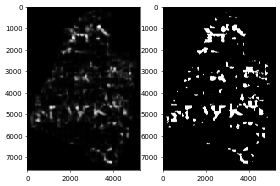

thr=0.150, precision=0.572, recall=0.463
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


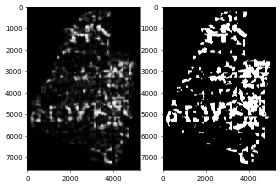

thr=0.150, precision=0.362, recall=0.700
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


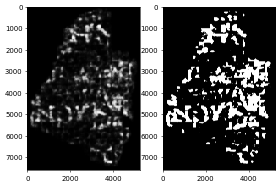

thr=0.150, precision=0.349, recall=0.714
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


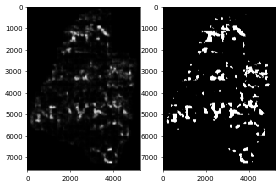

thr=0.150, precision=0.574, recall=0.471
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


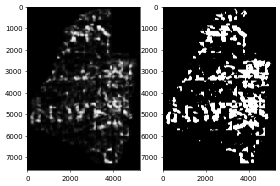

thr=0.150, precision=0.361, recall=0.702
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


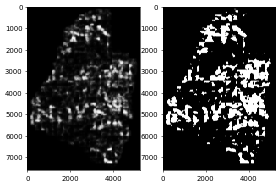

thr=0.150, precision=0.345, recall=0.715
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


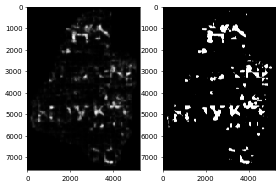

thr=0.150, precision=0.605, recall=0.458
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


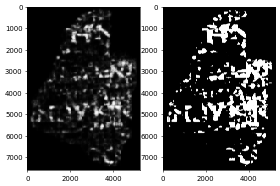

thr=0.150, precision=0.362, recall=0.686
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


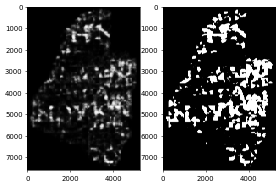

thr=0.150, precision=0.357, recall=0.702
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


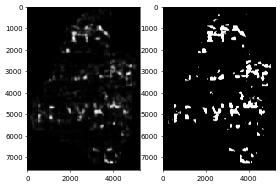

thr=0.150, precision=0.615, recall=0.450
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


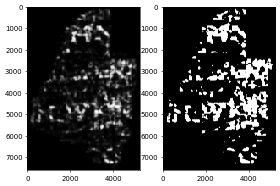

thr=0.150, precision=0.361, recall=0.698
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


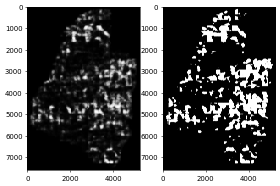

thr=0.150, precision=0.351, recall=0.714
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


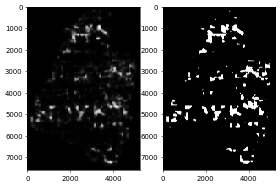

thr=0.150, precision=0.594, recall=0.451
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


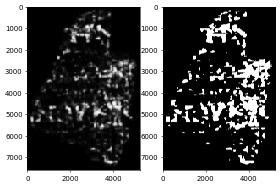

thr=0.150, precision=0.355, recall=0.679
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


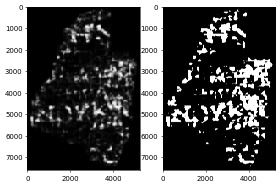

thr=0.150, precision=0.352, recall=0.697
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


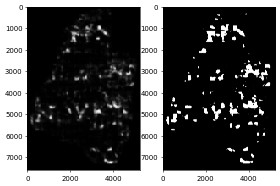

thr=0.150, precision=0.579, recall=0.443
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


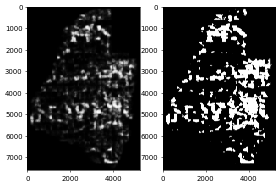

thr=0.150, precision=0.358, recall=0.697
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


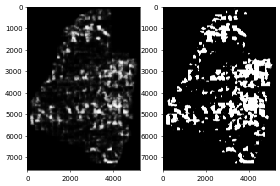

thr=0.150, precision=0.350, recall=0.702


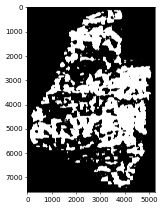

thr=0.150, fbate=0.389, precision=0.233, recall=0.890
--------- thrshold = 0.20000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


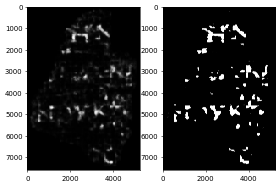

thr=0.200, precision=0.662, recall=0.400
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


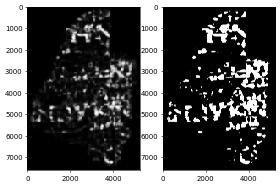

thr=0.200, precision=0.401, recall=0.637
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


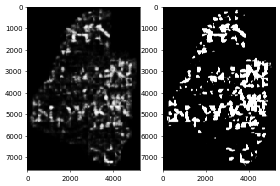

thr=0.200, precision=0.395, recall=0.663
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


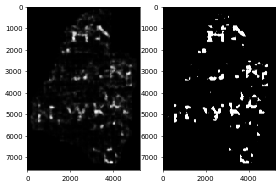

thr=0.200, precision=0.682, recall=0.392
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


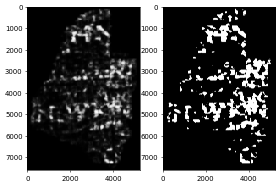

thr=0.200, precision=0.397, recall=0.637
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


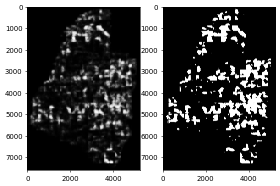

thr=0.200, precision=0.386, recall=0.669
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


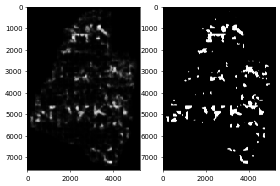

thr=0.200, precision=0.635, recall=0.399
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


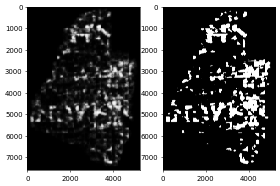

thr=0.200, precision=0.404, recall=0.648
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


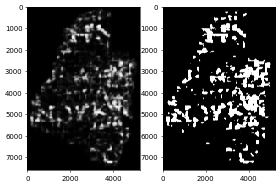

thr=0.200, precision=0.390, recall=0.663
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


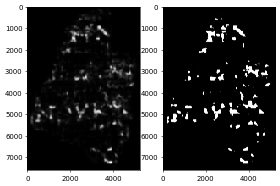

thr=0.200, precision=0.653, recall=0.394
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


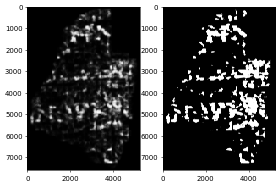

thr=0.200, precision=0.400, recall=0.650
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


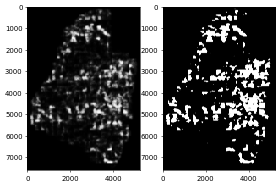

thr=0.200, precision=0.388, recall=0.667
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


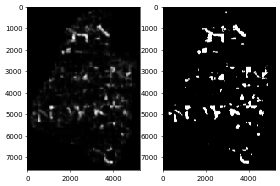

thr=0.200, precision=0.661, recall=0.378
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


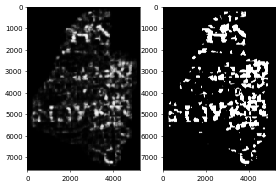

thr=0.200, precision=0.403, recall=0.629
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


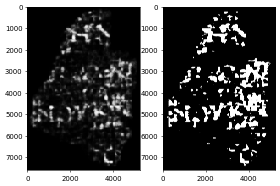

thr=0.200, precision=0.402, recall=0.655
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


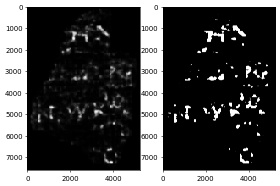

thr=0.200, precision=0.677, recall=0.385
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


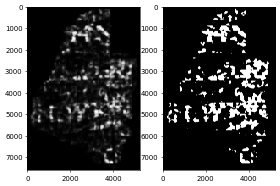

thr=0.200, precision=0.406, recall=0.631
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


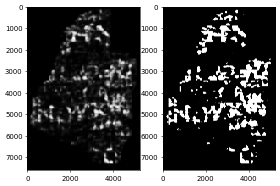

thr=0.200, precision=0.394, recall=0.668
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


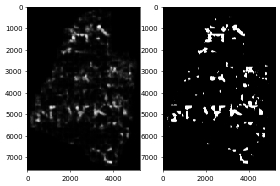

thr=0.200, precision=0.641, recall=0.377
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


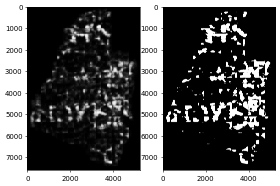

thr=0.200, precision=0.409, recall=0.629
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


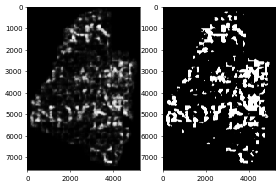

thr=0.200, precision=0.398, recall=0.663
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


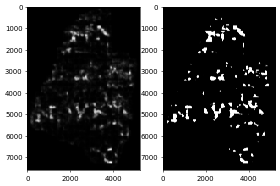

thr=0.200, precision=0.652, recall=0.380
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


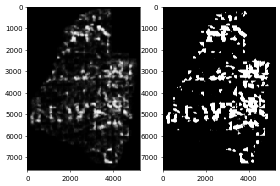

thr=0.200, precision=0.409, recall=0.637
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


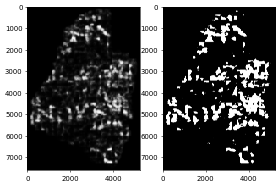

thr=0.200, precision=0.397, recall=0.661
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


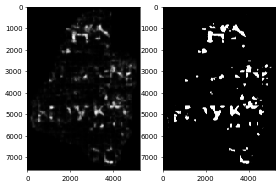

thr=0.200, precision=0.675, recall=0.388
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


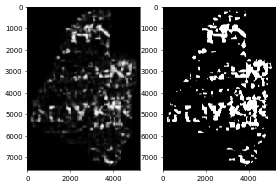

thr=0.200, precision=0.413, recall=0.631
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


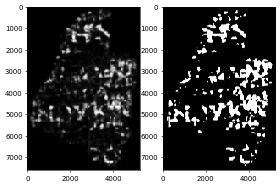

thr=0.200, precision=0.402, recall=0.652
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


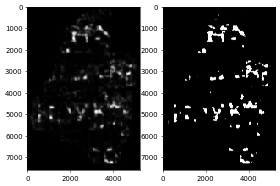

thr=0.200, precision=0.688, recall=0.377
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


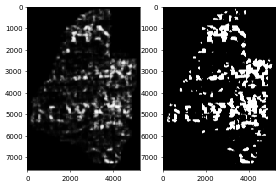

thr=0.200, precision=0.412, recall=0.642
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


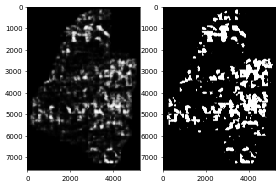

thr=0.200, precision=0.394, recall=0.656
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


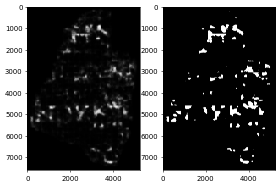

thr=0.200, precision=0.655, recall=0.381
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


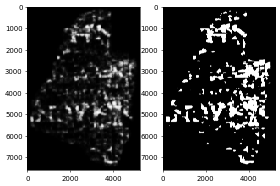

thr=0.200, precision=0.401, recall=0.623
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


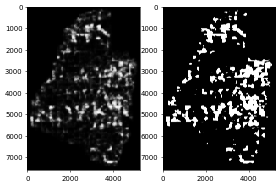

thr=0.200, precision=0.399, recall=0.642
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


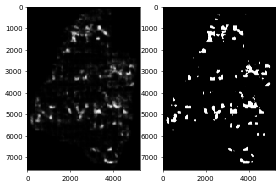

thr=0.200, precision=0.655, recall=0.380
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


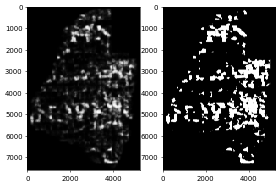

thr=0.200, precision=0.405, recall=0.636
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


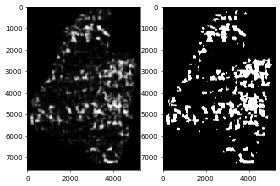

thr=0.200, precision=0.395, recall=0.651


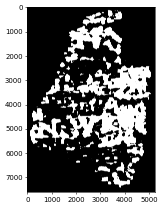

thr=0.200, fbate=0.429, precision=0.264, recall=0.852
--------- thrshold = 0.25000000000000006 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


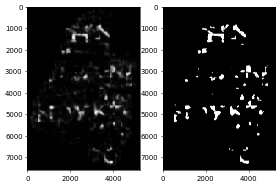

thr=0.250, precision=0.711, recall=0.354
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


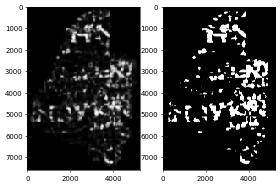

thr=0.250, precision=0.441, recall=0.596
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


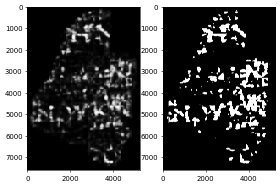

thr=0.250, precision=0.432, recall=0.620
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


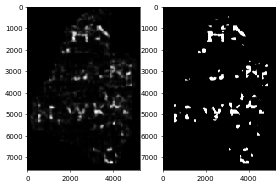

thr=0.250, precision=0.731, recall=0.347
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


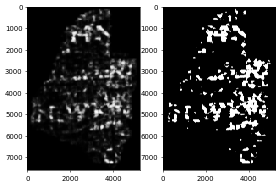

thr=0.250, precision=0.440, recall=0.594
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


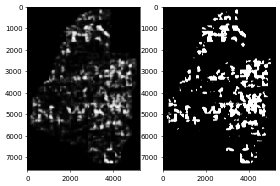

thr=0.250, precision=0.423, recall=0.623
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


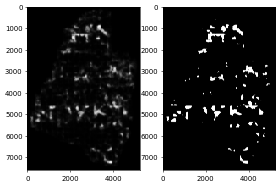

thr=0.250, precision=0.692, recall=0.345
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


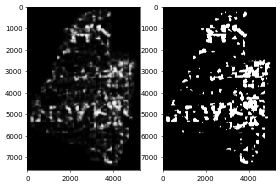

thr=0.250, precision=0.444, recall=0.601
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


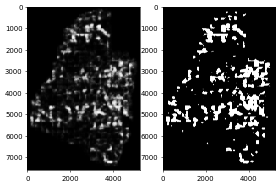

thr=0.250, precision=0.430, recall=0.622
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


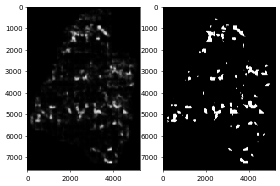

thr=0.250, precision=0.707, recall=0.339
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


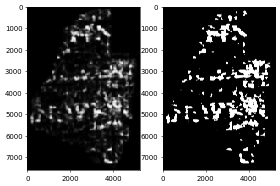

thr=0.250, precision=0.439, recall=0.601
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


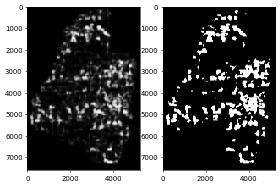

thr=0.250, precision=0.425, recall=0.621
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


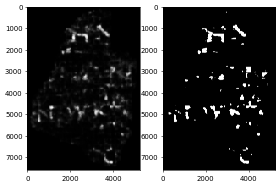

thr=0.250, precision=0.715, recall=0.320
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


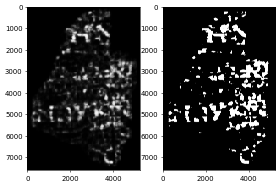

thr=0.250, precision=0.448, recall=0.584
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


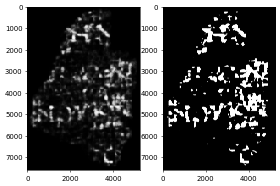

thr=0.250, precision=0.443, recall=0.613
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


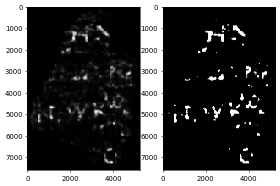

thr=0.250, precision=0.735, recall=0.334
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


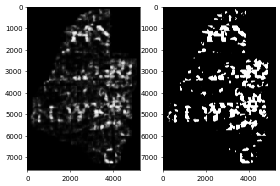

thr=0.250, precision=0.450, recall=0.586
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


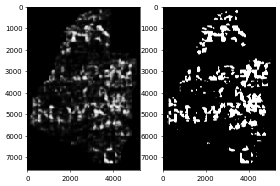

thr=0.250, precision=0.437, recall=0.622
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


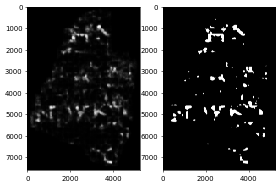

thr=0.250, precision=0.687, recall=0.318
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


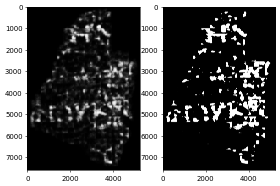

thr=0.250, precision=0.448, recall=0.579
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


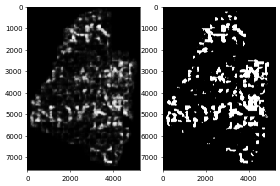

thr=0.250, precision=0.438, recall=0.618
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


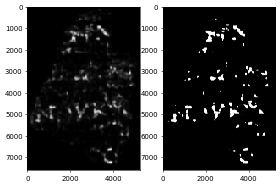

thr=0.250, precision=0.706, recall=0.323
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


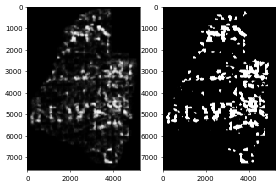

thr=0.250, precision=0.445, recall=0.583
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


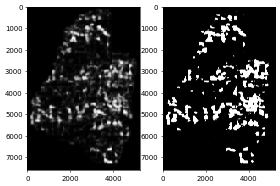

thr=0.250, precision=0.436, recall=0.612
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


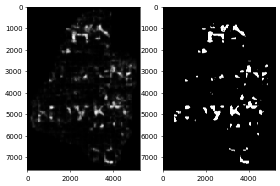

thr=0.250, precision=0.720, recall=0.338
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


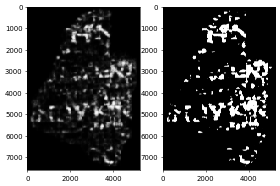

thr=0.250, precision=0.452, recall=0.585
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


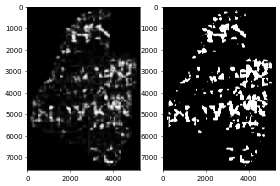

thr=0.250, precision=0.437, recall=0.608
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


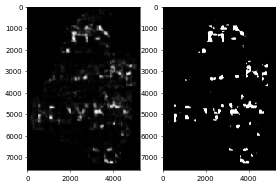

thr=0.250, precision=0.736, recall=0.324
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


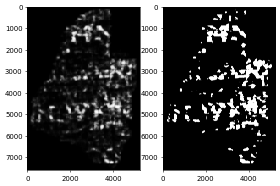

thr=0.250, precision=0.450, recall=0.594
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


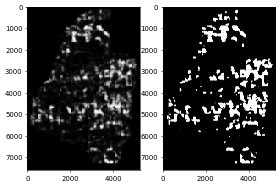

thr=0.250, precision=0.430, recall=0.614
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


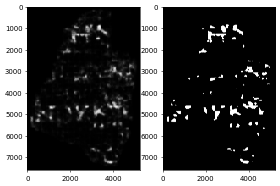

thr=0.250, precision=0.697, recall=0.332
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


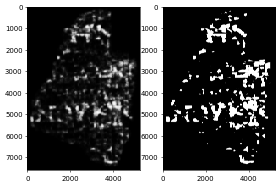

thr=0.250, precision=0.442, recall=0.579
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


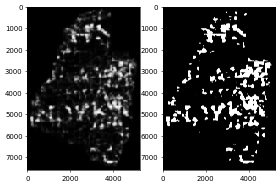

thr=0.250, precision=0.438, recall=0.598
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


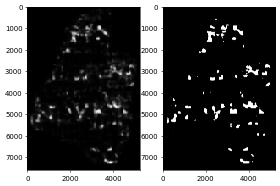

thr=0.250, precision=0.706, recall=0.333
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


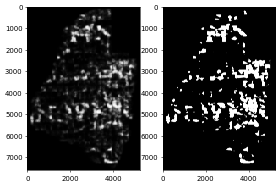

thr=0.250, precision=0.442, recall=0.585
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


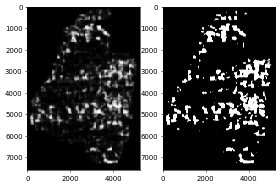

thr=0.250, precision=0.433, recall=0.606


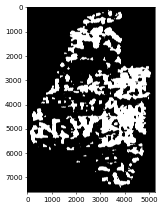

thr=0.250, fbate=0.459, precision=0.291, recall=0.820
--------- thrshold = 0.30000000000000004 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


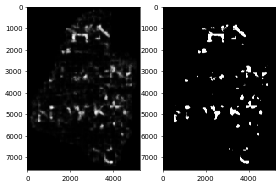

thr=0.300, precision=0.759, recall=0.309
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


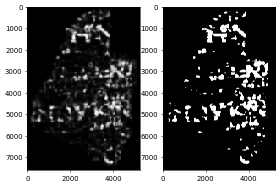

thr=0.300, precision=0.479, recall=0.553
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


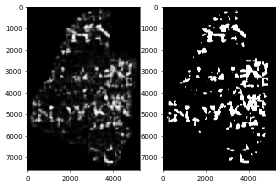

thr=0.300, precision=0.466, recall=0.576
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


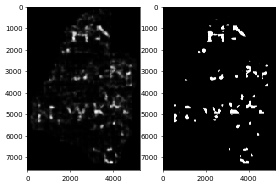

thr=0.300, precision=0.771, recall=0.306
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


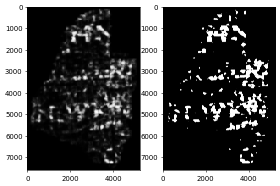

thr=0.300, precision=0.484, recall=0.549
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


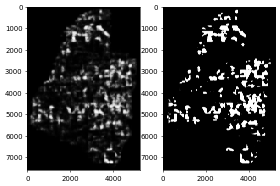

thr=0.300, precision=0.461, recall=0.578
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


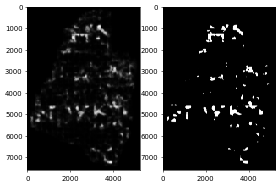

thr=0.300, precision=0.748, recall=0.297
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


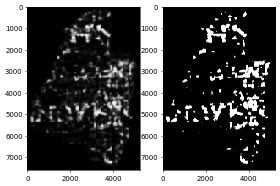

thr=0.300, precision=0.482, recall=0.555
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


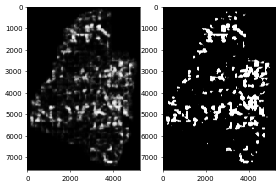

thr=0.300, precision=0.466, recall=0.575
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


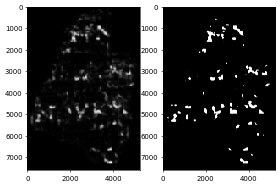

thr=0.300, precision=0.757, recall=0.292
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


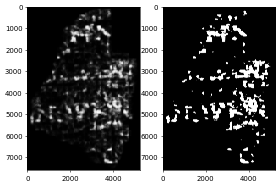

thr=0.300, precision=0.477, recall=0.551
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


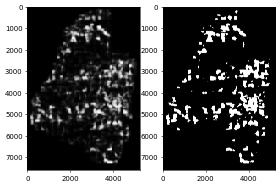

thr=0.300, precision=0.458, recall=0.572
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


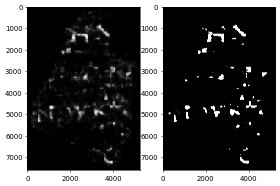

thr=0.300, precision=0.758, recall=0.275
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


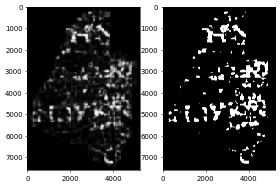

thr=0.300, precision=0.492, recall=0.540
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


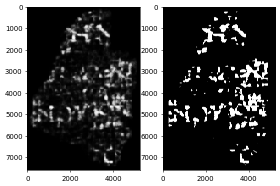

thr=0.300, precision=0.479, recall=0.566
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


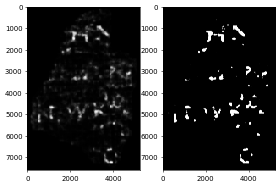

thr=0.300, precision=0.780, recall=0.282
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


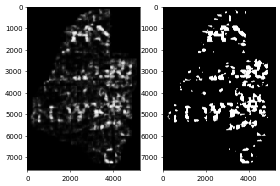

thr=0.300, precision=0.493, recall=0.539
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


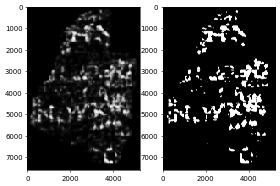

thr=0.300, precision=0.478, recall=0.571
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


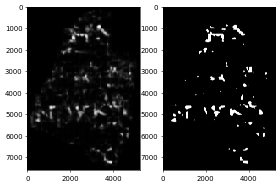

thr=0.300, precision=0.736, recall=0.272
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


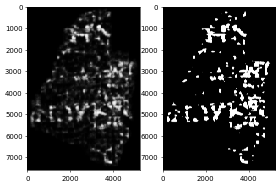

thr=0.300, precision=0.487, recall=0.536
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


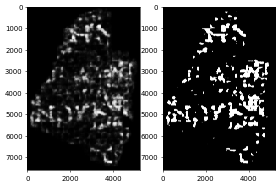

thr=0.300, precision=0.474, recall=0.565
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


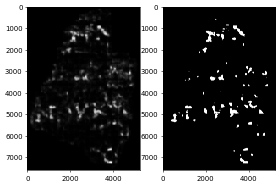

thr=0.300, precision=0.757, recall=0.275
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


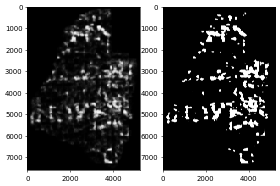

thr=0.300, precision=0.481, recall=0.530
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


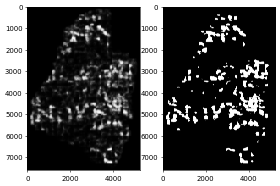

thr=0.300, precision=0.472, recall=0.563
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


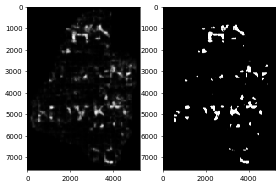

thr=0.300, precision=0.760, recall=0.292
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


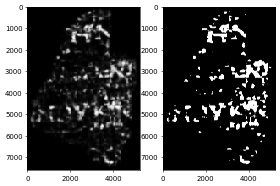

thr=0.300, precision=0.488, recall=0.539
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


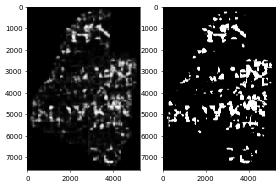

thr=0.300, precision=0.473, recall=0.563
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


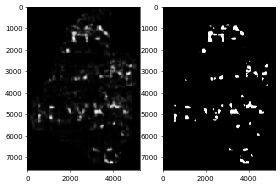

thr=0.300, precision=0.779, recall=0.278
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


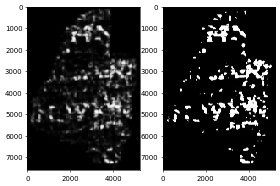

thr=0.300, precision=0.491, recall=0.545
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


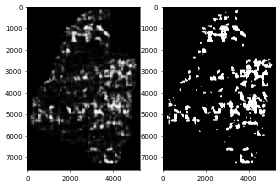

thr=0.300, precision=0.470, recall=0.570
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


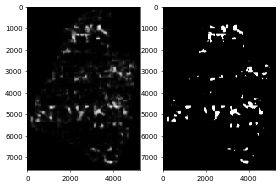

thr=0.300, precision=0.740, recall=0.287
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


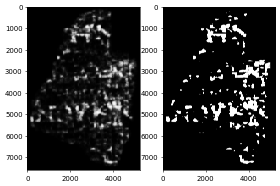

thr=0.300, precision=0.484, recall=0.537
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


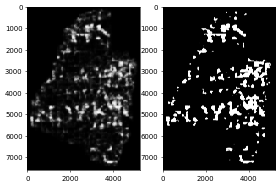

thr=0.300, precision=0.476, recall=0.557
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


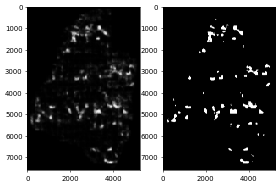

thr=0.300, precision=0.754, recall=0.288
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


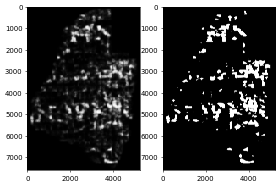

thr=0.300, precision=0.481, recall=0.537
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


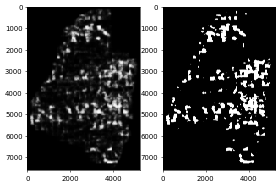

thr=0.300, precision=0.471, recall=0.560


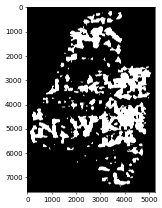

thr=0.300, fbate=0.487, precision=0.322, recall=0.788
--------- thrshold = 0.3500000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


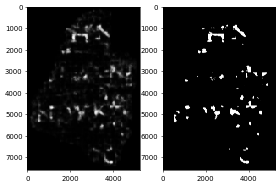

thr=0.350, precision=0.795, recall=0.268
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


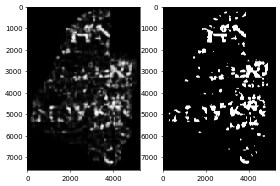

thr=0.350, precision=0.519, recall=0.512
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


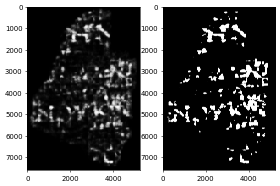

thr=0.350, precision=0.498, recall=0.532
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


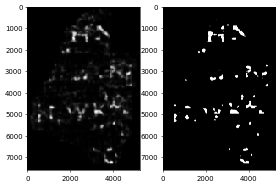

thr=0.350, precision=0.803, recall=0.265
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


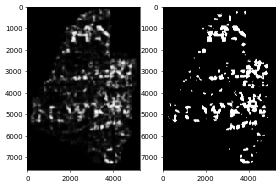

thr=0.350, precision=0.523, recall=0.506
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


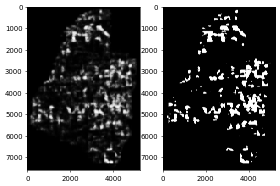

thr=0.350, precision=0.498, recall=0.532
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


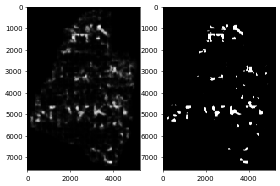

thr=0.350, precision=0.791, recall=0.255
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


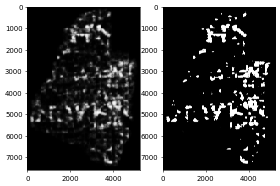

thr=0.350, precision=0.517, recall=0.512
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


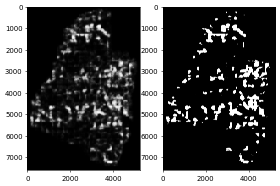

thr=0.350, precision=0.500, recall=0.529
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


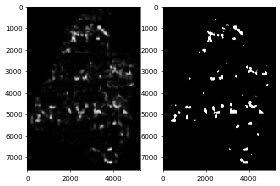

thr=0.350, precision=0.806, recall=0.254
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


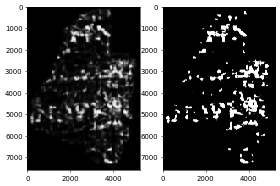

thr=0.350, precision=0.511, recall=0.503
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


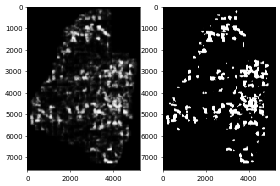

thr=0.350, precision=0.488, recall=0.524
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


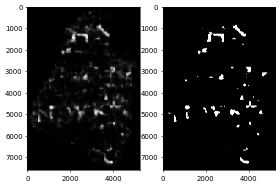

thr=0.350, precision=0.792, recall=0.241
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


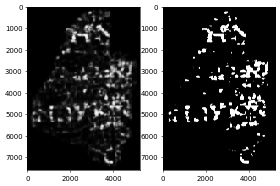

thr=0.350, precision=0.531, recall=0.497
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


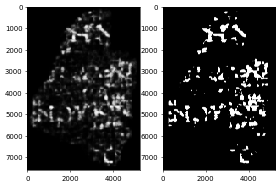

thr=0.350, precision=0.512, recall=0.519
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


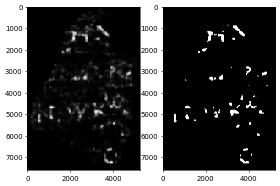

thr=0.350, precision=0.815, recall=0.242
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


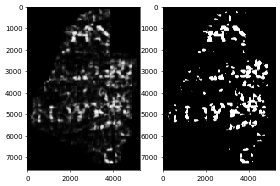

thr=0.350, precision=0.531, recall=0.494
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


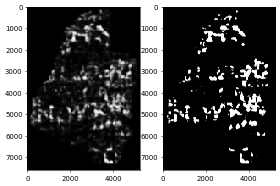

thr=0.350, precision=0.514, recall=0.521
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


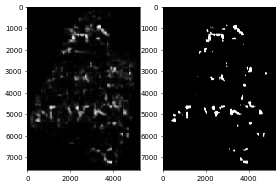

thr=0.350, precision=0.776, recall=0.231
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


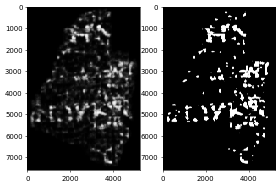

thr=0.350, precision=0.522, recall=0.494
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


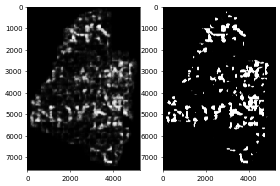

thr=0.350, precision=0.508, recall=0.515
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


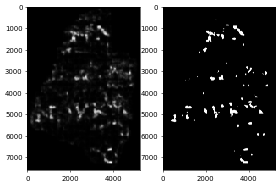

thr=0.350, precision=0.797, recall=0.232
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


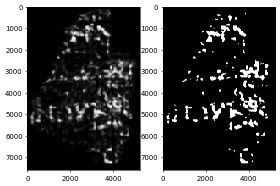

thr=0.350, precision=0.517, recall=0.485
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


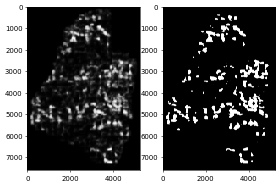

thr=0.350, precision=0.506, recall=0.519
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


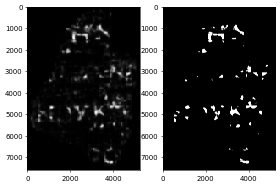

thr=0.350, precision=0.795, recall=0.250
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


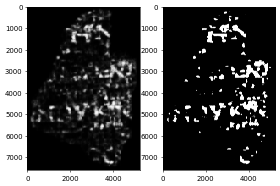

thr=0.350, precision=0.523, recall=0.499
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


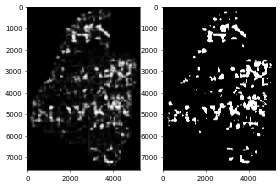

thr=0.350, precision=0.509, recall=0.517
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


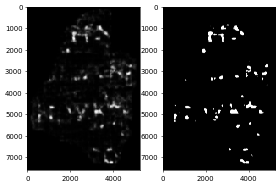

thr=0.350, precision=0.811, recall=0.241
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


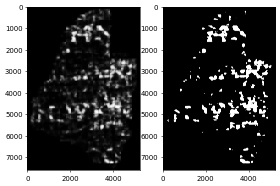

thr=0.350, precision=0.530, recall=0.501
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


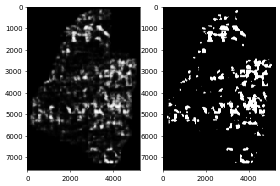

thr=0.350, precision=0.507, recall=0.523
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


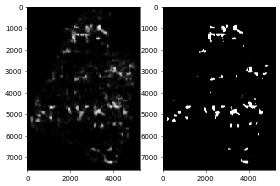

thr=0.350, precision=0.775, recall=0.244
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


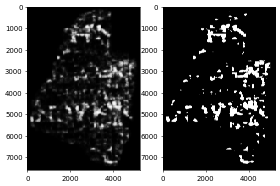

thr=0.350, precision=0.523, recall=0.497
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


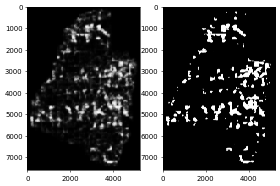

thr=0.350, precision=0.512, recall=0.517
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


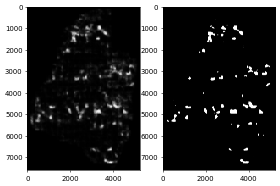

thr=0.350, precision=0.799, recall=0.249
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


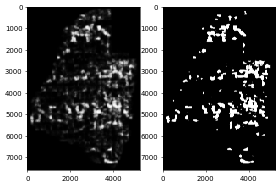

thr=0.350, precision=0.519, recall=0.495
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


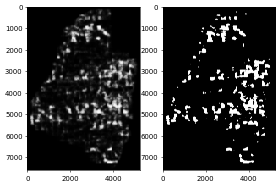

thr=0.350, precision=0.506, recall=0.514


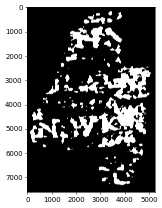

thr=0.350, fbate=0.508, precision=0.353, recall=0.754
--------- thrshold = 0.40000000000000013 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


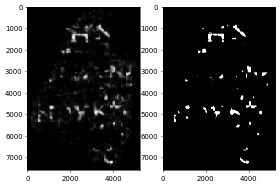

thr=0.400, precision=0.822, recall=0.232
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


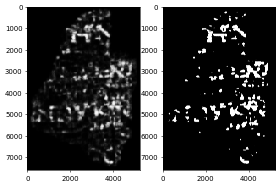

thr=0.400, precision=0.557, recall=0.470
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


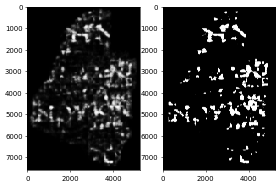

thr=0.400, precision=0.529, recall=0.487
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


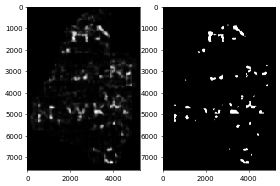

thr=0.400, precision=0.835, recall=0.230
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


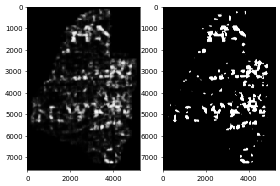

thr=0.400, precision=0.559, recall=0.465
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


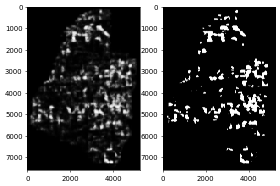

thr=0.400, precision=0.531, recall=0.486
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


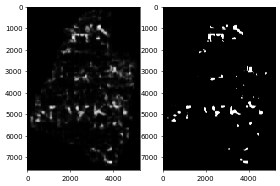

thr=0.400, precision=0.826, recall=0.218
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


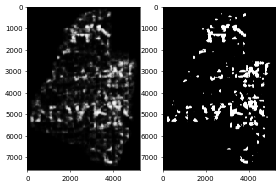

thr=0.400, precision=0.548, recall=0.469
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


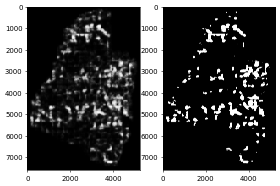

thr=0.400, precision=0.535, recall=0.486
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


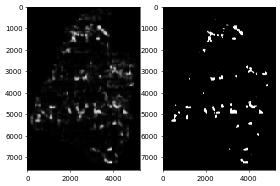

thr=0.400, precision=0.846, recall=0.220
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


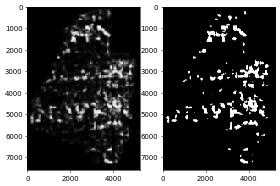

thr=0.400, precision=0.543, recall=0.455
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


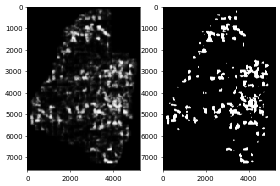

thr=0.400, precision=0.519, recall=0.480
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


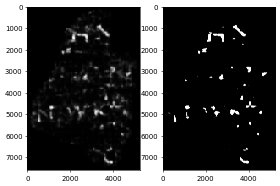

thr=0.400, precision=0.819, recall=0.209
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


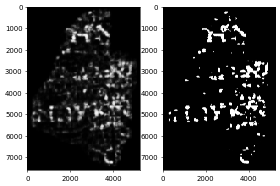

thr=0.400, precision=0.569, recall=0.456
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


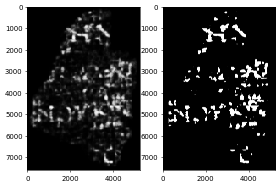

thr=0.400, precision=0.543, recall=0.475
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


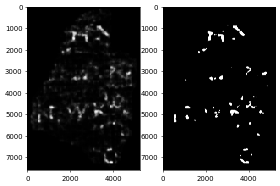

thr=0.400, precision=0.849, recall=0.209
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


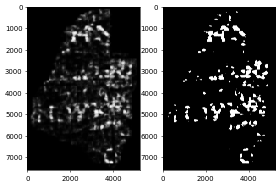

thr=0.400, precision=0.569, recall=0.449
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


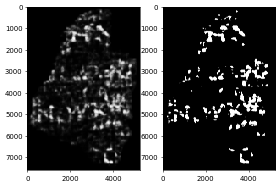

thr=0.400, precision=0.549, recall=0.471
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


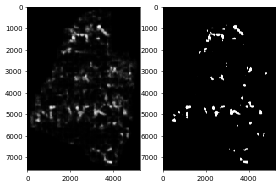

thr=0.400, precision=0.816, recall=0.195
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


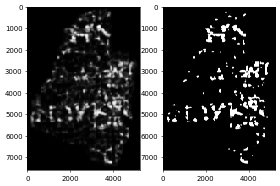

thr=0.400, precision=0.554, recall=0.452
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


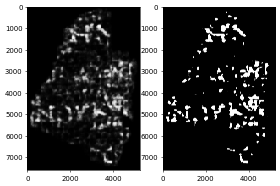

thr=0.400, precision=0.542, recall=0.468
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


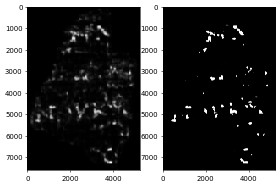

thr=0.400, precision=0.839, recall=0.194
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


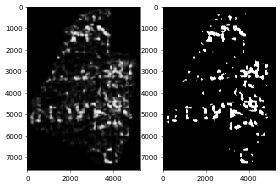

thr=0.400, precision=0.552, recall=0.443
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


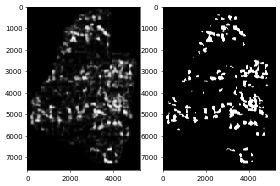

thr=0.400, precision=0.537, recall=0.473
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


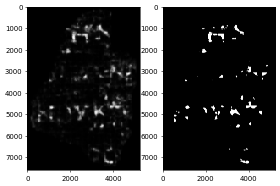

thr=0.400, precision=0.827, recall=0.211
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


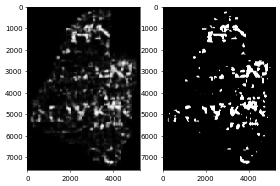

thr=0.400, precision=0.557, recall=0.458
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


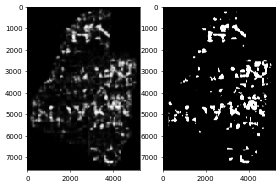

thr=0.400, precision=0.542, recall=0.473
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


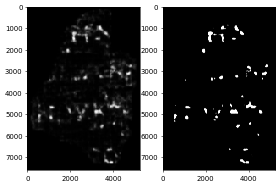

thr=0.400, precision=0.840, recall=0.206
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


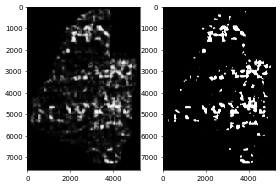

thr=0.400, precision=0.568, recall=0.459
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


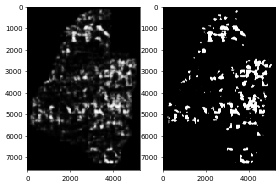

thr=0.400, precision=0.541, recall=0.473
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


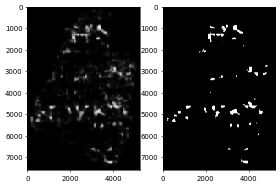

thr=0.400, precision=0.808, recall=0.207
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


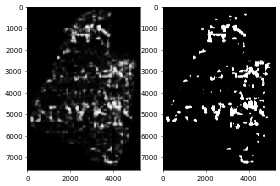

thr=0.400, precision=0.561, recall=0.456
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


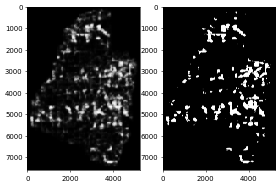

thr=0.400, precision=0.548, recall=0.473
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


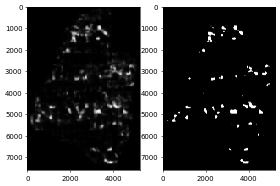

thr=0.400, precision=0.835, recall=0.210
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


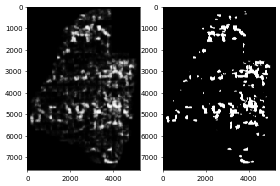

thr=0.400, precision=0.556, recall=0.454
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


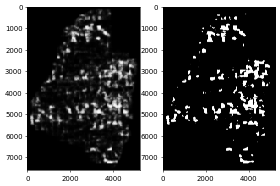

thr=0.400, precision=0.541, recall=0.469


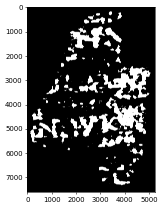

thr=0.400, fbate=0.525, precision=0.385, recall=0.718
--------- thrshold = 0.45000000000000007 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


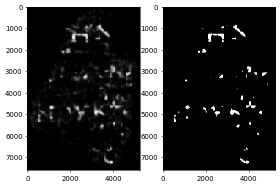

thr=0.450, precision=0.844, recall=0.203
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


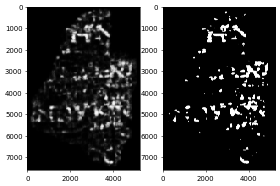

thr=0.450, precision=0.590, recall=0.430
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


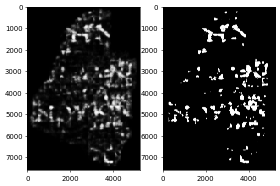

thr=0.450, precision=0.556, recall=0.445
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


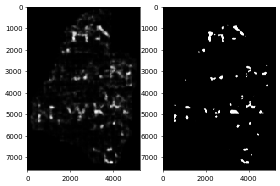

thr=0.450, precision=0.867, recall=0.199
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


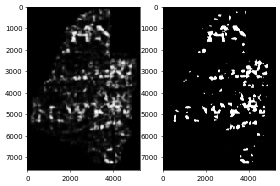

thr=0.450, precision=0.594, recall=0.426
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


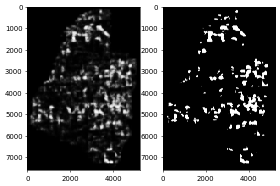

thr=0.450, precision=0.561, recall=0.444
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


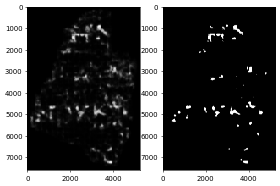

thr=0.450, precision=0.853, recall=0.185
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


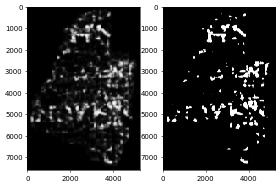

thr=0.450, precision=0.577, recall=0.429
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


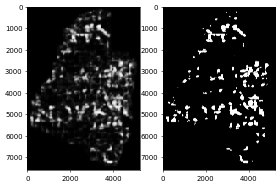

thr=0.450, precision=0.565, recall=0.448
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


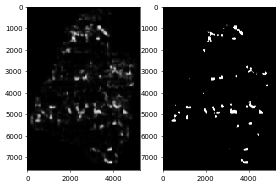

thr=0.450, precision=0.873, recall=0.189
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


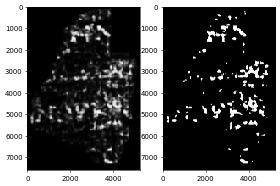

thr=0.450, precision=0.575, recall=0.415
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


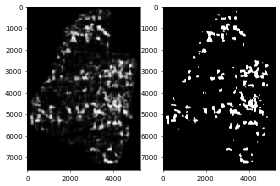

thr=0.450, precision=0.548, recall=0.440
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


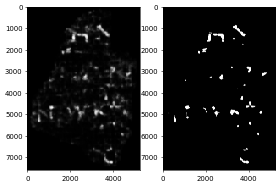

thr=0.450, precision=0.838, recall=0.181
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


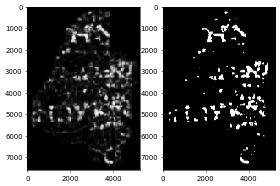

thr=0.450, precision=0.604, recall=0.417
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


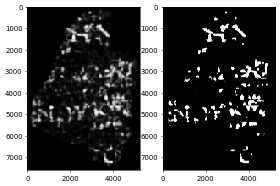

thr=0.450, precision=0.569, recall=0.435
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


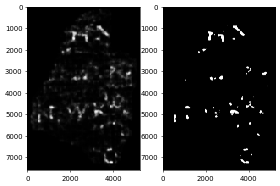

thr=0.450, precision=0.876, recall=0.180
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


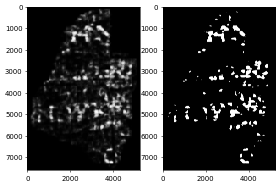

thr=0.450, precision=0.605, recall=0.409
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


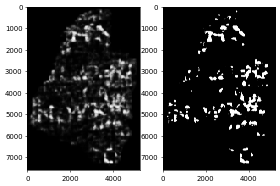

thr=0.450, precision=0.580, recall=0.425
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


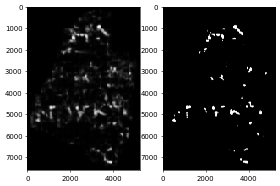

thr=0.450, precision=0.851, recall=0.163
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


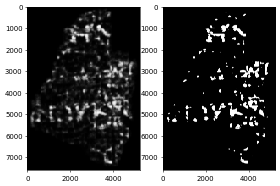

thr=0.450, precision=0.584, recall=0.411
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


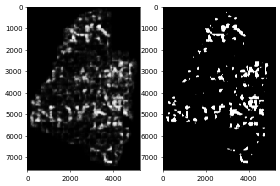

thr=0.450, precision=0.571, recall=0.425
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


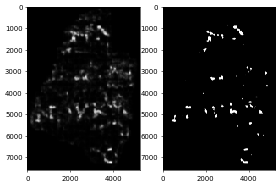

thr=0.450, precision=0.873, recall=0.163
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


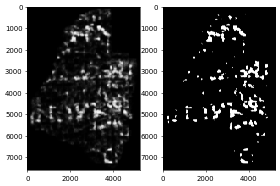

thr=0.450, precision=0.582, recall=0.403
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


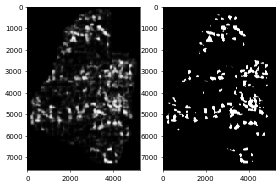

thr=0.450, precision=0.566, recall=0.428
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


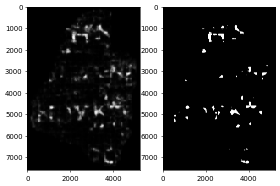

thr=0.450, precision=0.849, recall=0.178
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


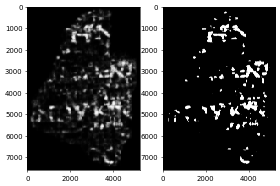

thr=0.450, precision=0.588, recall=0.418
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


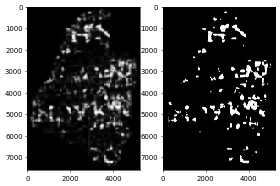

thr=0.450, precision=0.573, recall=0.433
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


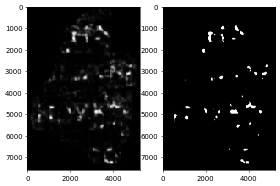

thr=0.450, precision=0.862, recall=0.176
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


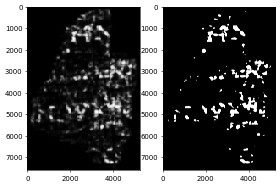

thr=0.450, precision=0.604, recall=0.420
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


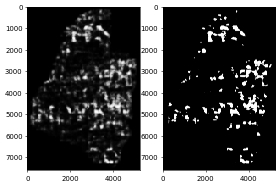

thr=0.450, precision=0.572, recall=0.426
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


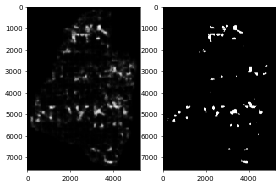

thr=0.450, precision=0.841, recall=0.176
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


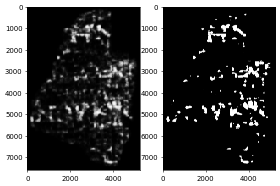

thr=0.450, precision=0.591, recall=0.416
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


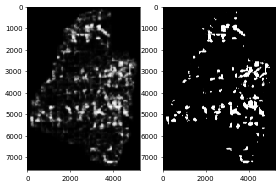

thr=0.450, precision=0.580, recall=0.431
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


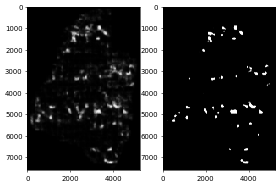

thr=0.450, precision=0.866, recall=0.178
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


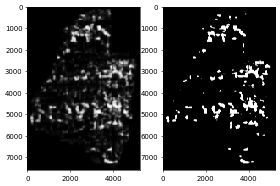

thr=0.450, precision=0.588, recall=0.416
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


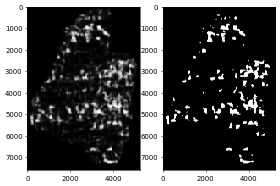

thr=0.450, precision=0.573, recall=0.430


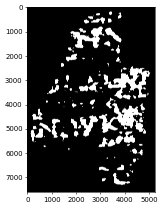

thr=0.450, fbate=0.537, precision=0.417, recall=0.686
--------- thrshold = 0.5000000000000001 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


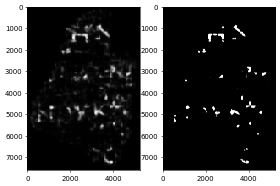

thr=0.500, precision=0.866, recall=0.172
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


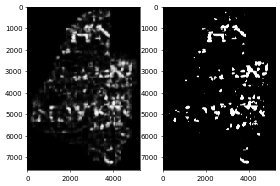

thr=0.500, precision=0.628, recall=0.386
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


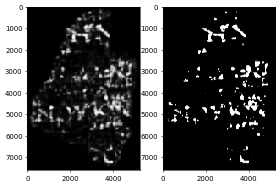

thr=0.500, precision=0.587, recall=0.399
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


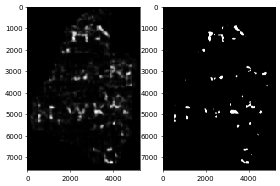

thr=0.500, precision=0.905, recall=0.169
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


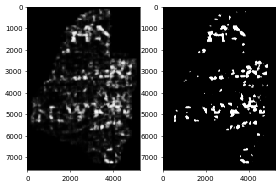

thr=0.500, precision=0.633, recall=0.383
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


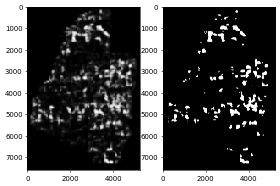

thr=0.500, precision=0.596, recall=0.395
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


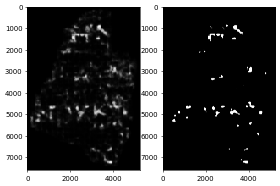

thr=0.500, precision=0.880, recall=0.153
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


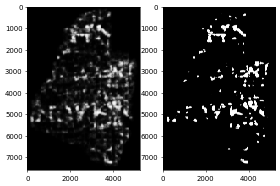

thr=0.500, precision=0.609, recall=0.384
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


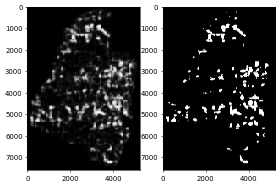

thr=0.500, precision=0.595, recall=0.405
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


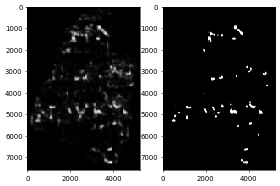

thr=0.500, precision=0.901, recall=0.159
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


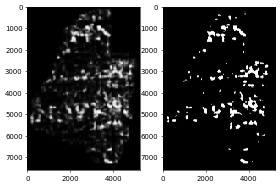

thr=0.500, precision=0.611, recall=0.375
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


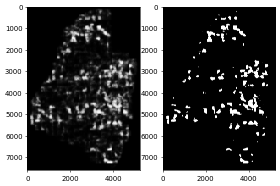

thr=0.500, precision=0.583, recall=0.399
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


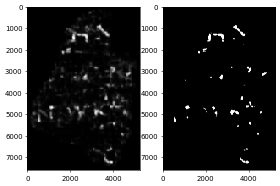

thr=0.500, precision=0.859, recall=0.151
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


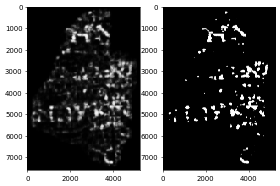

thr=0.500, precision=0.643, recall=0.372
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


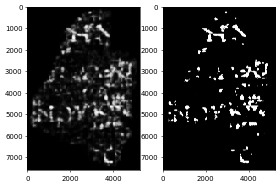

thr=0.500, precision=0.600, recall=0.390
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


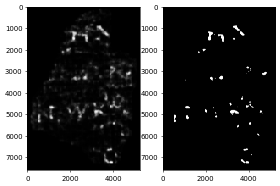

thr=0.500, precision=0.907, recall=0.152
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


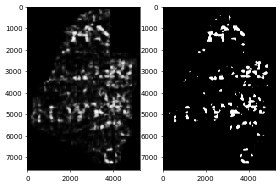

thr=0.500, precision=0.640, recall=0.365
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


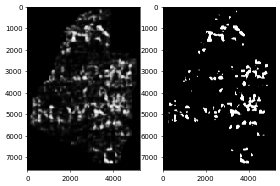

thr=0.500, precision=0.612, recall=0.379
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


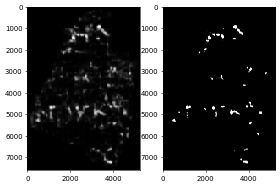

thr=0.500, precision=0.882, recall=0.130
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


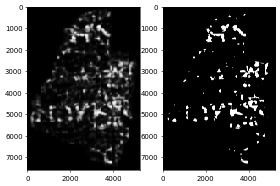

thr=0.500, precision=0.618, recall=0.363
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


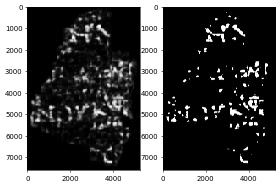

thr=0.500, precision=0.600, recall=0.380
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


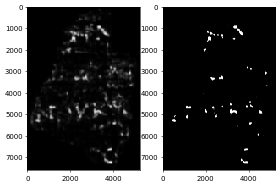

thr=0.500, precision=0.900, recall=0.134
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


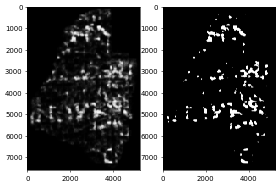

thr=0.500, precision=0.617, recall=0.361
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


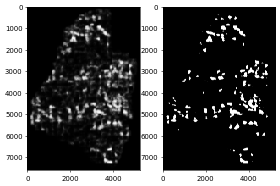

thr=0.500, precision=0.603, recall=0.380
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


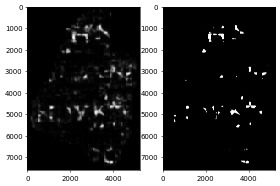

thr=0.500, precision=0.872, recall=0.149
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


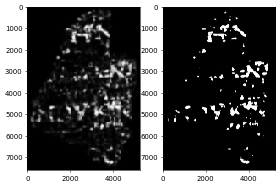

thr=0.500, precision=0.628, recall=0.374
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


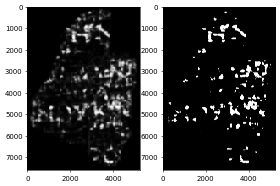

thr=0.500, precision=0.608, recall=0.388
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


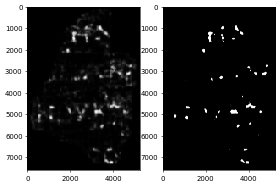

thr=0.500, precision=0.883, recall=0.149
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


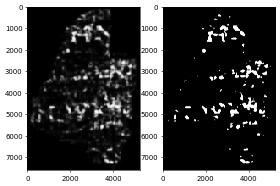

thr=0.500, precision=0.646, recall=0.377
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


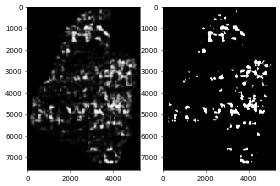

thr=0.500, precision=0.613, recall=0.375
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


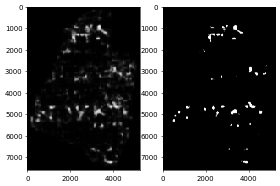

thr=0.500, precision=0.882, recall=0.144
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


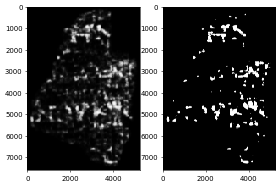

thr=0.500, precision=0.622, recall=0.371
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


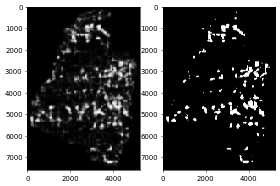

thr=0.500, precision=0.613, recall=0.385
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


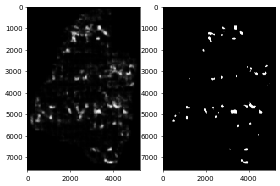

thr=0.500, precision=0.896, recall=0.148
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


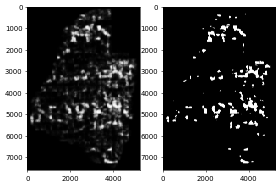

thr=0.500, precision=0.622, recall=0.373
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


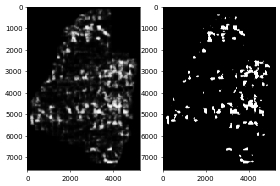

thr=0.500, precision=0.611, recall=0.384


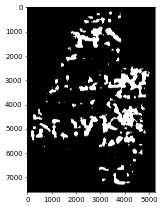

thr=0.500, fbate=0.546, precision=0.457, recall=0.649
--------- thrshold = 0.5500000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


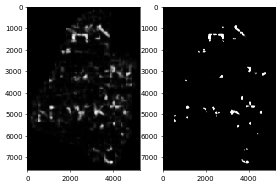

thr=0.550, precision=0.887, recall=0.142
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


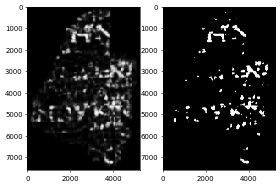

thr=0.550, precision=0.669, recall=0.343
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


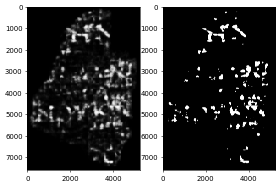

thr=0.550, precision=0.624, recall=0.353
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


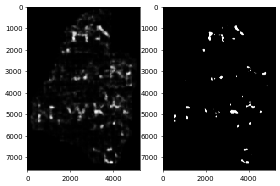

thr=0.550, precision=0.936, recall=0.137
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


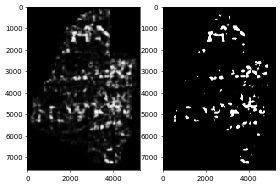

thr=0.550, precision=0.672, recall=0.342
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


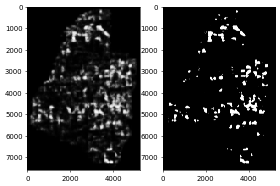

thr=0.550, precision=0.632, recall=0.348
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


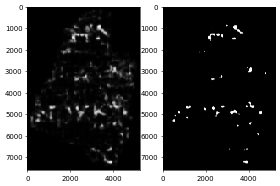

thr=0.550, precision=0.906, recall=0.124
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


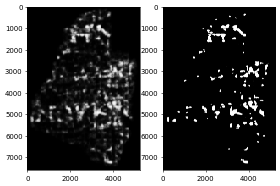

thr=0.550, precision=0.641, recall=0.337
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


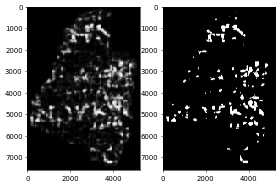

thr=0.550, precision=0.625, recall=0.359
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


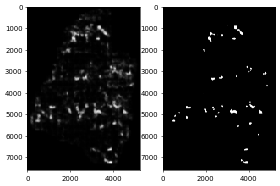

thr=0.550, precision=0.927, recall=0.128
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


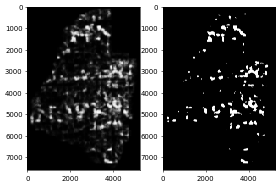

thr=0.550, precision=0.650, recall=0.336
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


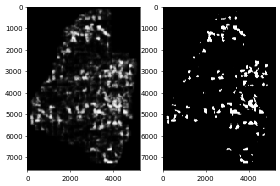

thr=0.550, precision=0.622, recall=0.356
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


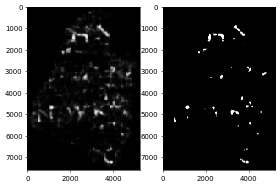

thr=0.550, precision=0.880, recall=0.122
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


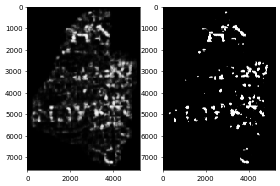

thr=0.550, precision=0.681, recall=0.326
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


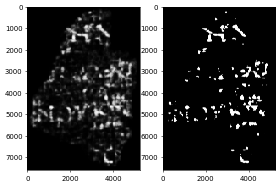

thr=0.550, precision=0.633, recall=0.343
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


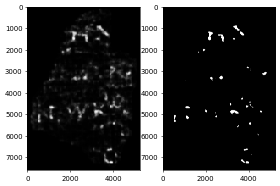

thr=0.550, precision=0.939, recall=0.125
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


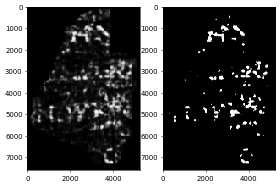

thr=0.550, precision=0.676, recall=0.325
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


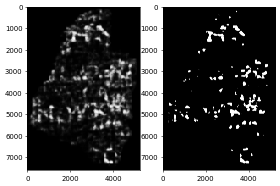

thr=0.550, precision=0.644, recall=0.333
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


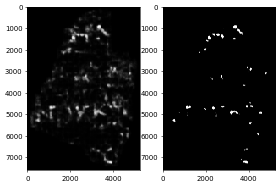

thr=0.550, precision=0.906, recall=0.100
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


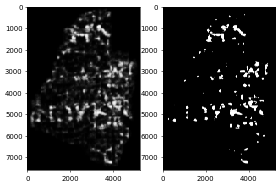

thr=0.550, precision=0.651, recall=0.316
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


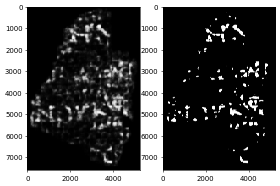

thr=0.550, precision=0.630, recall=0.335
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


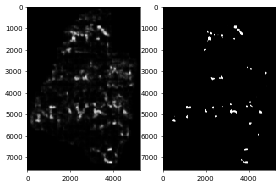

thr=0.550, precision=0.920, recall=0.107
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


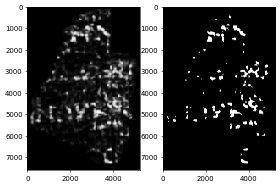

thr=0.550, precision=0.655, recall=0.319
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


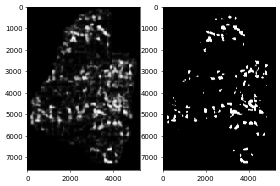

thr=0.550, precision=0.643, recall=0.332
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


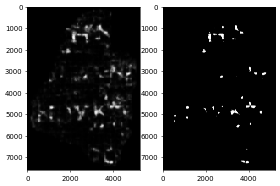

thr=0.550, precision=0.895, recall=0.122
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


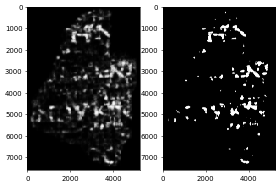

thr=0.550, precision=0.669, recall=0.330
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


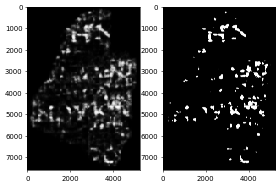

thr=0.550, precision=0.644, recall=0.342
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


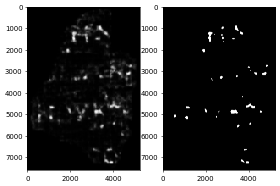

thr=0.550, precision=0.900, recall=0.124
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


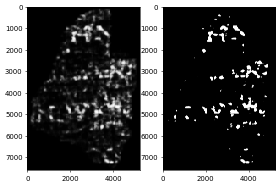

thr=0.550, precision=0.692, recall=0.335
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


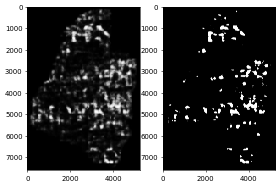

thr=0.550, precision=0.660, recall=0.330
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


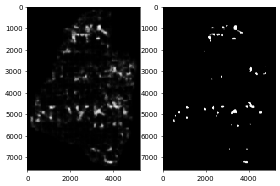

thr=0.550, precision=0.917, recall=0.112
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


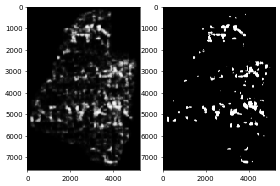

thr=0.550, precision=0.652, recall=0.326
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


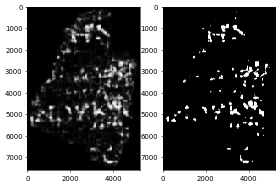

thr=0.550, precision=0.645, recall=0.339
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


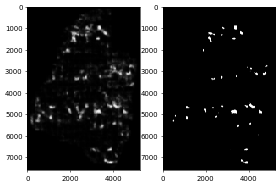

thr=0.550, precision=0.920, recall=0.119
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


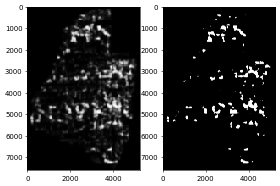

thr=0.550, precision=0.658, recall=0.330
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


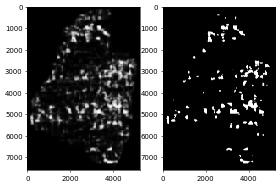

thr=0.550, precision=0.647, recall=0.338


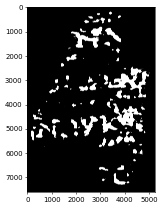

thr=0.550, fbate=0.547, precision=0.498, recall=0.605
fold =  1


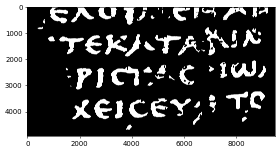

--------- thrshold = 0.1 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


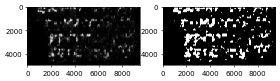

thr=0.100, precision=0.549, recall=0.578
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


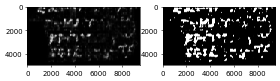

thr=0.100, precision=0.555, recall=0.558
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


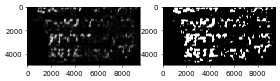

thr=0.100, precision=0.535, recall=0.581
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


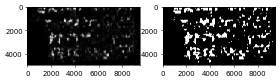

thr=0.100, precision=0.536, recall=0.497
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


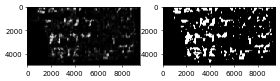

thr=0.100, precision=0.553, recall=0.498
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


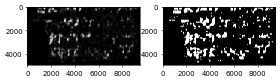

thr=0.100, precision=0.526, recall=0.506
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


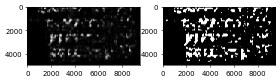

thr=0.100, precision=0.535, recall=0.558
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


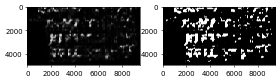

thr=0.100, precision=0.548, recall=0.551
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


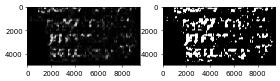

thr=0.100, precision=0.531, recall=0.575
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


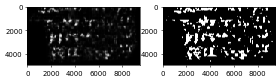

thr=0.100, precision=0.528, recall=0.501
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


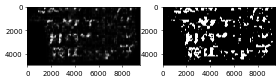

thr=0.100, precision=0.545, recall=0.482
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


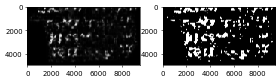

thr=0.100, precision=0.534, recall=0.494
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:default


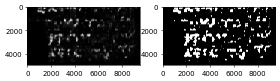

thr=0.100, precision=0.548, recall=0.540
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:hflip


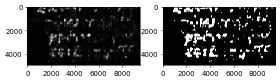

thr=0.100, precision=0.562, recall=0.537
surface_list: [27, 30, 33, 36], slide pos:[0, 0], tta:vflip


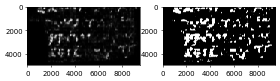

thr=0.100, precision=0.542, recall=0.555
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:default


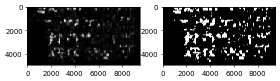

thr=0.100, precision=0.539, recall=0.474
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:hflip


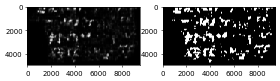

thr=0.100, precision=0.542, recall=0.479
surface_list: [27, 30, 33, 36], slide pos:[128, 0], tta:vflip


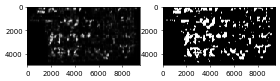

thr=0.100, precision=0.523, recall=0.497
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:default


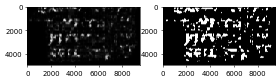

thr=0.100, precision=0.543, recall=0.543
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:hflip


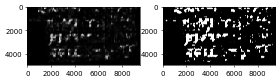

thr=0.100, precision=0.550, recall=0.529
surface_list: [27, 30, 33, 36], slide pos:[0, 128], tta:vflip


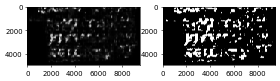

thr=0.100, precision=0.530, recall=0.548
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:default


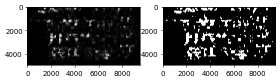

thr=0.100, precision=0.526, recall=0.482
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:hflip


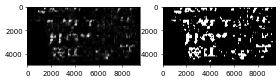

thr=0.100, precision=0.539, recall=0.465
surface_list: [27, 30, 33, 36], slide pos:[128, 128], tta:vflip


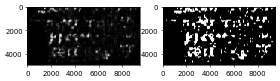

thr=0.100, precision=0.525, recall=0.495
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:default


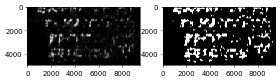

thr=0.100, precision=0.533, recall=0.591
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:hflip


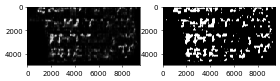

thr=0.100, precision=0.553, recall=0.576
surface_list: [25, 28, 31, 34], slide pos:[0, 0], tta:vflip


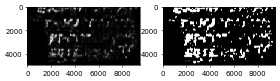

thr=0.100, precision=0.533, recall=0.600
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:default


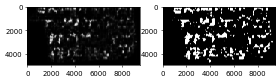

thr=0.100, precision=0.526, recall=0.513
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:hflip


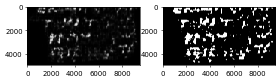

thr=0.100, precision=0.541, recall=0.500
surface_list: [25, 28, 31, 34], slide pos:[128, 0], tta:vflip


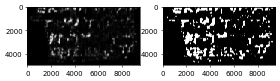

thr=0.100, precision=0.520, recall=0.523
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:default


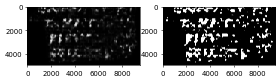

thr=0.100, precision=0.539, recall=0.570
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:hflip


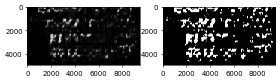

thr=0.100, precision=0.549, recall=0.554
surface_list: [25, 28, 31, 34], slide pos:[0, 128], tta:vflip


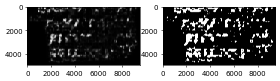

thr=0.100, precision=0.537, recall=0.583
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:default


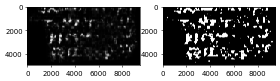

thr=0.100, precision=0.532, recall=0.505
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:hflip


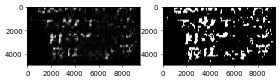

thr=0.100, precision=0.539, recall=0.480
surface_list: [25, 28, 31, 34], slide pos:[128, 128], tta:vflip


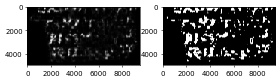

thr=0.100, precision=0.527, recall=0.509


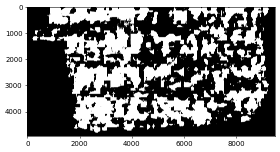

thr=0.100, fbate=0.524, precision=0.339, recall=0.857
--------- thrshold = 0.15000000000000002 -------------
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:default


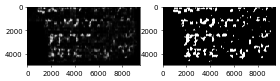

thr=0.150, precision=0.635, recall=0.486
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:hflip


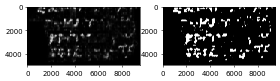

thr=0.150, precision=0.637, recall=0.475
surface_list: [26, 29, 32, 35], slide pos:[0, 0], tta:vflip


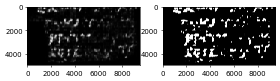

thr=0.150, precision=0.615, recall=0.498
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:default


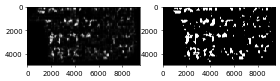

thr=0.150, precision=0.612, recall=0.411
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:hflip


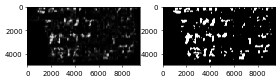

thr=0.150, precision=0.629, recall=0.414
surface_list: [26, 29, 32, 35], slide pos:[128, 0], tta:vflip


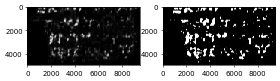

thr=0.150, precision=0.600, recall=0.419
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:default


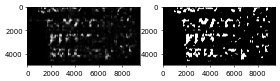

thr=0.150, precision=0.626, recall=0.468
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:hflip


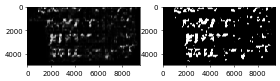

thr=0.150, precision=0.636, recall=0.465
surface_list: [26, 29, 32, 35], slide pos:[0, 128], tta:vflip


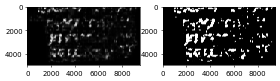

thr=0.150, precision=0.617, recall=0.485
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:default


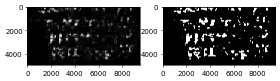

thr=0.150, precision=0.610, recall=0.410
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:hflip


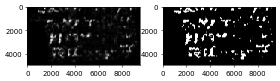

thr=0.150, precision=0.628, recall=0.397
surface_list: [26, 29, 32, 35], slide pos:[128, 128], tta:vflip


KeyboardInterrupt: 

In [44]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score

mode = "slide_tta"
tta_list = ["default", "hflip", "vflip"]
# tta_list = ["default"]
for fold in CFG["folds"]:
    print("=================")
    print("fold = ", fold)
    valid_dirs = CFG["VALID_DIR_LIST"][fold]
    mask_path = os.path.join(CFG["INPUT_DIR"], "train", valid_dirs[0], "inklabels.png")
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    plt.figure(dpi=50)
    plt.imshow(mask, cmap="gray")
    plt.show()
    mask_binary = (mask > 0).astype(np.uint8)
    for threshold in np.arange(0.10, 0.6, 0.05):
        print(f"--------- thrshold = {threshold} -------------")
        pred_add = np.zeros_like(mask)
        for slice_idx, surface_list in enumerate(CFG["SURFACE_LIST"]):
            for slide_idx, slide_pos in enumerate(CFG["slide_pos_list"]):
                for tta in tta_list:
                    print(f"surface_list: {surface_list}, slide pos:{slide_pos}, tta:{tta}")
                    pred_path = os.path.join(CFG["OUTPUT_DIR"], "imgs_each", f"fold{fold}_{mode}_slice{slice_idx}_slide{slide_idx}_{tta}_valid_pred_img.png")
                    # print(pred_path)
                    pred_img = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)/255.
                    pred_binary = (pred_img >= threshold).astype(np.uint8)
                    pred_add += pred_binary
                    plt.figure(dpi=50)
                    plt.subplot(1,2,1)
                    plt.imshow(pred_img, cmap="gray")
                    plt.subplot(1,2,2)
                    plt.imshow(pred_binary, cmap="gray")
                    plt.show()
                    
                    # cm = confusion_matrix(mask_binary.flatten(), pred_binary.flatten())
                    precision  = precision_score(mask_binary.flatten(), pred_binary.flatten())
                    recall  = recall_score(mask_binary.flatten(), pred_binary.flatten())
                    # confusion flatten
                    # tn, fp, fn, tp = cm.ravel()
                    print(f"thr={threshold:.3f}, precision={precision:.3f}, recall={recall:.3f}")
                    # print(f"thr={threshold:.3f}, tn={tn}, fp={fp}, fn={fn}, tp={tp}, precision={precision:.3f}, recall={recall:.3f}")
        pred_add = (pred_add > 0).astype(np.uint8)
        precision  = precision_score(mask_binary.flatten(), pred_add.flatten())
        recall  = recall_score(mask_binary.flatten(), pred_add.flatten())
        fbata = fbeta_numpy(mask_binary.flatten(), pred_binary.flatten(), beta=0.5)
        plt.figure(dpi=50)
        plt.imshow(pred_add, cmap="gray")
        plt.show()
        print(f"thr={threshold:.3f}, fbate={fbata:.3f}, precision={precision:.3f}, recall={recall:.3f}")